In [1]:
# Enable autoreloading of modules
%load_ext autoreload
%autoreload 2

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Standard imports
import os
import sys
import random

# Data manipulation and analysis
import numpy as np
import pandas as pd

# Visualization libraries
import seaborn as sns
import matplotlib.pyplot as plt

# Machine learning tools and models
from sklearn.model_selection import (cross_val_score, StratifiedKFold, StratifiedGroupKFold,
                                     train_test_split, KFold, GroupShuffleSplit)
from sklearn.metrics import (roc_auc_score, confusion_matrix, classification_report,
                             f1_score, )
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
import xgboost as xgb
from sklearn.preprocessing import OneHotEncoder

# SHAP for model interpretation
import shap

# Custom utilities
sys.path.append('../')
from src.utils import load_config, split_into_sentences, flatten_list, load_and_clean_data
from src import stats_analysis as sa
from src.data_cleaning import add_average_data

#proportion score matching
from psmpy import PsmPy
from psmpy.functions import cohenD
from psmpy.plotting import *


# set sample 
from imblearn.under_sampling import RandomUnderSampler

[nltk_data] Downloading package punkt to /home/robin/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


KeyboardInterrupt: 

## Reproduce Result concerning the ML in paper
  First we load data
  then we clean it

In [3]:
config = load_config('../config.yaml')
data = load_and_clean_data(config)
data = add_average_data(data)
print(data.temperature_enc.value_counts())
print(data.has_paraphrase.value_counts())


Data contains at the begining : 22953
Filtering data with more than 20 sentences and less than 5 sentences. 20947 samples left
Filtering data with phone numbers. 20908 samples left
Filtering data with addresses. 20540 samples left
Filtering data with mail addresses. 20540 samples left
Filtering data with list. 20022 samples left
Filtering data with short paraphrase. 19048 samples left
Filtering data with paraphrase at the end. 18848 samples left
temperature_enc
medium_temperature    6673
low_temperature       6543
high_temperature      5632
Name: count, dtype: int64
has_paraphrase
0    10184
1     8664
Name: count, dtype: int64


### Problem Description

Using LLM we genrated story of 200 words with different set of temperature and presence or absence of parraphrase. Our goal is to investigate two distinguish phenomenon in FTD: semantic repetition (parpahrase) and deceptiveness (temperature). 
We wan to evaluate the ability of our features to predict the two for a same text.
To this purposes we have merge the two features in a single feature and we will use a classifier to predict the two features. It is a 6 class classification problem

In [4]:
cosine_mean_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)_(all|consecutive)_(cosine)(.*)(mean)').columns.tolist()
cosine_mean_sim_metrics

['w2v_consecutive_cosine_sentences_similarity_mean',
 'w2v_all_cosine_sentences_similarity_mean',
 'fast_text_consecutive_cosine_sentences_similarity_mean',
 'fast_text_all_cosine_sentences_similarity_mean',
 'glove_consecutive_cosine_sentences_similarity_mean',
 'glove_all_cosine_sentences_similarity_mean',
 'sentence_sim_consecutive_cosine_sentences_similarity_mean',
 'sentence_sim_all_cosine_sentences_similarity_mean']

In [6]:
# definition of fetaures
density_features = data.filter(regex = "score").columns.tolist()
cosine_mean_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)_(all|consecutive)_(cosine)(.*)(mean)').columns.tolist()
cosine_std_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)_(all|consecutive)_(cosine)(.*)(std)').columns.tolist()
wmd_mean_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)_(all|consecutive)_(wmd)(.*)(mean)').columns.tolist()
wmd_std_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)_(all|consecutive)_(wmd)(.*)(std)').columns.tolist()
std_sim_metrics = data.filter(regex = '(sentence_sim|w2v|glove|fast_text)(.*)(std)').columns.tolist()
mean_sim_metrics = cosine_mean_sim_metrics + wmd_mean_sim_metrics
std_sim_metrics = cosine_std_sim_metrics + wmd_std_sim_metrics
sim_features = mean_sim_metrics + std_sim_metrics

all_features = density_features + sim_features

#
best_features = ["narrative_speed_score","cluster_density_score_MeanShift","cluster_reverse_silhouette_score_HDBSCAN","reduction_score_PCA_prop_of_components","cluster_reverse_silhouette_score_MeanShift"] + [
    "fast_text_all_wmd_sentences_similarity_mean","glove_all_wmd_sentences_similarity_mean","fast_text_all_wmd_sentences_similarity_mean","fast_text_all_cosine_sentences_similarity_mean","glove_consecutive_wmd_sentences_similarity_mean"] +[
    "w2v_all_wmd_sentences_similarity_std","fast_text_all_wmd_sentences_similarity_std","sentence_sim_all_cosine_sentences_similarity_std","w2v_consecutive_wmd_sentences_similarity_std","fast_text_consecutive_wmd_sentences_similarity_std"
]

average_features = ["all_cosine_sentences_similarity_mean", "all_cosine_sentences_similarity_std", "consecutive_cosine_sentences_similarity_mean", "consecutive_cosine_sentences_similarity_std", "all_wmd_sentences_similarity_mean", "all_wmd_sentences_similarity_std"]

Structural_density = [
                        'cluster_density_score_HDBSCAN', 
                        'cluster_reverse_silhouette_score_HDBSCAN',
                        'cluster_density_score_MeanShift', 
                        'cluster_reverse_silhouette_score_MeanShift',
                        'reduction_score_PCA_explained_variance', 
                        'reduction_score_PCA_prop_of_components',]

Semantic_contribution = ['regression_coef_density_score_Lasso',
    'regression_error_score_Lasso',
    'reduction_score_Lasso',
    ]


density_features = [
    #'cluster_density_score_HDBSCAN',
    #'cluster_reverse_silhouette_score_HDBSCAN',
    'cluster_density_score_MeanShift',
    'cluster_reverse_silhouette_score_MeanShift',
    'reduction_score_PCA_explained_variance',
    'reduction_score_PCA_prop_of_components',
    'regression_coef_density_score_Lasso',
    'regression_error_score_Lasso',
    'narrative_speed_score',
]


narrative_progression_features = [
    'narrative_speed_score'
]

# Global Topic Structure
global_topic_structure_features = [
    'cluster_density_score_MeanShift',
    'cluster_reverse_silhouette_score_MeanShift'
]

# Local Topic Structure
local_topic_structure_features = [
    'cluster_density_score_HDBSCAN',
    'cluster_reverse_silhouette_score_HDBSCAN'
]

# Semantic Complexity
semantic_complexity_features = [
    'reduction_score_PCA_explained_variance',
    'regression_error_score_Lasso'
]


# best parameter extracted from main_optimize_ml.py
best_parameters_dict = {
    "density_features": {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "mean_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_depth': 20, 'bootstrap': True},
    "cosine_mean_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_depth': 20, 'bootstrap': True},
    "cosine_std_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "wmd_mean_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "wmd_std_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "std_sim_metrics" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "sim_features" : {'n_estimators': 300, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None, 'bootstrap': False},
    "all_features" : {'n_estimators': 300, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_depth': 20, 'bootstrap': False} ,
    "best_features" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "semantic_contribution" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "structural_density" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "average_features" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "average_and_structural_density" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
    "narrative_speed" : {'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True},
}

features_dict = {
        #"sim_features": sim_features,
        "cosine_mean_sim_metrics": cosine_mean_sim_metrics,
        "cosine_std_sim_metrics": cosine_std_sim_metrics,
        "wmd_mean_sim_metrics": wmd_mean_sim_metrics,
        "wmd_std_sim_metrics": wmd_std_sim_metrics,
        "mean_sim_metrics": mean_sim_metrics,
        "density_features": density_features,
        "mean_sim_metrics": mean_sim_metrics,
        "std_sim_metrics": std_sim_metrics,
        "all_features": all_features,
        "best_features": best_features,
        "semantic_contribution" : Semantic_contribution,
        "structural_density" : Structural_density,
        "average_features": average_features,
        "average_and_structural_density": average_features + Structural_density,
        "narrative_speed": ["narrative_speed_score"],

    }


label_encoded_dict = {
    'low_temperature_with_paraphrase': 0,
    'low_temperature_with_no_paraphrase': 1,
    "medium_temperature_with_paraphrase": 2,
    "medium_temperature_with_no_paraphrase": 3,
    "high_temperature_with_paraphrase": 4,
    "high_temperature_with_no_paraphrase": 5
}

num_to_label = {v: k for k, v in label_encoded_dict.items()}


data['average_mean_sim'] = data[mean_sim_metrics].mean(axis=1)
data.combined_label.value_counts()


data['cat_label'] = data.combined_label.map(label_encoded_dict)#.apply(int)
data['cat_label'].value_counts()

cat_label
3    3641
1    3614
2    3032
5    2929
0    2929
4    2703
Name: count, dtype: int64

In [30]:
for key, elt in features_dict.items():
    print(f" {key} : {len(elt)}, {','.join(elt)}")

 cosine_mean_sim_metrics : 8, w2v_consecutive_cosine_sentences_similarity_mean,w2v_all_cosine_sentences_similarity_mean,fast_text_consecutive_cosine_sentences_similarity_mean,fast_text_all_cosine_sentences_similarity_mean,glove_consecutive_cosine_sentences_similarity_mean,glove_all_cosine_sentences_similarity_mean,sentence_sim_consecutive_cosine_sentences_similarity_mean,sentence_sim_all_cosine_sentences_similarity_mean
 cosine_std_sim_metrics : 8, w2v_consecutive_cosine_sentences_similarity_std,w2v_all_cosine_sentences_similarity_std,fast_text_consecutive_cosine_sentences_similarity_std,fast_text_all_cosine_sentences_similarity_std,glove_consecutive_cosine_sentences_similarity_std,glove_all_cosine_sentences_similarity_std,sentence_sim_consecutive_cosine_sentences_similarity_std,sentence_sim_all_cosine_sentences_similarity_std
 wmd_mean_sim_metrics : 6, w2v_all_wmd_sentences_similarity_mean,w2v_consecutive_wmd_sentences_similarity_mean,fast_text_all_wmd_sentences_similarity_mean,fast_t

In [6]:
#sns.violinplot(data = data, x = "fast_text_all_wmd_sentences_similarity_mean", y = "combined_label")
#sns.violinplot(data = data, x = "narrative_speed_score", y = "combined_label")

""" def compute_auc_from_confusion_matrix(tp, fp, tn, fn):
    # Calculate True Positive Rate (TPR) and False Positive Rate (FPR)
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)
    
    # Points for the ROC curve
    roc_points = [(0, 0), (fpr, tpr), (1, 1)]
    
    # Calculate AUC using the trapezoidal rule
    auc = 0
    for i in range(1, len(roc_points)):
        x1, y1 = roc_points[i - 1]
        x2, y2 = roc_points[i]
        auc += (x2 - x1) * (y1 + y2) / 2
    
    return auc

# Example 

tp = 0.23 *100
fp = 0.19 *100
tn = 0.14 * 100
fn = 0.14 * 100

compute_auc_from_confusion_matrix(tp, fp, tn, fn) """


In [8]:
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion Matrix', cmap=plt.cm.Blues, fontsize = 20, num_to_label = num_to_label):
    """
    Plot the confusion matrix with options for normalization and customization of the colormap.

    Parameters:
    cm (array-like): Confusion matrix to be plotted.
    classes (list): List of class labels to be used in the x and y axes of the matrix.
    normalize (bool): Whether to normalize the confusion matrix.
    title (str): Title of the confusion matrix plot.
    cmap (matplotlib.colors.Colormap): Colormap to be used for plotting.

    Returns:
    None
    """
    sns.set(style="whitegrid", color_codes=True)
    plt.figure(figsize=(10, 8))

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        fmt = ".2f"
    else:
        fmt = "d"
    
    classes_name = [num_to_label[i] for i in range(len(num_to_label))]
    heatmap = sns.heatmap(cm, annot=True, fmt=fmt, cmap=cmap, cbar=True, xticklabels=classes_name, yticklabels=classes_name,
                          annot_kws={"size": 18})
    heatmap.set_xticklabels(heatmap.get_xticklabels(), fontsize=fontsize, rotation=15, ha='right')
    heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=fontsize)
    plt.xlabel('Predicted labels',fontsize=fontsize)
    plt.ylabel('True labels',fontsize=fontsize)
    plt.title(title,)
    plt.show()

def plot_importances(result, feature_names):
    """
    Plot permutation importances of features.

    Parameters:
    result (object): Result object from permutation importance computation.
    feature_names (list): Names of the features corresponding to the importances.

    Returns:
    None
    """
    sorted_importances_idx = result.importances_mean.argsort()[-15:]
    importances = pd.DataFrame(
        result.importances[sorted_importances_idx].T,
        columns=feature_names[sorted_importances_idx],
    )

    ax = importances.plot.box(vert=False, whis=10,figsize=(10, 8))
    ax.set_title("Permutation Importances (test set)")
    ax.axvline(x=0, color="k", linestyle="--")
    ax.set_xlabel("Decrease in accuracy score")
    plt.yticks(fontsize =17)
    ax.figure.tight_layout()
    plt.show()

def train_and_evaluate_rf(features_dict, best_parameters_dict, data,y_name = "cat_label", num_to_label = num_to_label, plot = True):
    """
    Train and evaluate a RandomForest classifier using provided features and parameters.

    Parameters:
    features_dict (dict): Dictionary of feature lists keyed by feature set name.
    best_parameters_dict (dict): Dictionary of parameter sets keyed by feature set name.
    data (DataFrame): The dataset containing features and target.

    Returns:
    None
    """
    df_results = pd.DataFrame(columns=["features_name","accuracy","f1_score","confusion_matrix"])
    i = 0
    for features_name, features in features_dict.items():
        features.append('random')  # Assuming purposeful inclusion for experiment control
        parameters = best_parameters_dict[features_name]
        print("##" * 20)
        clf = RandomForestClassifier(**parameters)
        print(f"Training with {features_name}")
        X = data[features]
        y = data[y_name]

        gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
        train_index, test_index = next(gss.split(data, groups=data['prompt_cat']))
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        clf.fit(X_train, y_train)
        y_pred = clf.predict(X_test)
        print("Accuracy:", clf.score(X_test, y_test))
        print("F1 Score:", f1_score(y_test, y_pred, average='weighted'))

        cm = confusion_matrix(y_test, y_pred, labels = list(num_to_label.keys()))
        

        result_dict = {"features_name":features_name,"accuracy":clf.score(X_test, y_test),"f1_score":f1_score(y_test, y_pred, average='weighted'),"confusion_matrix":cm}
        df_results.loc[i] = pd.Series(result_dict)

        result = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=42, n_jobs=2)
        
        if plot:
            plot_confusion_matrix(cm, classes= list(num_to_label.keys()), normalize=True, num_to_label= num_to_label)

    
        if plot : 
            plot_importances(result, X.columns)
        i+=1

    return df_results    



# Function to extract binary labels and predictions for each context
def extract_binary_labels_and_predictions(cm, context, label_encoded_dict):
    if context == "low_temperature":
        paraphrase_idx = label_encoded_dict['low_temperature_with_paraphrase']
        no_paraphrase_idx = label_encoded_dict['low_temperature_with_no_paraphrase']
    elif context == "medium_temperature":
        paraphrase_idx = label_encoded_dict['medium_temperature_with_paraphrase']
        no_paraphrase_idx = label_encoded_dict['medium_temperature_with_no_paraphrase']
    elif context == "high_temperature":
        paraphrase_idx = label_encoded_dict['high_temperature_with_paraphrase']
        no_paraphrase_idx = label_encoded_dict['high_temperature_with_no_paraphrase']

    y_true = []
    y_scores = []
    
    # Process each row in the confusion matrix
    for i in range(cm.shape[0]):
        if i == paraphrase_idx:
            # True paraphrase
            y_true.extend([1] * cm[i, i])  # True positives
            y_true.extend([0] * cm[i, no_paraphrase_idx])  # False positives
            y_scores.extend([1] * (cm[i, i] + cm[i, no_paraphrase_idx]))
        elif i == no_paraphrase_idx:
            # True no paraphrase
            y_true.extend([0] * cm[i, i])  # True negatives
            y_true.extend([1] * cm[i, paraphrase_idx])  # False negatives
            y_scores.extend([0] * (cm[i, i] + cm[i, paraphrase_idx]))
        else:
            # Process off-diagonal elements where paraphrase or no paraphrase are misclassified
            y_true.extend([1] * cm[i, paraphrase_idx])
            y_true.extend([1] * cm[i, no_paraphrase_idx])
            y_scores.extend([0] * cm[i, paraphrase_idx])
            y_scores.extend([0] * cm[i, no_paraphrase_idx])
    
    return y_true, y_scores

def calculate_auc_score(cm,contexts= ["low_temperature", "medium_temperature", "high_temperature"]):
# Calculate AUC for each context
    auc_scores = {}

    for context in contexts:
        y_true, y_scores = extract_binary_labels_and_predictions(cm, context, label_encoded_dict)
        auc = roc_auc_score(y_true, y_scores)
        auc_scores[context] = auc

    return auc_scores

def train_and_evaluate_xgb(features_dict, data, y_name = "cat_label", num_to_label= num_to_label, plot = True,compute_context_auc = False):
    """
    Train and evaluate a RandomForest classifier using provided features and parameters.

    Parameters:
    features_dict (dict): Dictionary of feature lists keyed by feature set name.
    best_parameters_dict (dict): Dictionary of parameter sets keyed by feature set name.
    data (DataFrame): The dataset containing features and target.

    Returns:
    None
    """
    df_results = pd.DataFrame(columns=["features_name","accuracy","f1_score","confusion_matrix","auc_scores"])
    i = 0
    for features_name, features in features_dict.items():
        #features.append('random')  # Assuming purposeful inclusion for experiment control
        #parameters = best_parameters_dict[features_name]
        print("##" * 20)
        clf = XGBClassifier()
        print(f"Training with {features_name}")
        X = data[list(set(features))]
        y = data[y_name]

        gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=1)
        train_index, test_index = next(gss.split(data, groups=data['prompt_cat']))
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        clf.fit(X_train, y_train)
        y_pred = clf.predict(X_test)
        print("Accuracy:", clf.score(X_test, y_test))
        print("F1 Score:", f1_score(y_test, y_pred, average='weighted'))
        print(classification_report(y_test, y_pred,target_names= list(num_to_label.values())))

        cm = confusion_matrix(y_test, y_pred, labels = list(num_to_label.keys()))
        result = {"features_name":features_name,"accuracy":clf.score(X_test, y_test),"f1_score":f1_score(y_test, y_pred, average='weighted'),"confusion_matrix":cm}
        if compute_context_auc:
            result["auc_scores"] = calculate_auc_score(cm)
            
        df_results.loc[i] = pd.Series(result)
        
        if plot:
            plot_confusion_matrix(cm, classes= list(num_to_label.keys()), normalize=True, num_to_label= num_to_label)

        result = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=42, n_jobs=2)
        if plot : 
            plot_importances(result, X.columns)
        i+=1

    if compute_context_auc:
        r = pd.concat([df_results,df_results['auc_scores'].apply(pd.Series)],axis = 1)
        df_melted = r.melt(id_vars=['features_name'], 
                                    value_vars=['low_temperature', 'medium_temperature', 'high_temperature'], 
                                    var_name='temperature', 
                                    value_name='max_auc')

        # Plot using seaborn
        plt.figure(figsize=(10, 6))
        sns.lineplot(data=df_melted, hue='features_name', y='max_auc', x='temperature',)
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, fontsize=12)
        plt.xlabel('Temperature', fontsize=14)
        plt.ylabel('Max AUC', fontsize=14)
        plt.title('Max AUC vs Temperature for Different Features', fontsize=16)
        plt.show()

    return df_results


def make_treatment_1(x):
    if x in ['low_temperature_with_no_paraphrase']:
        return 0
    elif x in ['high_temperature_with_paraphrase', 'medium_temperature_with_paraphrase']:
        return 1
    else :  return -1




def from_treatment_name_to_index(dataset, treatment_name, target_list = ['average_mean_sim']):
    dataset = dataset[dataset[treatment_name ]!= -1]
    df_to_match = dataset[target_list + [treatment_name,'index']]

    psm = PsmPy(df_to_match, treatment=treatment_name, indx="index",exclude = [])
    psm.logistic_ps(balance = True)
    psm.knn_matched(matcher='propensity_logit', replacement=False, caliper=None)
    index_to_keep = psm.df_matched['index'].tolist()

    return index_to_keep




def filter_dataset(dataset, filter_name):
    ### Use propoension score matchinf or simple filter for dataset
    if "medium_temperature" in filter_name :
        a = len(dataset)
        dataset = dataset[dataset.temperature_enc!="medium_temperature"]
        b = len(dataset)
        print(f"Number of samples before and after filter: {a} -> {b}")
    elif "high_temperature" in filter_name :
        a = len(dataset)
        dataset = dataset[dataset.temperature_enc!="high_temperature"]
        b = len(dataset)
        print(f"Number of samples before and after filter: {a} -> {b}")
    elif filter_name == "psm":
        a = len(dataset)
        dataset['treatment_1'] = dataset['combined_label'].apply(make_treatment_1)
        dataset['index'] = dataset.index
        index_to_keep_1 = from_treatment_name_to_index(dataset, "treatment_1", target_list = mean_sim_metrics)
        #index_to_keep_2 = from_treatment_name_to_index(dataset, "treatment_1", target_list = ['fast_text_all_wmd_sentences_similarity_mean',
        #        'fast_text_all_cosine_sentences_similarity_mean'])
        index_to_keep =  index_to_keep_1 #list(set(index_to_keep_1+ index_to_keep_2))
        dataset = dataset[dataset.index.isin(index_to_keep)].reset_index(drop=True)
        b = len(dataset)
        print(f"Number of samples before and after PSM: {a} -> {b}")

    return dataset


def resample_dataset(df, target_name = "cat_label"):
    X = df.drop(target_name, axis=1)
    y = df[target_name]

    # Apply SMOTE
    smote = RandomUnderSampler(sampling_strategy='auto', random_state=42)
    X_resampled, y_resampled = smote.fit_resample(X, y)

    # Create a balanced DataFrame
    df_resampled = pd.DataFrame(X_resampled, columns=X.columns)
    df_resampled[target_name] = y_resampled

    return df_resampled

    
target = "combined_label"
plot = True


dataset = data.sample(frac = 1).copy()
dataset = dataset[~dataset[mean_sim_metrics].isin([-1]).any(axis=1)]
#dataset = dataset[dataset.had_paraphrase==0].reset_index(drop=True)
#dataset  = resample_dataset(dataset, target_name = target)
#dataset = filter_dataset(dataset,filter_name =  "high_temperature")

label_encoded_dict = {k:i for i,k in enumerate(dataset[target].sort_values().unique())}
num_to_label = {v: k for k, v in label_encoded_dict.items()}

dataset['cat_label'] = dataset[target].map(label_encoded_dict)

#dataset = dataset[dataset.had_paraphrase==0].reset_index(drop=True)
#dataset['cat_label'] = dataset['combined_label'].astype('category').cat.codes
#train_and_evaluate_rf(features_dict, best_parameters_dict, dataset, y_name = "cat_label")



combined_label
medium_temperature_with_no_paraphrase    3635
low_temperature_with_no_paraphrase       3587
medium_temperature_with_paraphrase       3027
high_temperature_with_no_paraphrase      2918
low_temperature_with_paraphrase          2908
high_temperature_with_paraphrase         2693
Name: count, dtype: int64
########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.21966666666666668
F1 Score: 0.21804057297333404
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.25      0.23      0.24       934
     high_temperature_with_paraphrase       0.22      0.20      0.21       887
   low_temperature_with_no_paraphrase       0.25      0.30      0.27      1110
      low_temperature_with_paraphrase       0.20      0.22      0.21       896
medium_temperature_with_no_paraphrase       0.22      0.22      0.22      1181
   medium_temperature_with_paraphrase       0.16      0.13      0.15 

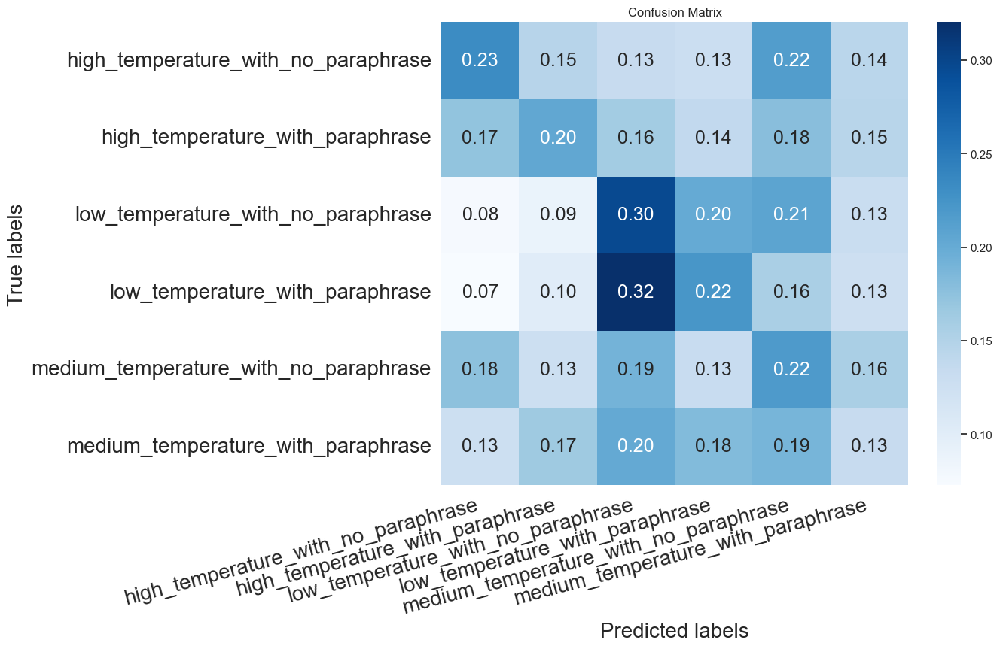

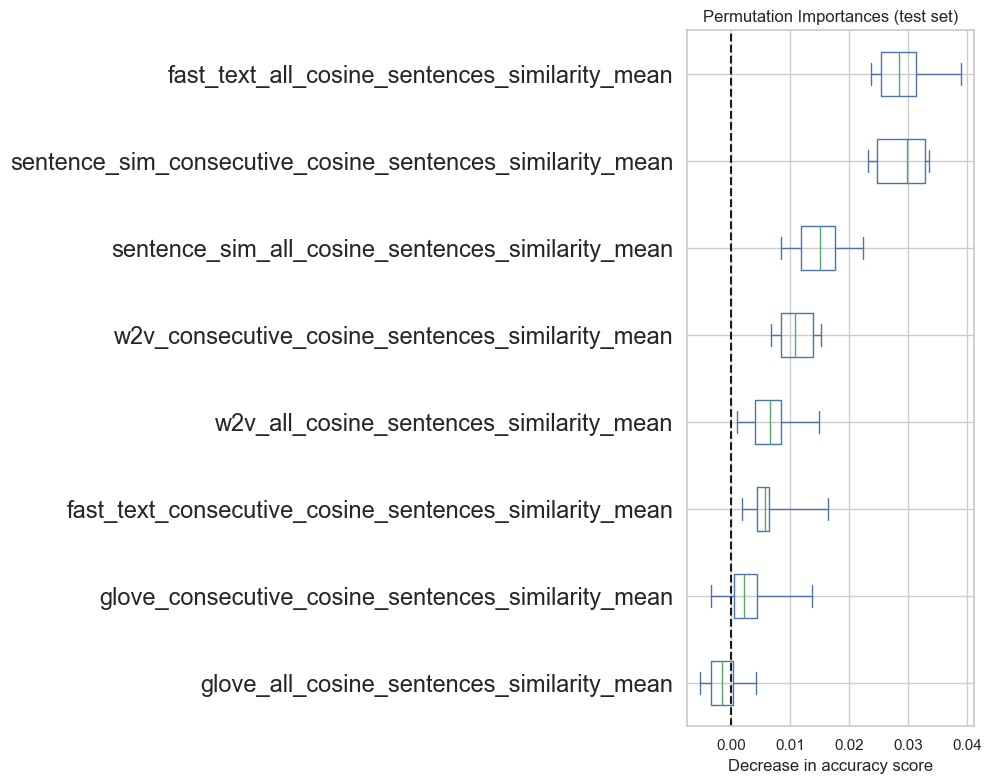

########################################
Training with cosine_std_sim_metrics
Accuracy: 0.23533333333333334
F1 Score: 0.23531649017962833
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.28      0.26      0.27       934
     high_temperature_with_paraphrase       0.27      0.23      0.25       887
   low_temperature_with_no_paraphrase       0.20      0.24      0.22      1110
      low_temperature_with_paraphrase       0.21      0.22      0.22       896
medium_temperature_with_no_paraphrase       0.26      0.28      0.27      1181
   medium_temperature_with_paraphrase       0.20      0.18      0.19       992

                             accuracy                           0.24      6000
                            macro avg       0.24      0.23      0.23      6000
                         weighted avg       0.24      0.24      0.24      6000



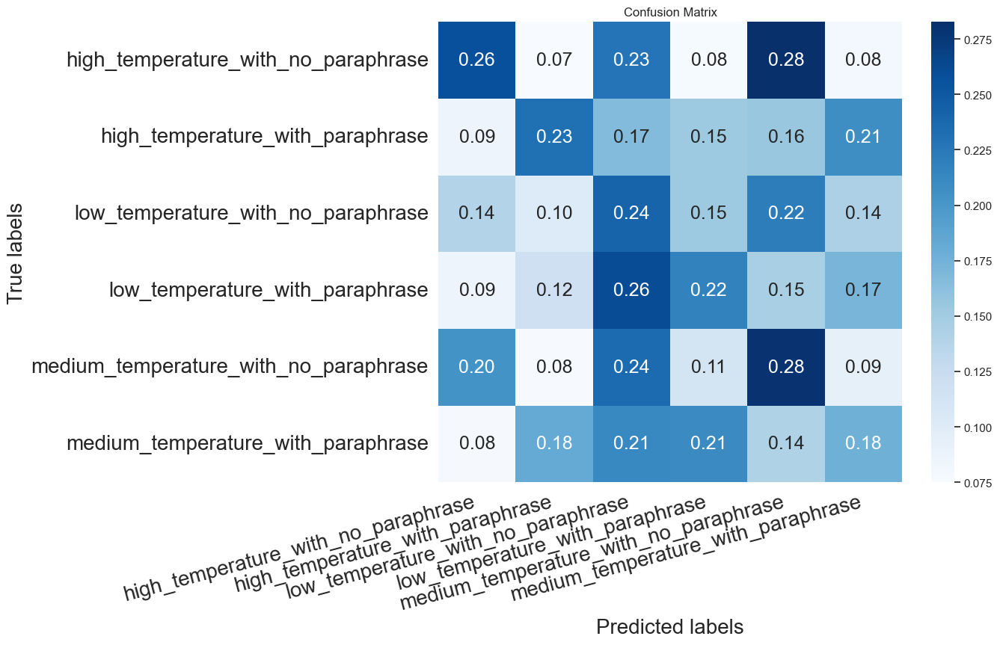

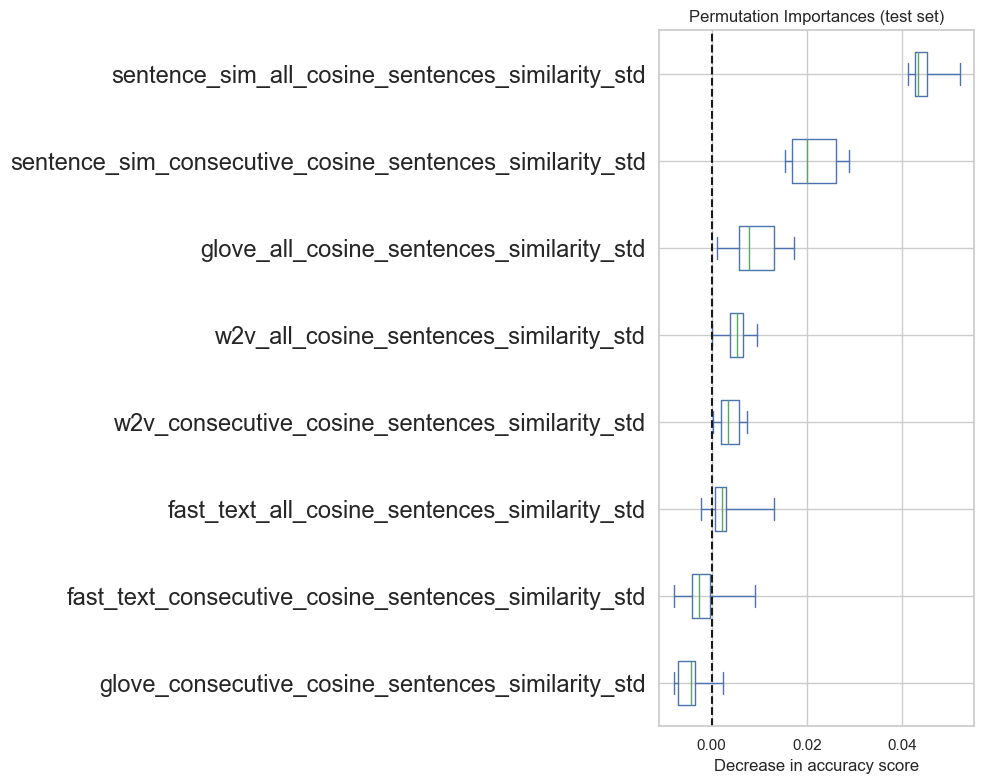

########################################
Training with wmd_mean_sim_metrics
Accuracy: 0.27566666666666667
F1 Score: 0.27164511554739085
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.36      0.39      0.38       934
     high_temperature_with_paraphrase       0.31      0.26      0.28       887
   low_temperature_with_no_paraphrase       0.29      0.35      0.32      1110
      low_temperature_with_paraphrase       0.22      0.25      0.24       896
medium_temperature_with_no_paraphrase       0.26      0.26      0.26      1181
   medium_temperature_with_paraphrase       0.18      0.13      0.15       992

                             accuracy                           0.28      6000
                            macro avg       0.27      0.28      0.27      6000
                         weighted avg       0.27      0.28      0.27      6000



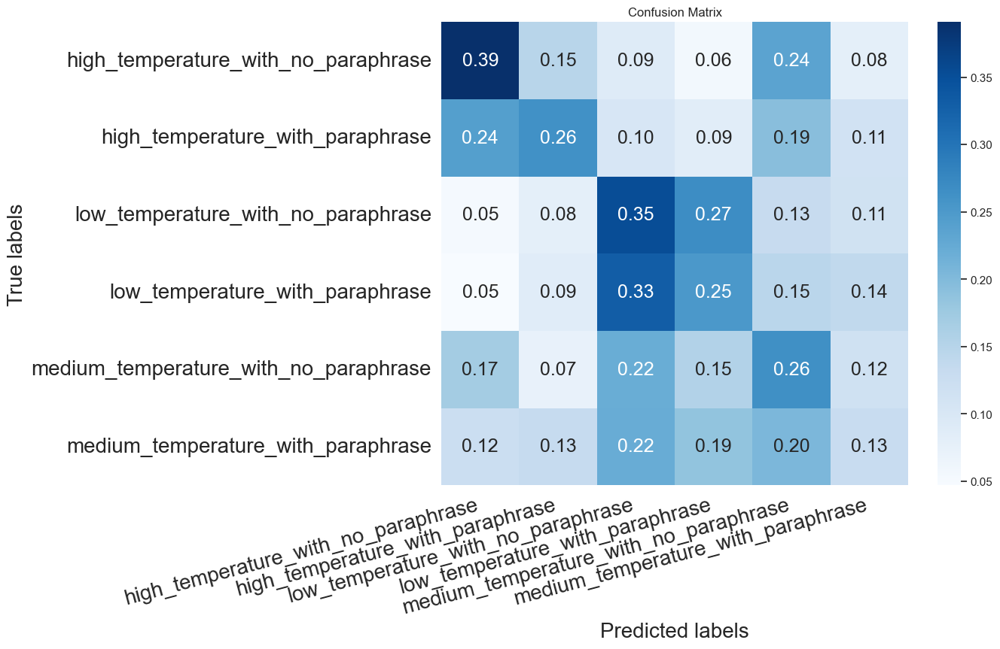

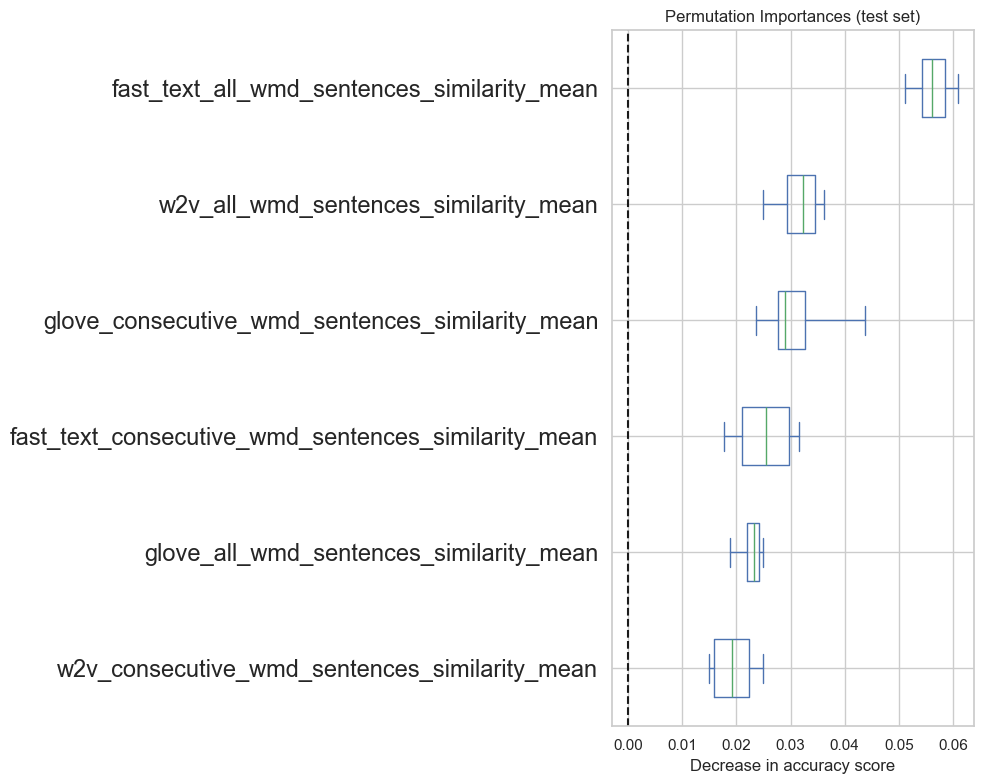

########################################
Training with wmd_std_sim_metrics
Accuracy: 0.3011666666666667
F1 Score: 0.2943485342224252
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.36      0.44      0.40       934
     high_temperature_with_paraphrase       0.35      0.22      0.27       887
   low_temperature_with_no_paraphrase       0.27      0.32      0.30      1110
      low_temperature_with_paraphrase       0.29      0.29      0.29       896
medium_temperature_with_no_paraphrase       0.29      0.36      0.32      1181
   medium_temperature_with_paraphrase       0.26      0.15      0.19       992

                             accuracy                           0.30      6000
                            macro avg       0.30      0.30      0.29      6000
                         weighted avg       0.30      0.30      0.29      6000



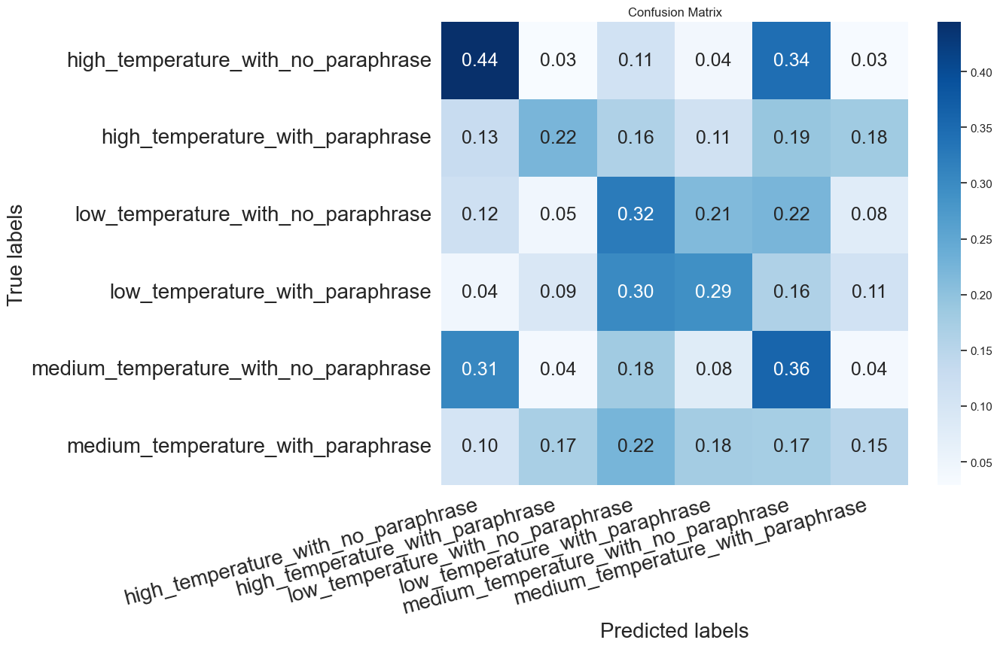

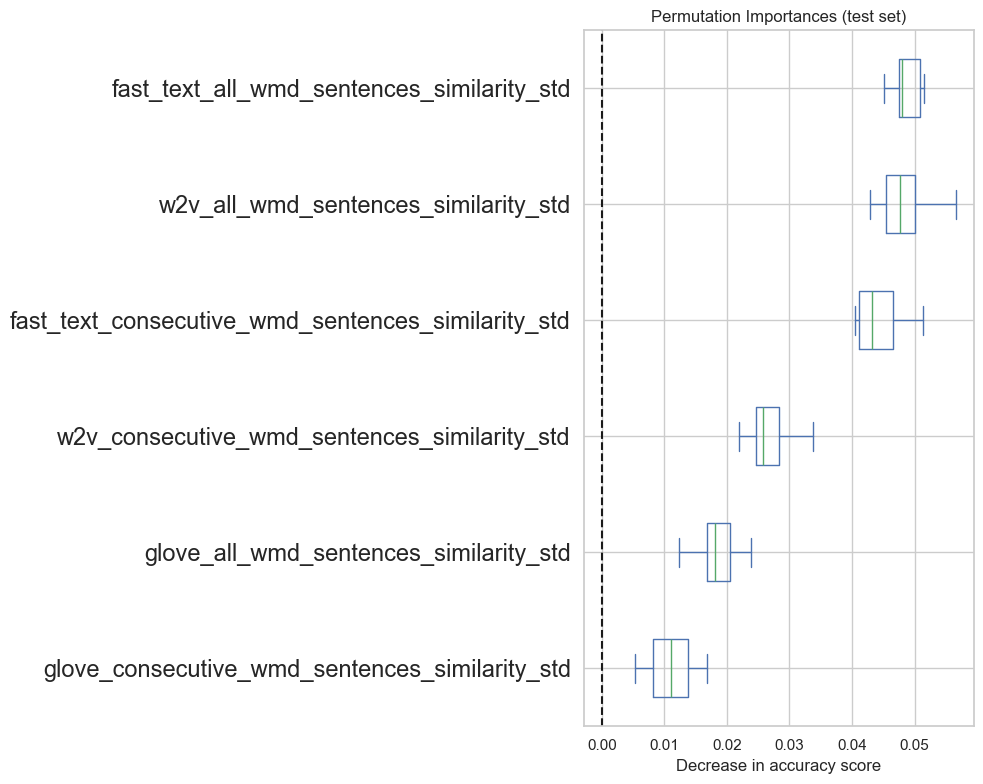

########################################
Training with mean_sim_metrics
Accuracy: 0.355
F1 Score: 0.3488521551924395
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.43      0.60      0.50       934
     high_temperature_with_paraphrase       0.32      0.36      0.34       887
   low_temperature_with_no_paraphrase       0.44      0.37      0.40      1110
      low_temperature_with_paraphrase       0.36      0.28      0.32       896
medium_temperature_with_no_paraphrase       0.31      0.32      0.31      1181
   medium_temperature_with_paraphrase       0.24      0.20      0.22       992

                             accuracy                           0.35      6000
                            macro avg       0.35      0.36      0.35      6000
                         weighted avg       0.35      0.35      0.35      6000



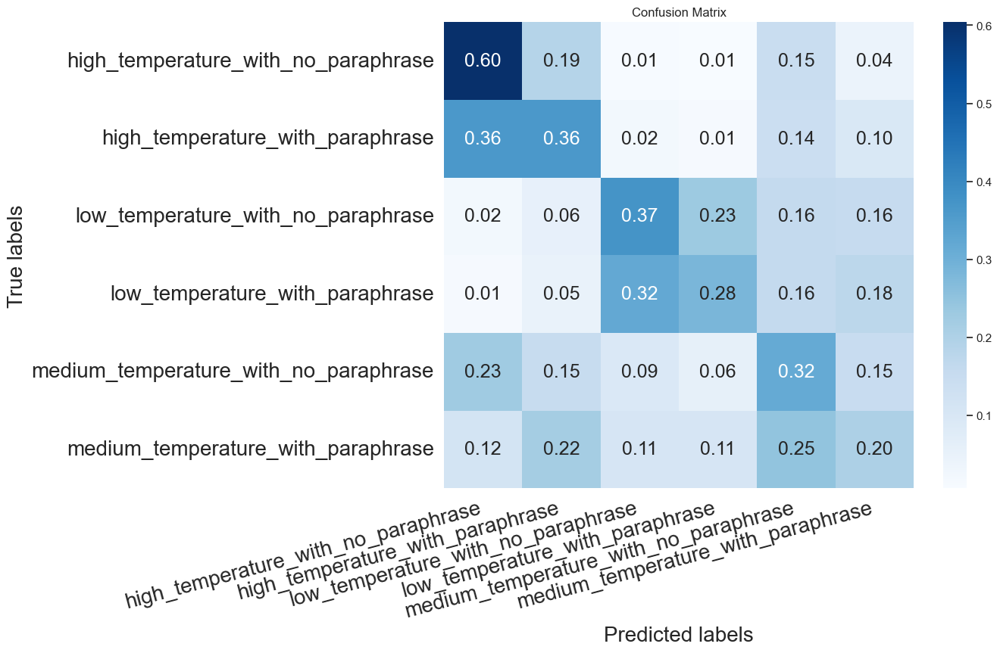

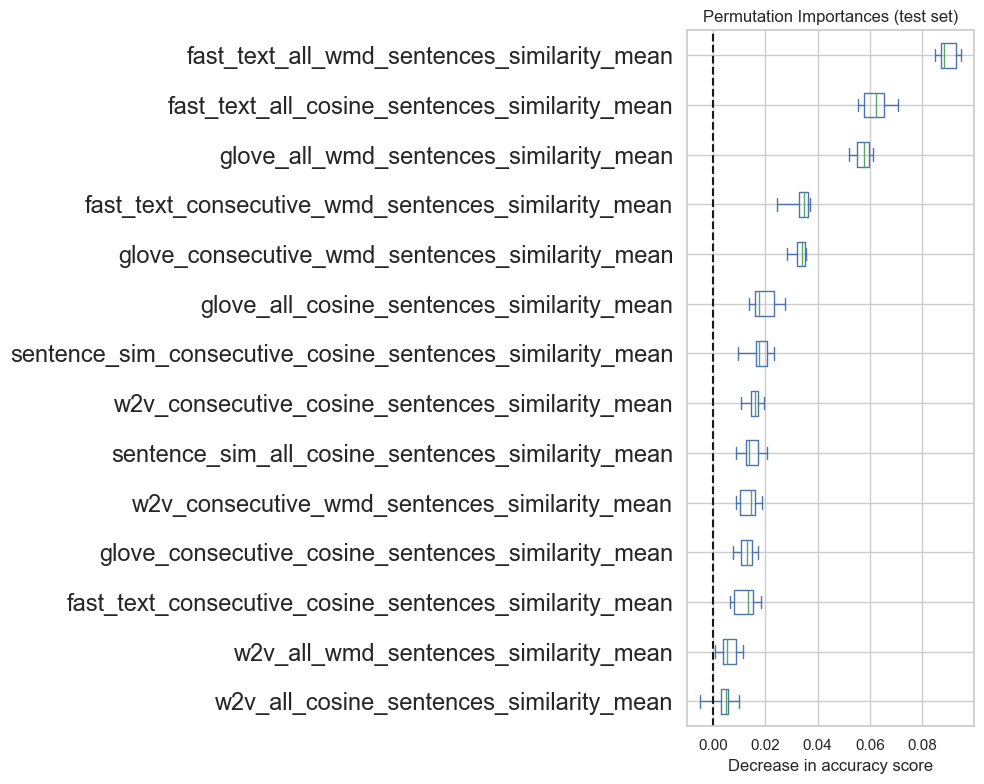

########################################
Training with density_features
Accuracy: 0.318
F1 Score: 0.31663666469559804
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.40      0.43      0.42       934
     high_temperature_with_paraphrase       0.34      0.32      0.33       887
   low_temperature_with_no_paraphrase       0.29      0.31      0.30      1110
      low_temperature_with_paraphrase       0.34      0.33      0.33       896
medium_temperature_with_no_paraphrase       0.29      0.31      0.30      1181
   medium_temperature_with_paraphrase       0.26      0.22      0.24       992

                             accuracy                           0.32      6000
                            macro avg       0.32      0.32      0.32      6000
                         weighted avg       0.32      0.32      0.32      6000



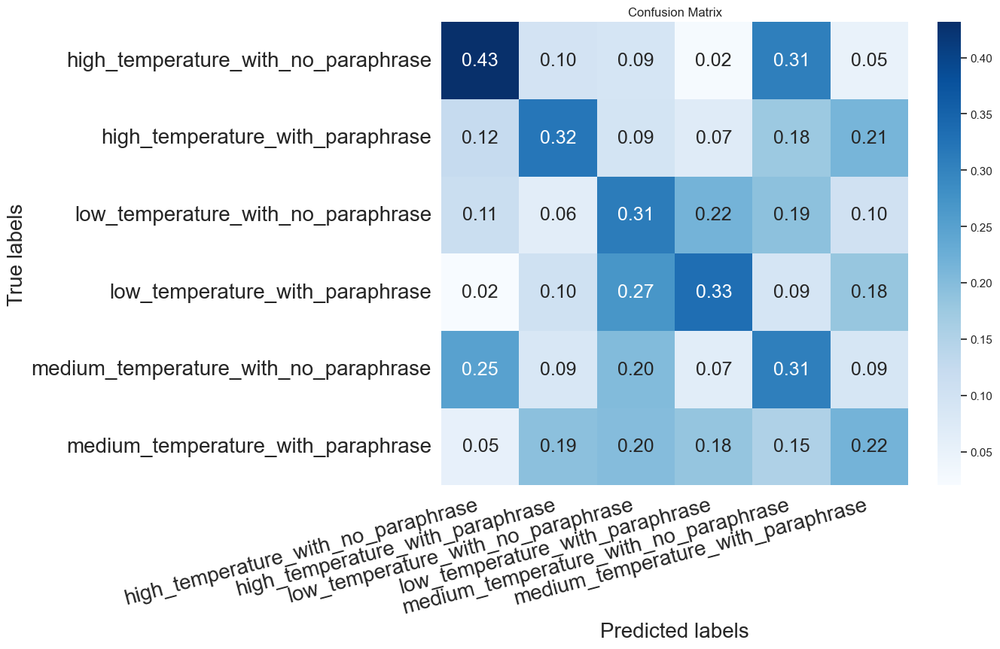

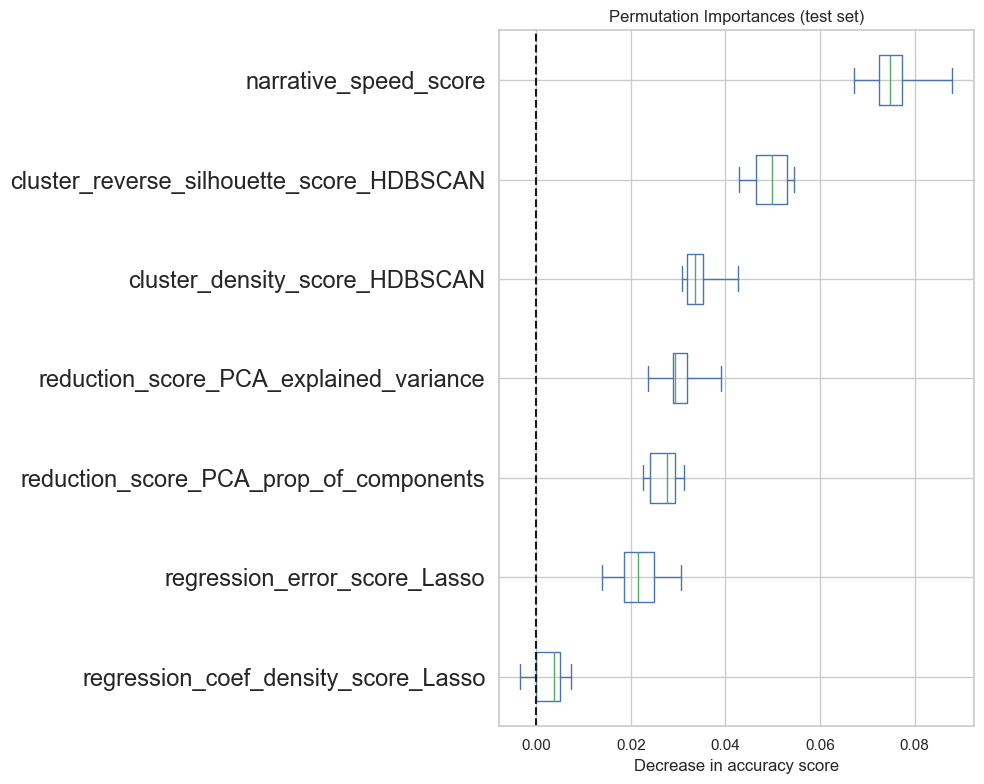

########################################
Training with std_sim_metrics
Accuracy: 0.33816666666666667
F1 Score: 0.3351341172508901
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.42      0.48      0.45       934
     high_temperature_with_paraphrase       0.40      0.31      0.35       887
   low_temperature_with_no_paraphrase       0.30      0.32      0.31      1110
      low_temperature_with_paraphrase       0.32      0.35      0.33       896
medium_temperature_with_no_paraphrase       0.31      0.35      0.33      1181
   medium_temperature_with_paraphrase       0.29      0.21      0.25       992

                             accuracy                           0.34      6000
                            macro avg       0.34      0.34      0.34      6000
                         weighted avg       0.34      0.34      0.34      6000



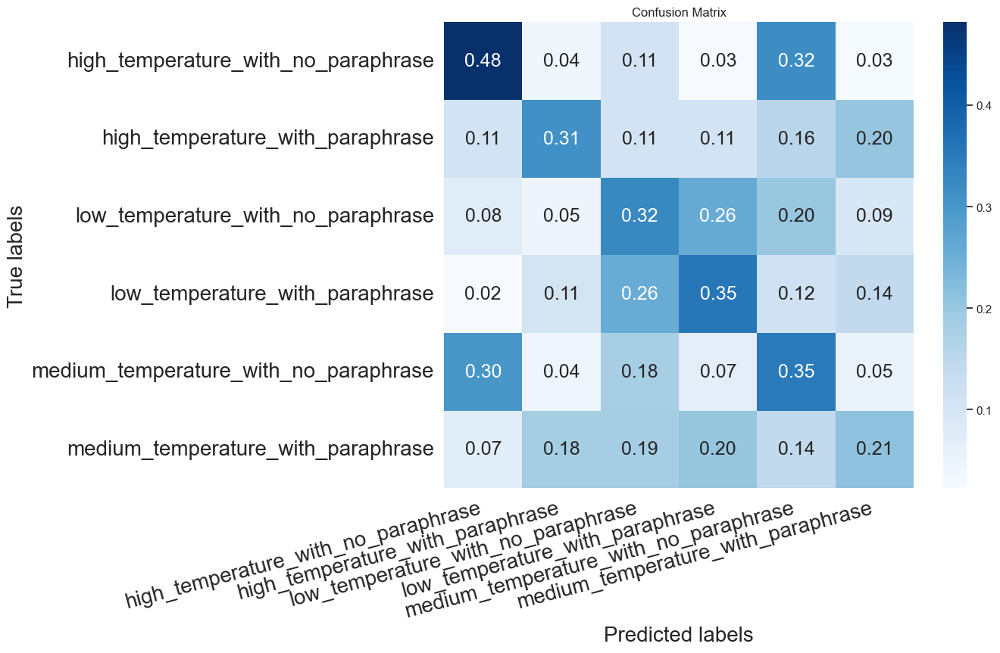

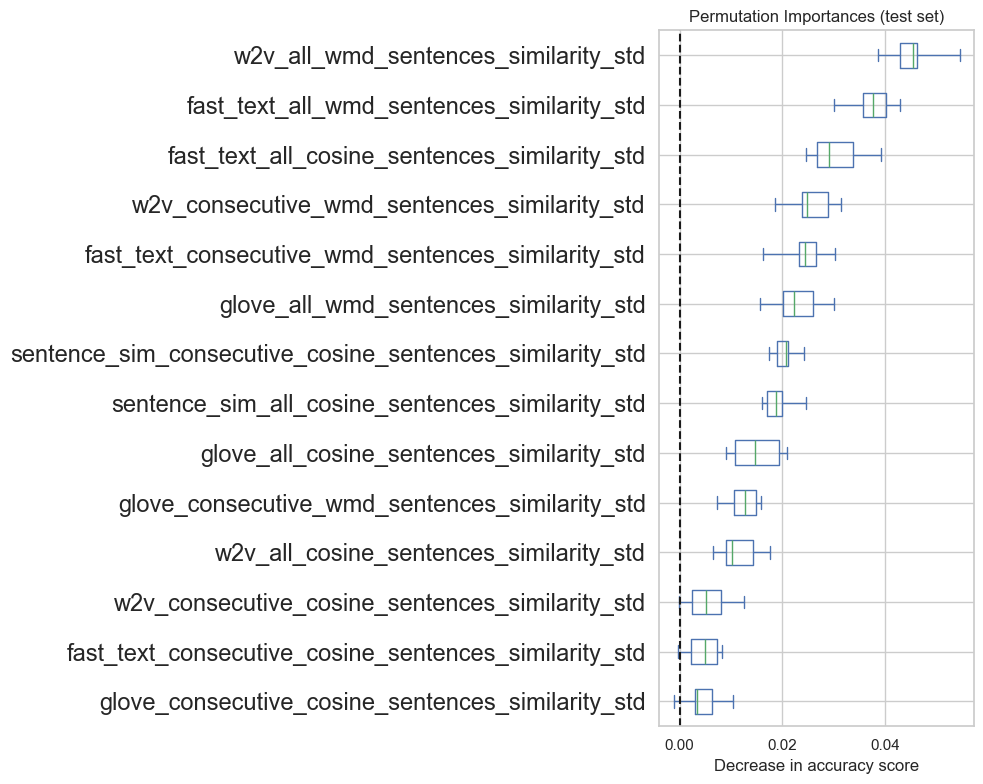

########################################
Training with all_features
Accuracy: 0.476
F1 Score: 0.47016534418108236
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.55      0.69      0.61       934
     high_temperature_with_paraphrase       0.52      0.60      0.56       887
   low_temperature_with_no_paraphrase       0.50      0.41      0.45      1110
      low_temperature_with_paraphrase       0.47      0.42      0.45       896
medium_temperature_with_no_paraphrase       0.40      0.44      0.42      1181
   medium_temperature_with_paraphrase       0.40      0.33      0.36       992

                             accuracy                           0.48      6000
                            macro avg       0.47      0.48      0.47      6000
                         weighted avg       0.47      0.48      0.47      6000



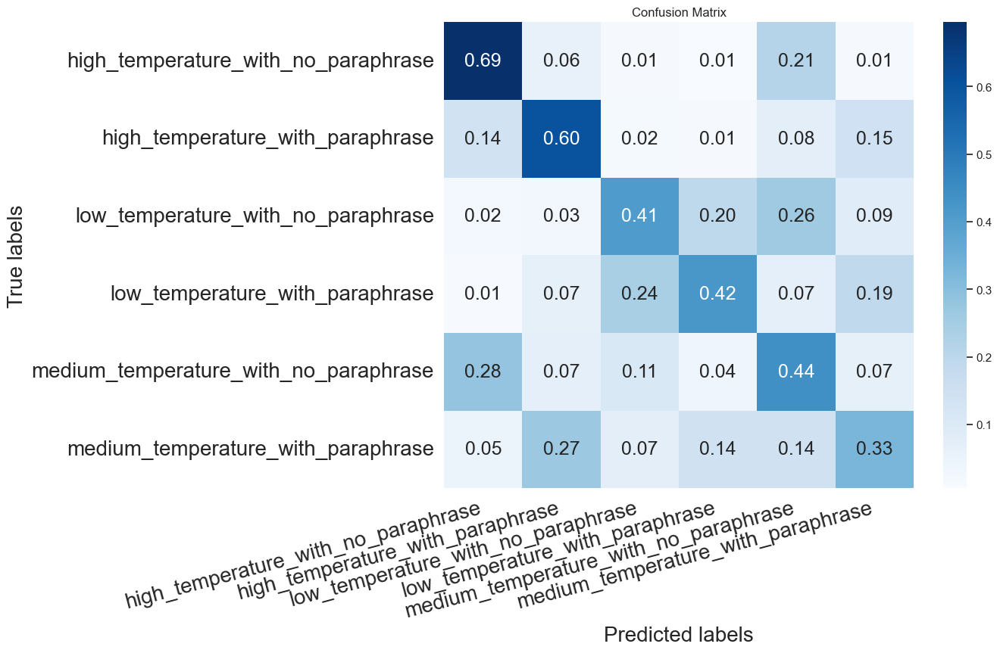

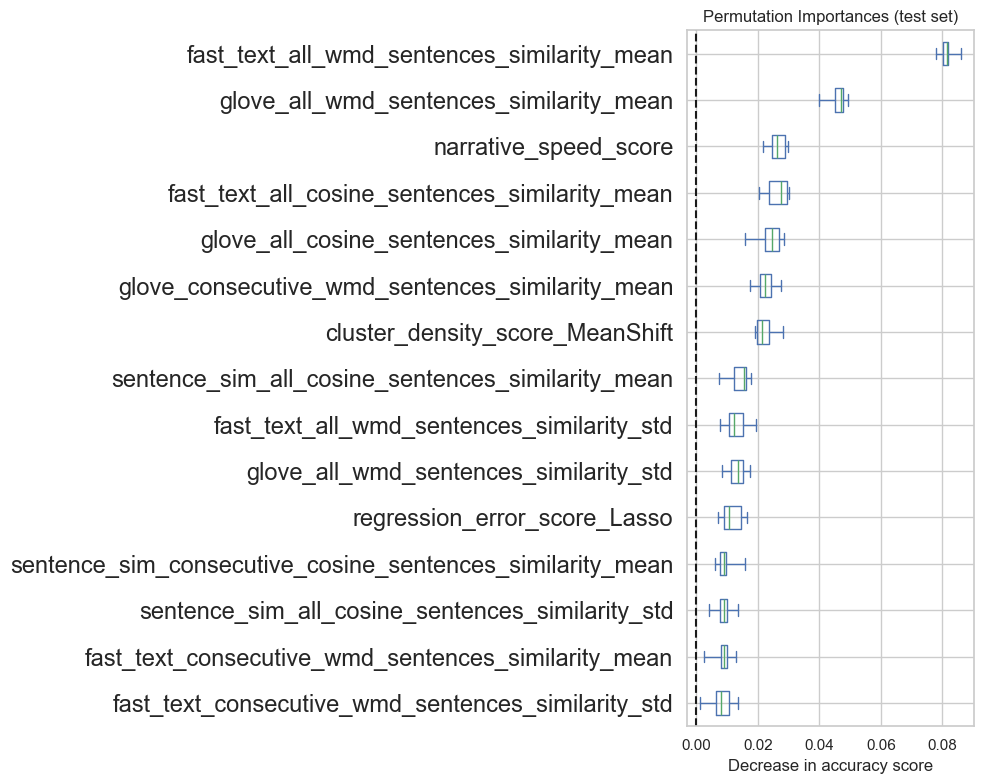

########################################
Training with best_features
Accuracy: 0.4605
F1 Score: 0.4534312810624821
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.53      0.70      0.61       934
     high_temperature_with_paraphrase       0.50      0.60      0.54       887
   low_temperature_with_no_paraphrase       0.48      0.39      0.43      1110
      low_temperature_with_paraphrase       0.45      0.37      0.41       896
medium_temperature_with_no_paraphrase       0.40      0.42      0.41      1181
   medium_temperature_with_paraphrase       0.38      0.33      0.35       992

                             accuracy                           0.46      6000
                            macro avg       0.46      0.47      0.46      6000
                         weighted avg       0.45      0.46      0.45      6000



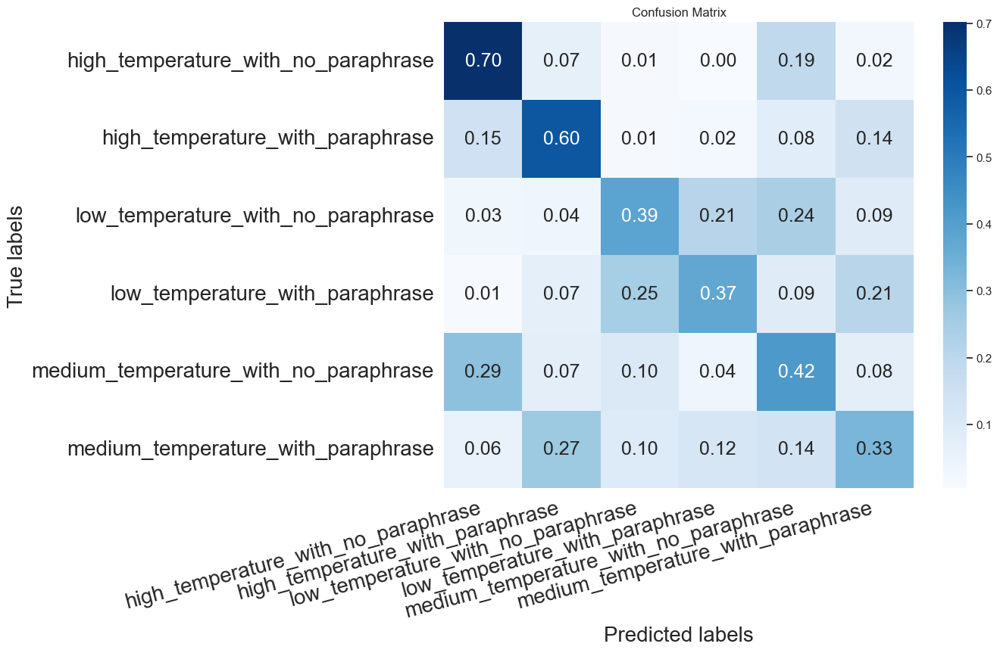

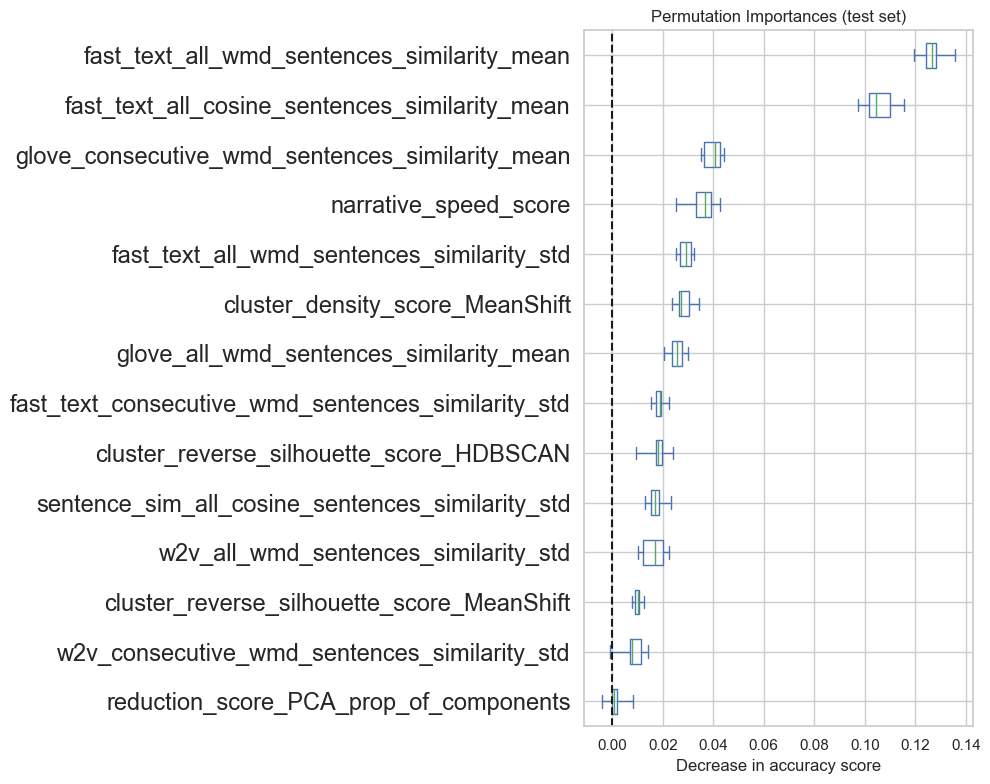

########################################
Training with semantic_contribution
Accuracy: 0.24116666666666667
F1 Score: 0.23637460341534697
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.28      0.39      0.33       934
     high_temperature_with_paraphrase       0.20      0.17      0.18       887
   low_temperature_with_no_paraphrase       0.24      0.25      0.25      1110
      low_temperature_with_paraphrase       0.27      0.25      0.26       896
medium_temperature_with_no_paraphrase       0.22      0.24      0.23      1181
   medium_temperature_with_paraphrase       0.21      0.15      0.17       992

                             accuracy                           0.24      6000
                            macro avg       0.24      0.24      0.24      6000
                         weighted avg       0.24      0.24      0.24      6000



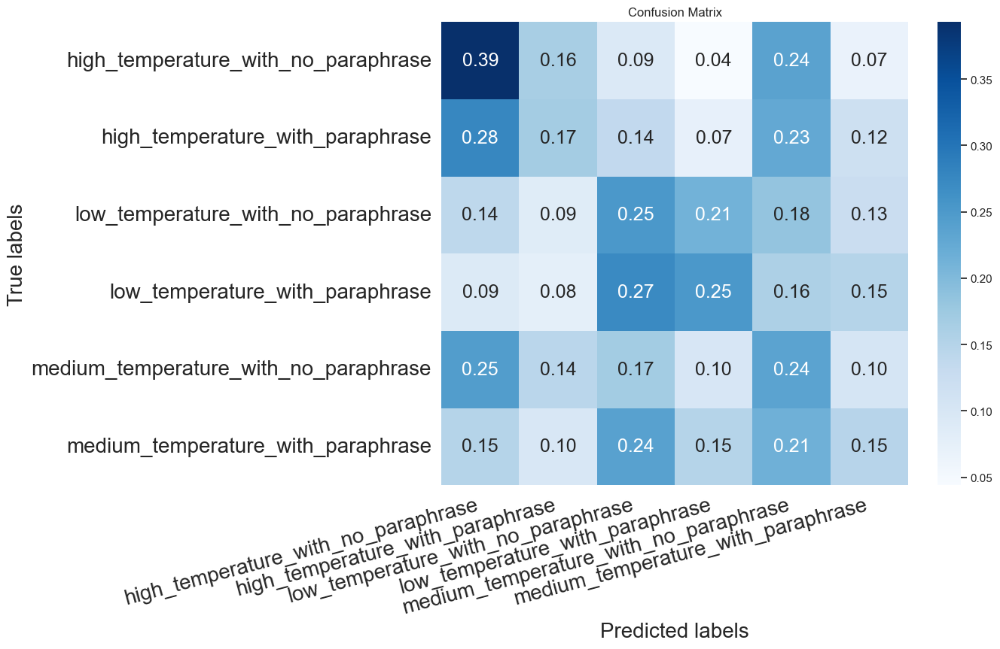

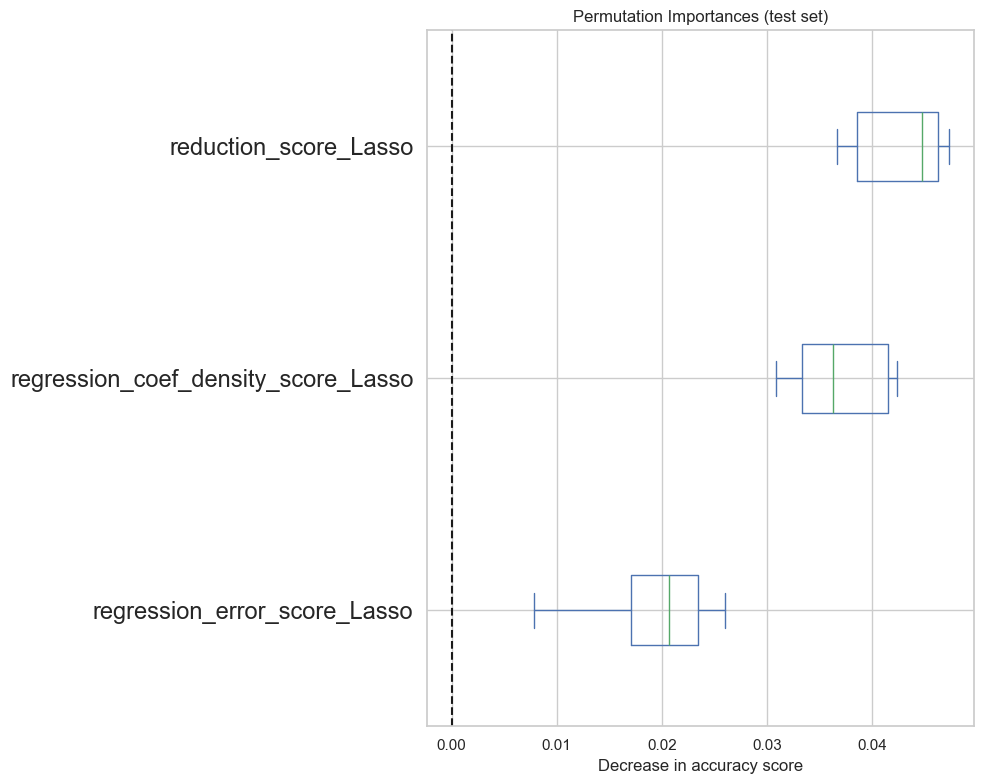

########################################
Training with structural_density
Accuracy: 0.3268333333333333
F1 Score: 0.325341743245822
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.41      0.44      0.42       934
     high_temperature_with_paraphrase       0.38      0.36      0.37       887
   low_temperature_with_no_paraphrase       0.28      0.30      0.29      1110
      low_temperature_with_paraphrase       0.35      0.33      0.34       896
medium_temperature_with_no_paraphrase       0.30      0.33      0.31      1181
   medium_temperature_with_paraphrase       0.26      0.21      0.24       992

                             accuracy                           0.33      6000
                            macro avg       0.33      0.33      0.33      6000
                         weighted avg       0.33      0.33      0.33      6000



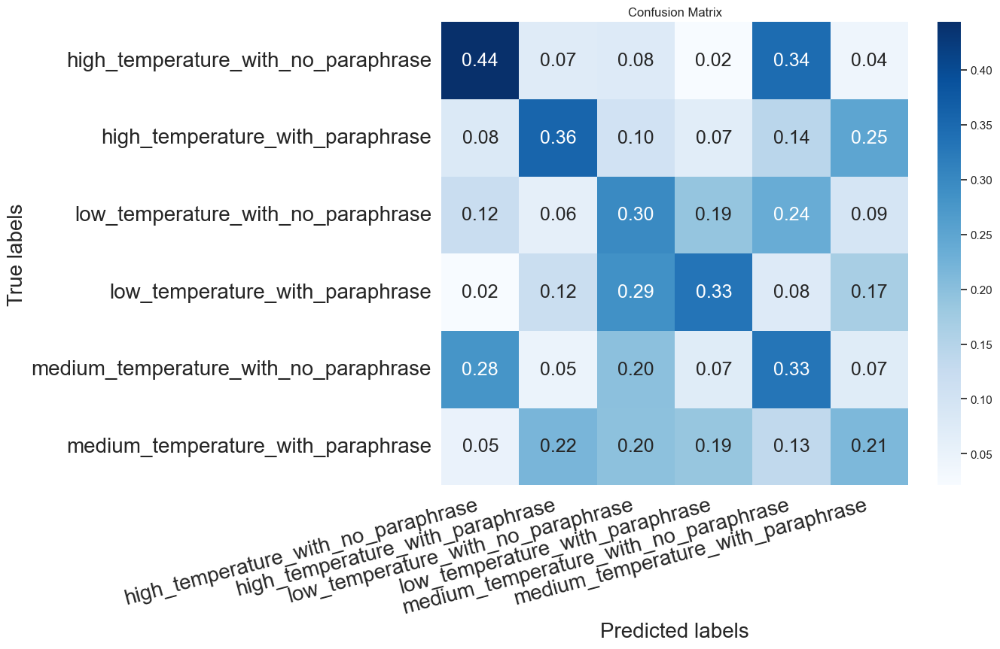

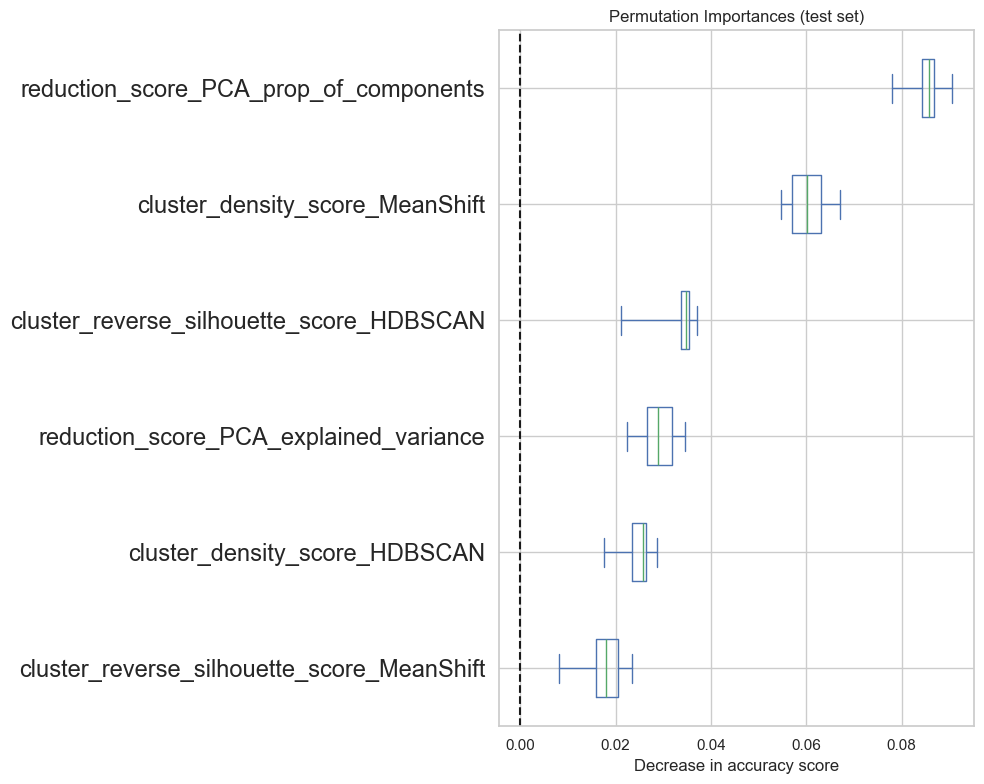

########################################
Training with average_features
Accuracy: 0.3436666666666667
F1 Score: 0.33076468847891594
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.41      0.65      0.50       934
     high_temperature_with_paraphrase       0.34      0.41      0.37       887
   low_temperature_with_no_paraphrase       0.37      0.31      0.34      1110
      low_temperature_with_paraphrase       0.32      0.23      0.27       896
medium_temperature_with_no_paraphrase       0.33      0.31      0.32      1181
   medium_temperature_with_paraphrase       0.23      0.17      0.20       992

                             accuracy                           0.34      6000
                            macro avg       0.33      0.35      0.33      6000
                         weighted avg       0.33      0.34      0.33      6000



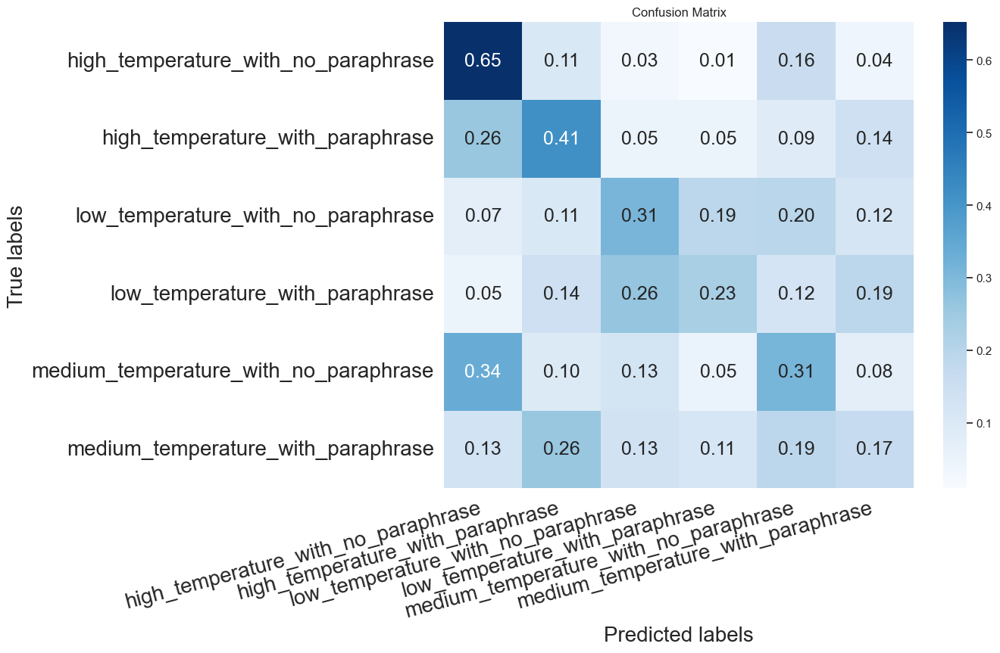

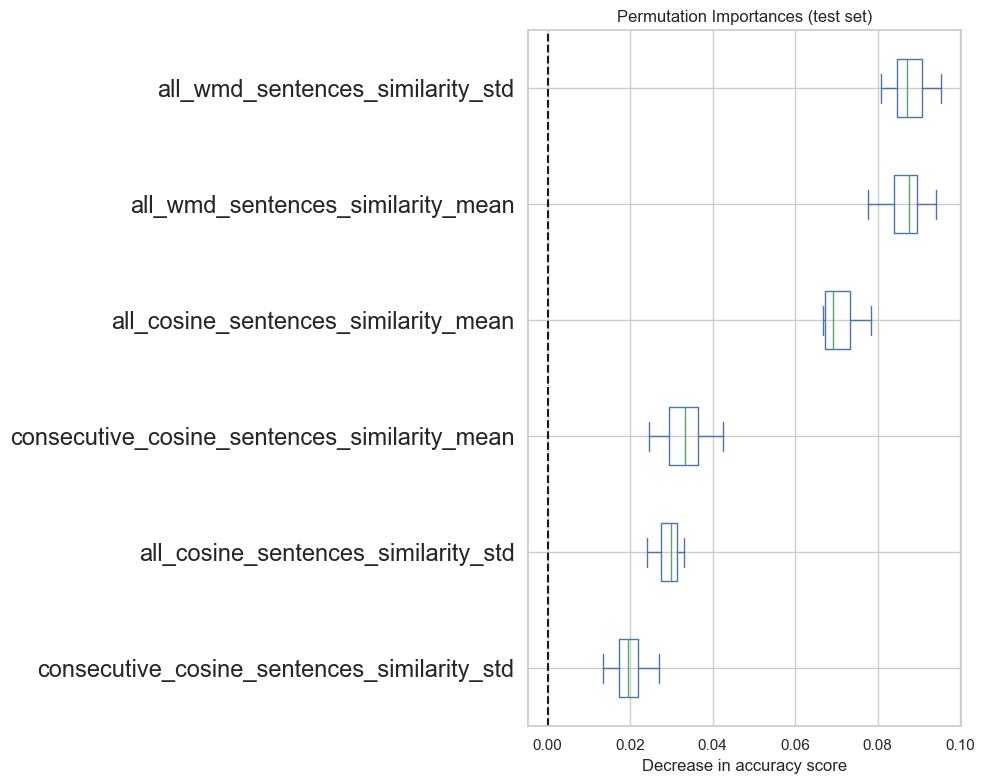

########################################
Training with average_and_structural_density
Accuracy: 0.4136666666666667
F1 Score: 0.40489502688664863
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.47      0.66      0.55       934
     high_temperature_with_paraphrase       0.45      0.55      0.49       887
   low_temperature_with_no_paraphrase       0.43      0.35      0.39      1110
      low_temperature_with_paraphrase       0.43      0.32      0.37       896
medium_temperature_with_no_paraphrase       0.37      0.39      0.38      1181
   medium_temperature_with_paraphrase       0.31      0.24      0.27       992

                             accuracy                           0.41      6000
                            macro avg       0.41      0.42      0.41      6000
                         weighted avg       0.41      0.41      0.40      6000



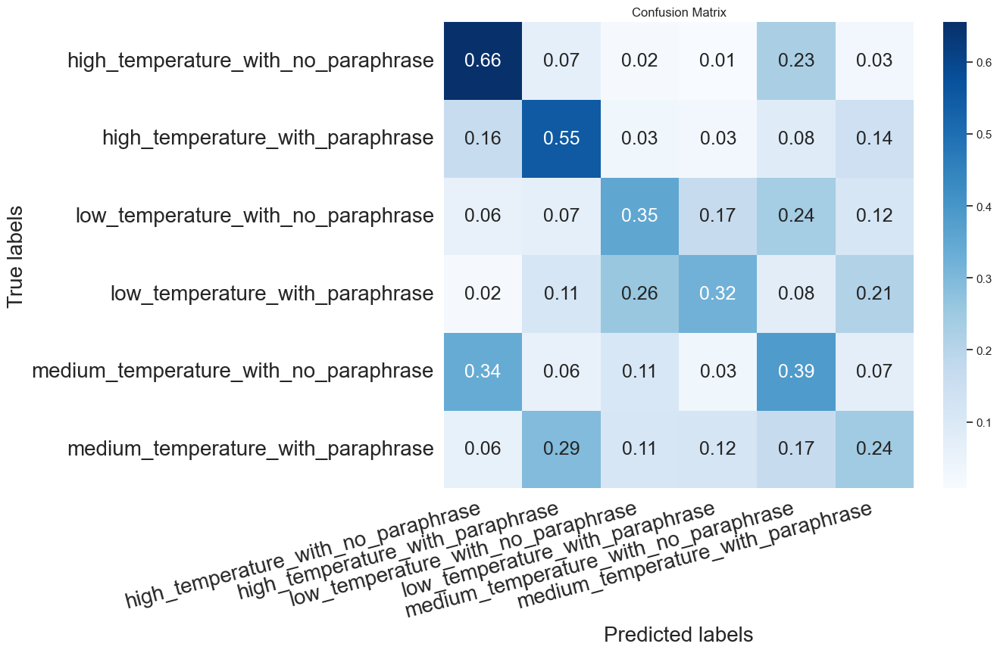

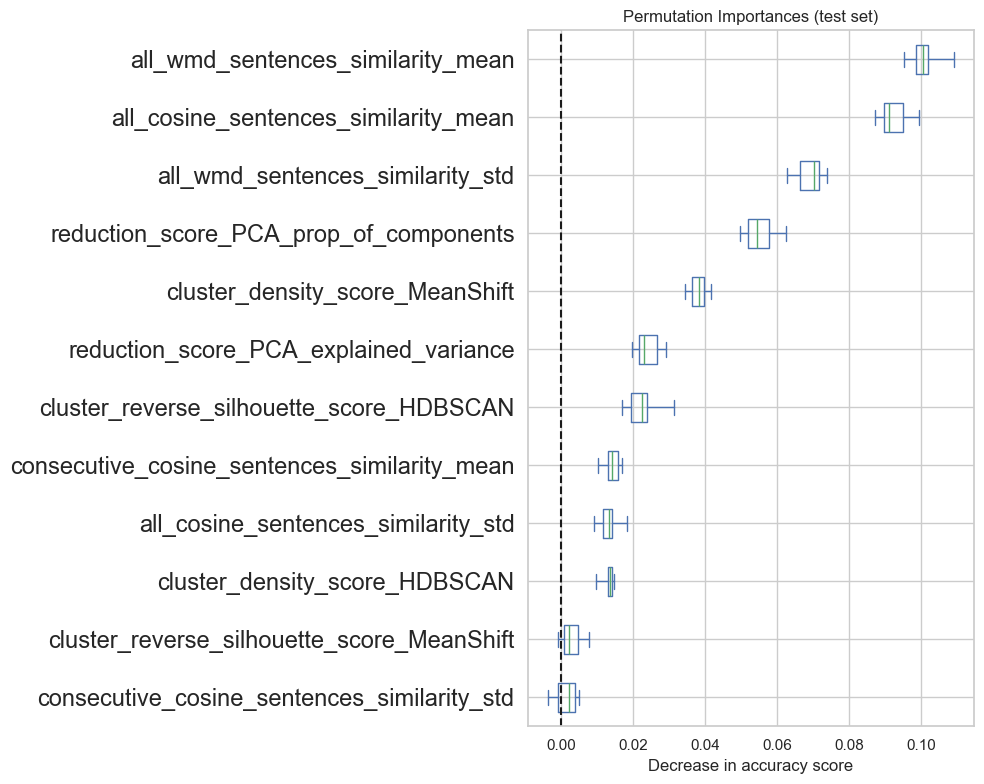

########################################
Training with narrative_speed
Accuracy: 0.266
F1 Score: 0.24257510731464088
                                       precision    recall  f1-score   support

  high_temperature_with_no_paraphrase       0.33      0.54      0.41       934
     high_temperature_with_paraphrase       0.20      0.05      0.08       887
   low_temperature_with_no_paraphrase       0.24      0.35      0.28      1110
      low_temperature_with_paraphrase       0.32      0.32      0.32       896
medium_temperature_with_no_paraphrase       0.22      0.24      0.23      1181
   medium_temperature_with_paraphrase       0.21      0.10      0.13       992

                             accuracy                           0.27      6000
                            macro avg       0.25      0.27      0.24      6000
                         weighted avg       0.25      0.27      0.24      6000



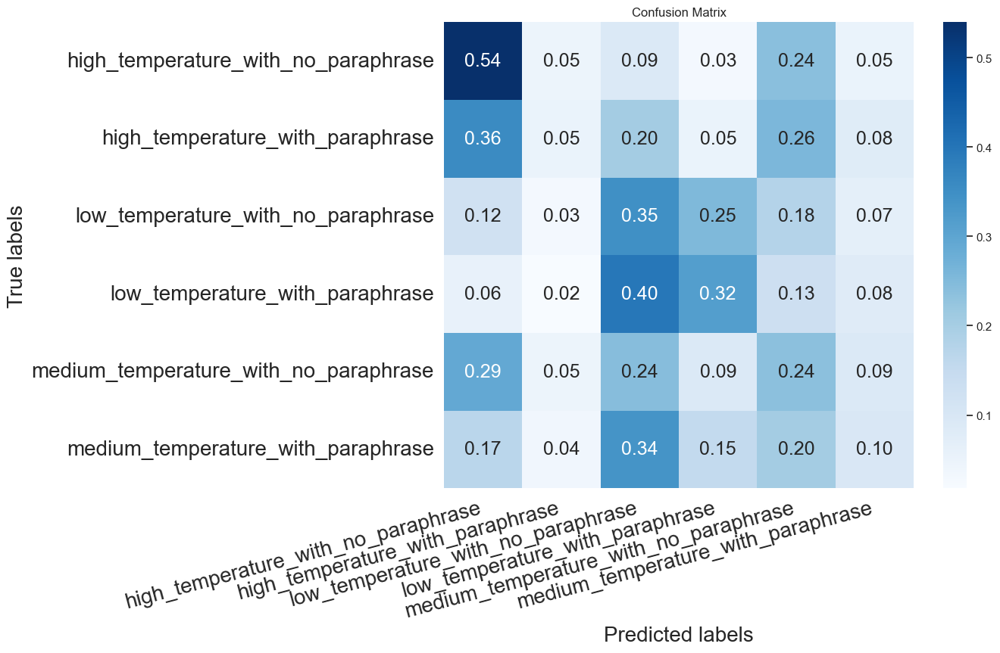

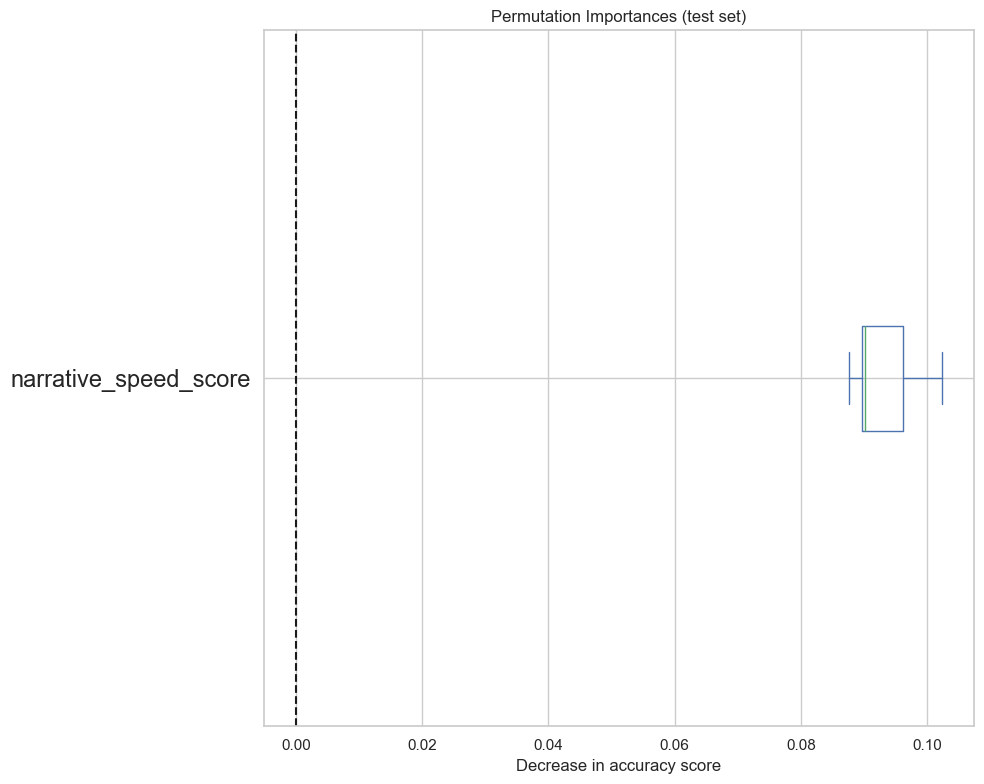

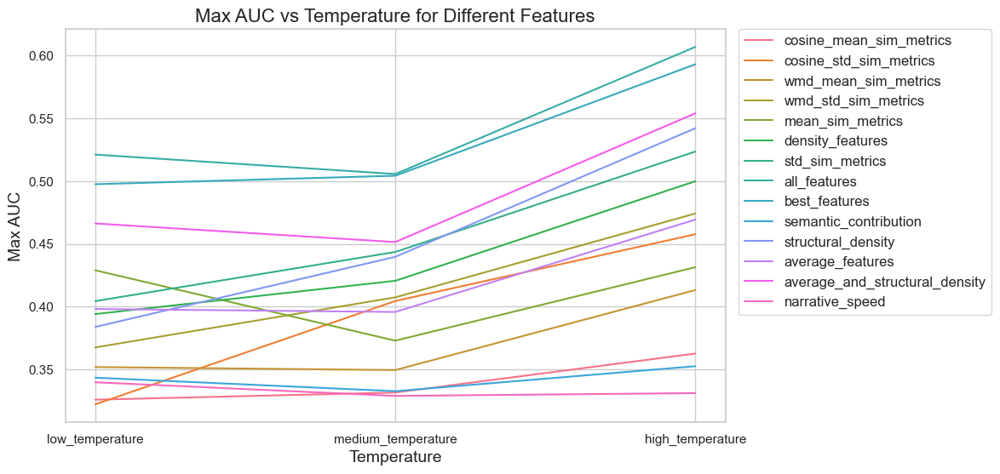

,features_name,accuracy,f1_score
7,all_features,0.476,0.470165
8,best_features,0.4605,0.453431
12,average_and_structural_density,0.413667,0.404895
4,mean_sim_metrics,0.355,0.348852
6,std_sim_metrics,0.338167,0.335134
11,average_features,0.343667,0.330765
10,structural_density,0.326833,0.325342
5,density_features,0.318,0.316637
3,wmd_std_sim_metrics,0.301167,0.294349
2,wmd_mean_sim_metrics,0.275667,0.271645


In [9]:
print(dataset.combined_label.value_counts())
df_results = train_and_evaluate_xgb(features_dict, dataset, y_name="cat_label", num_to_label = num_to_label, plot = plot, compute_context_auc=True)
df_results.sort_values(by = "f1_score", ascending = False)
df_results[['features_name','accuracy','f1_score']].sort_values(by = "f1_score", ascending = False)

########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.2689352360043908
F1 Score: 0.25908127227373545


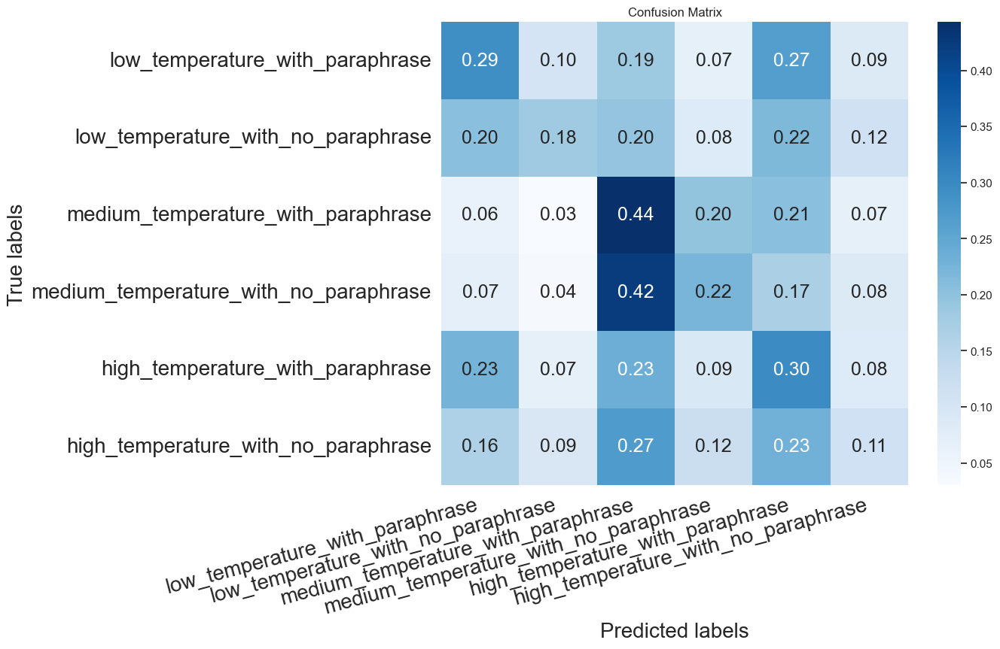

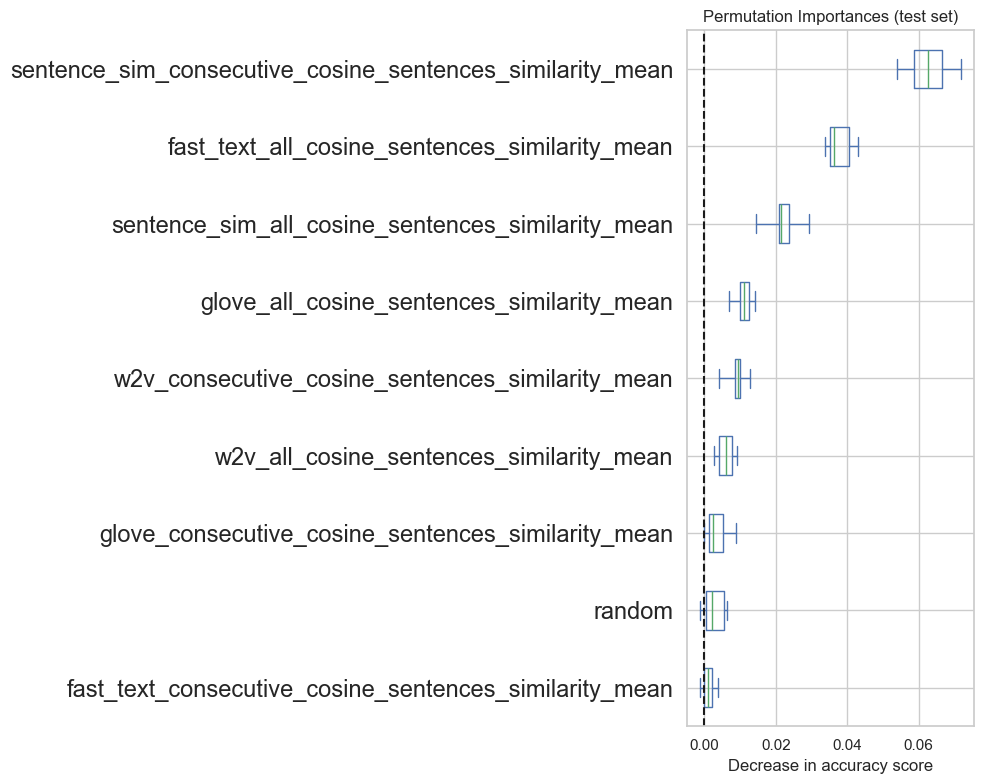

########################################
Training with cosine_std_sim_metrics
Accuracy: 0.27552140504939626
F1 Score: 0.273646924314338


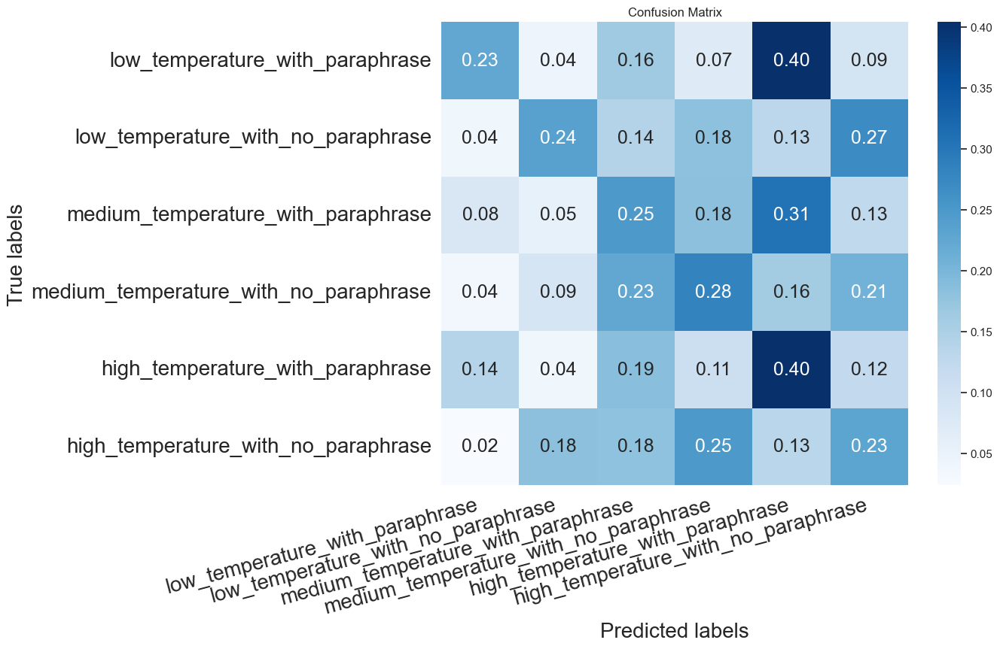

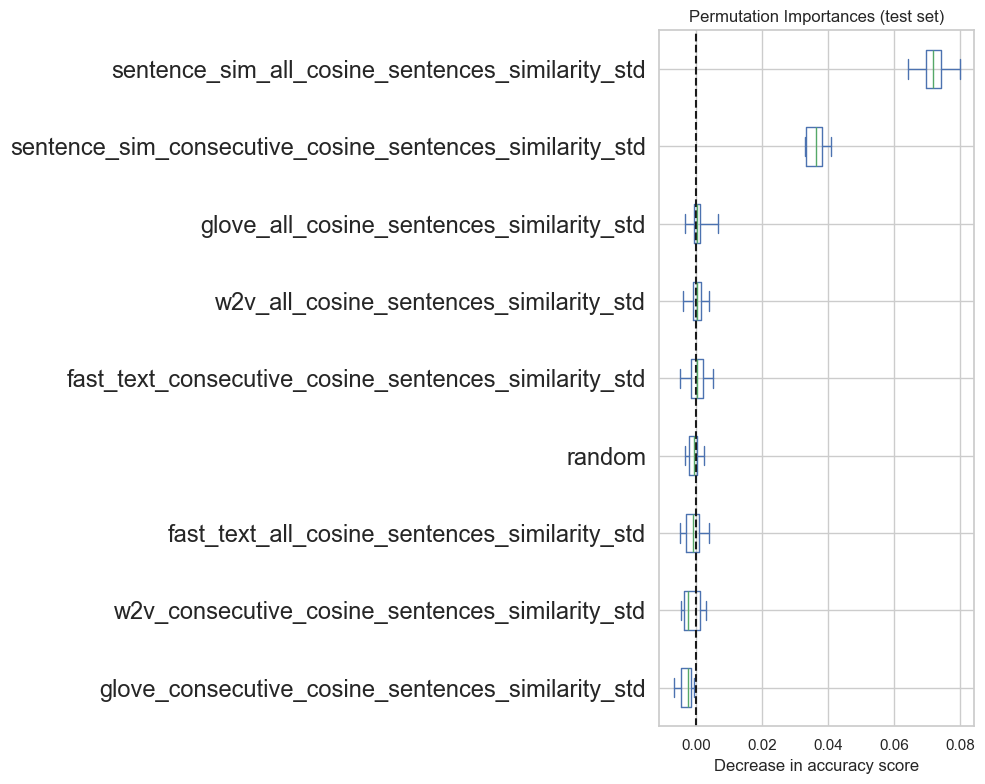

########################################
Training with wmd_mean_sim_metrics
Accuracy: 0.3012388270346558
F1 Score: 0.28186272406935414


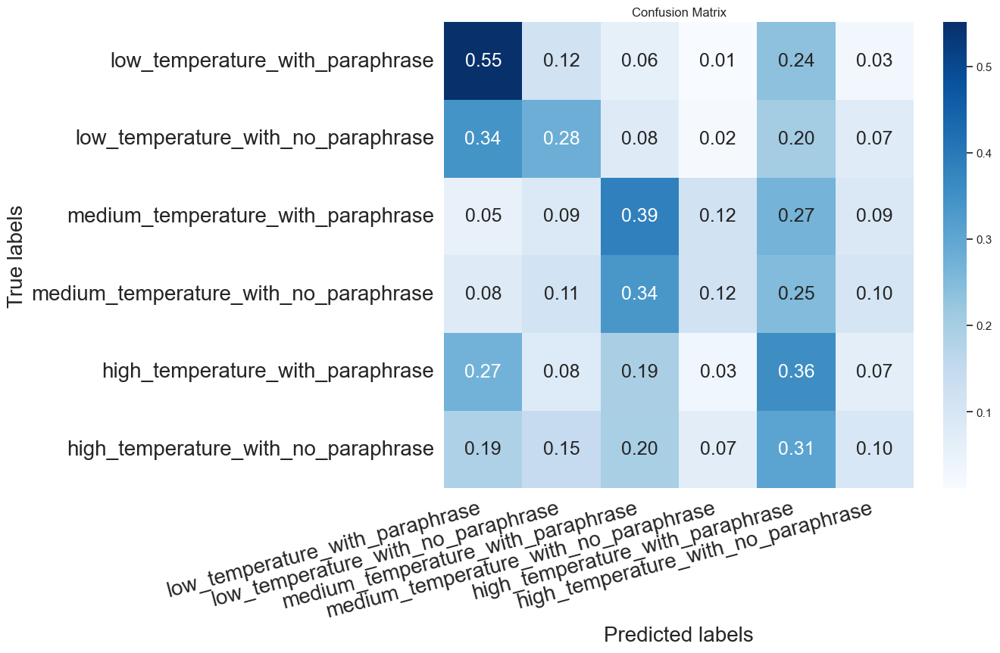

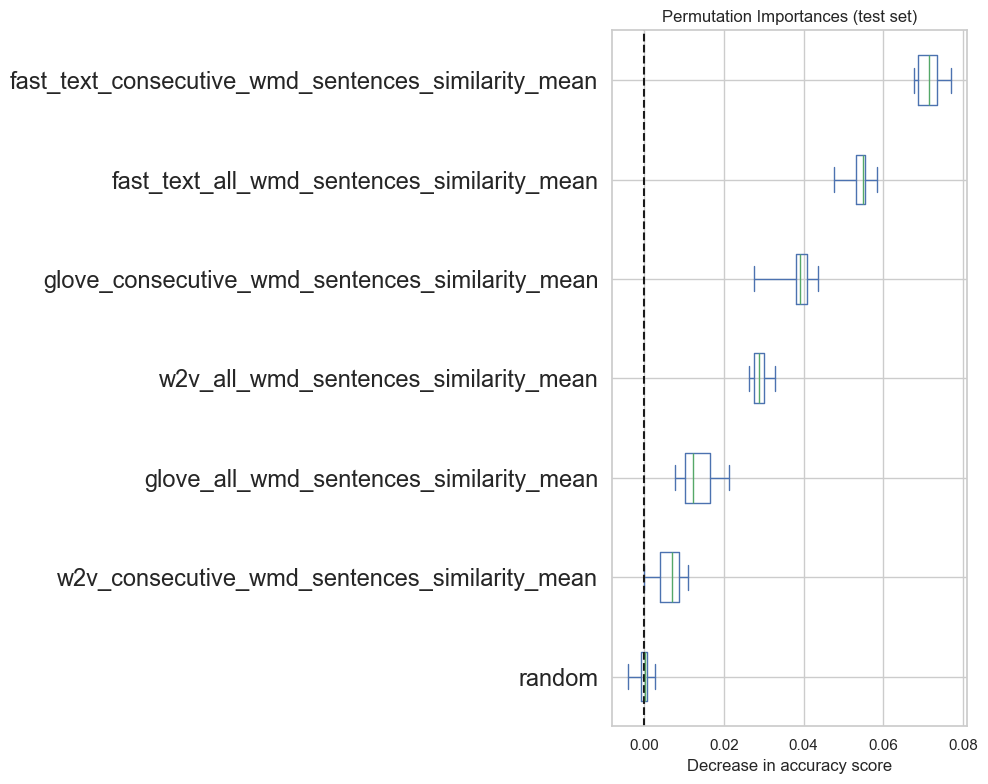

########################################
Training with wmd_std_sim_metrics
Accuracy: 0.34373529872981023
F1 Score: 0.34184786937423683


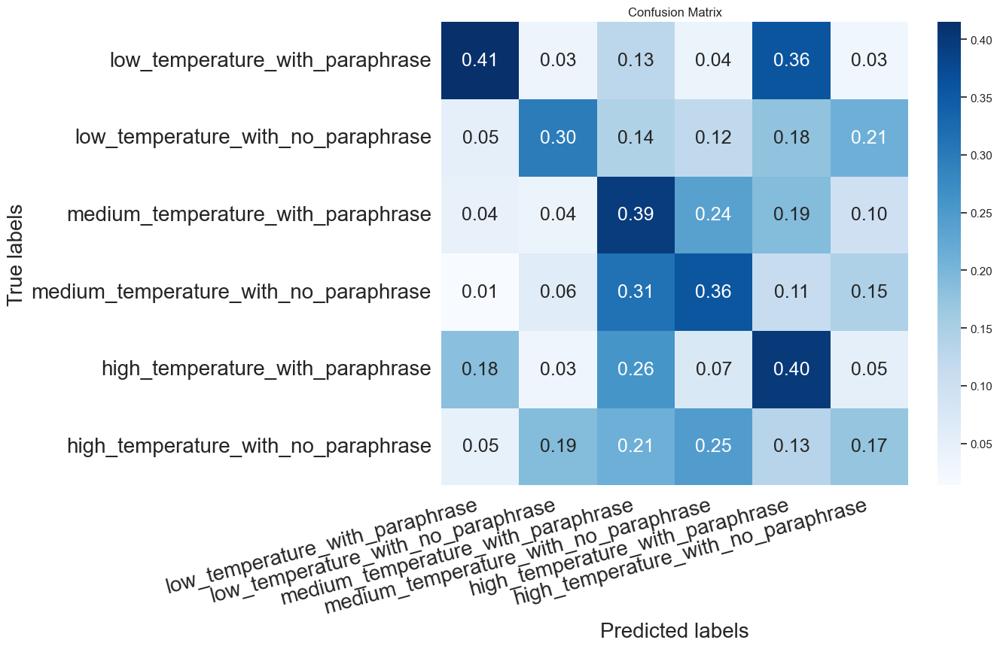

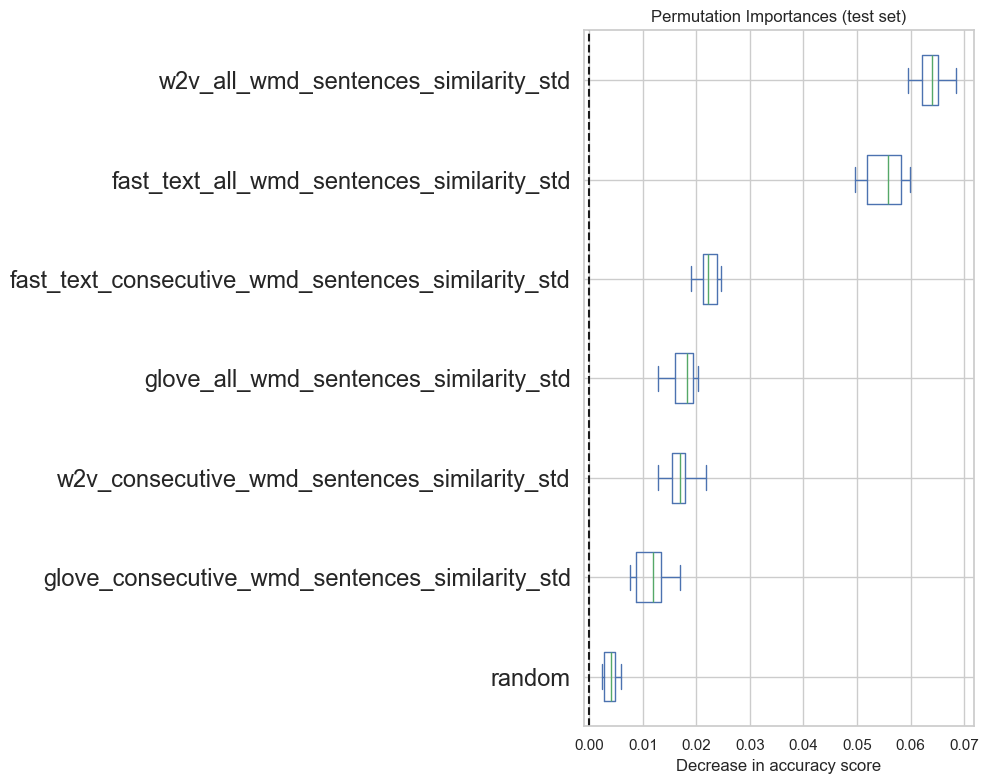

########################################
Training with mean_sim_metrics
Accuracy: 0.38121373686686527
F1 Score: 0.3721017830578528


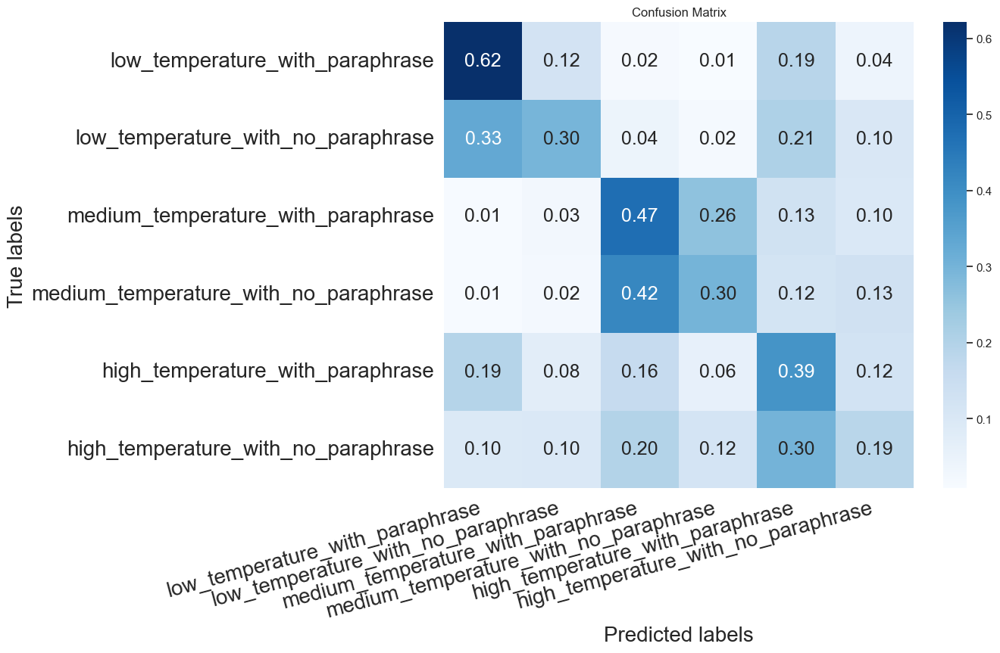

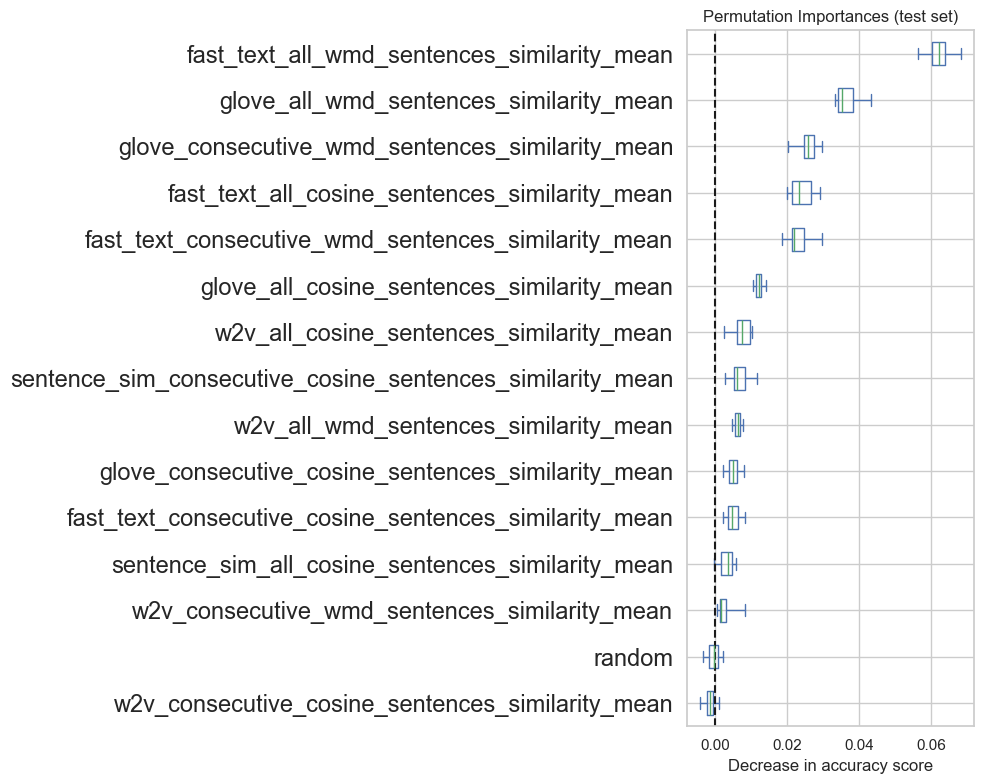

########################################
Training with density_features
Accuracy: 0.3899952955935393
F1 Score: 0.38265489446692824


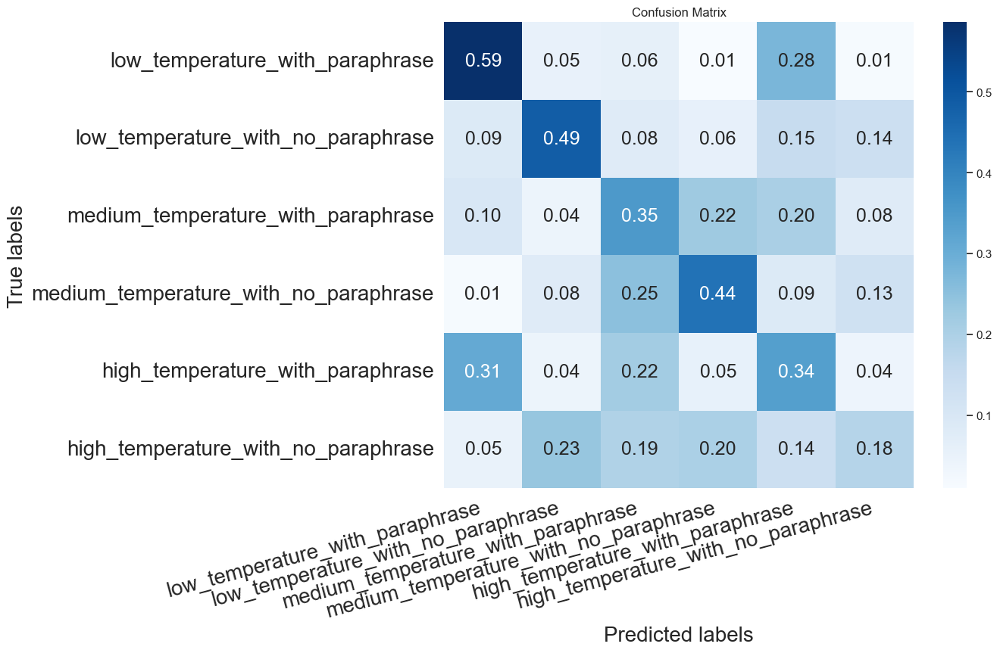

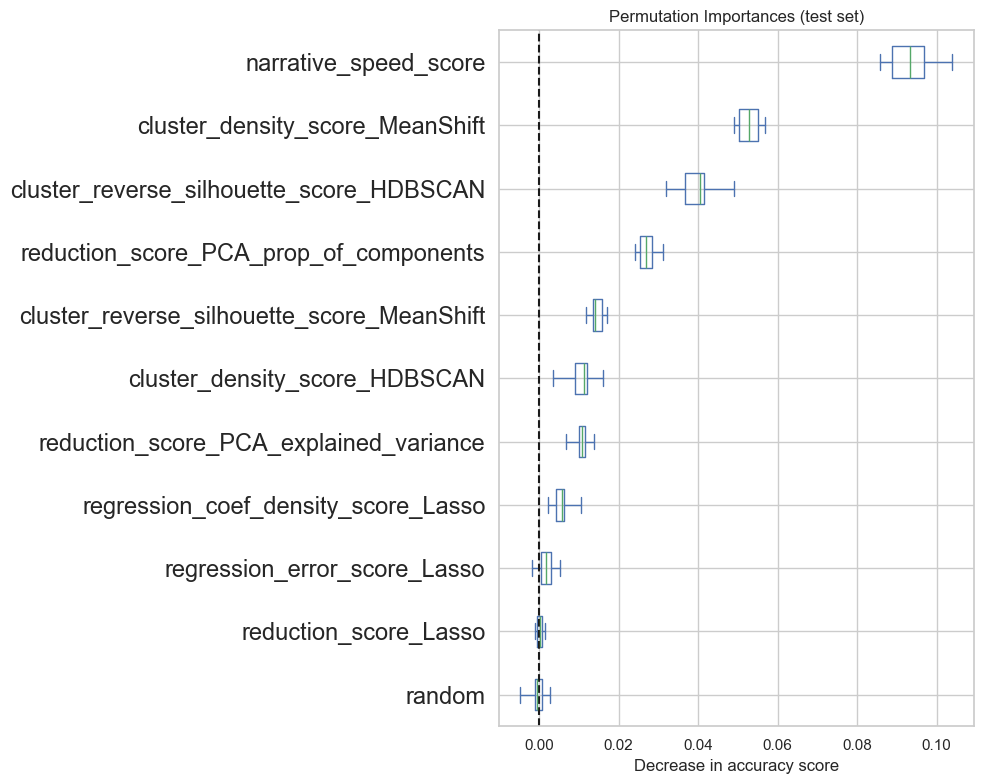

########################################
Training with std_sim_metrics
Accuracy: 0.37368668652971615
F1 Score: 0.37124804810039574


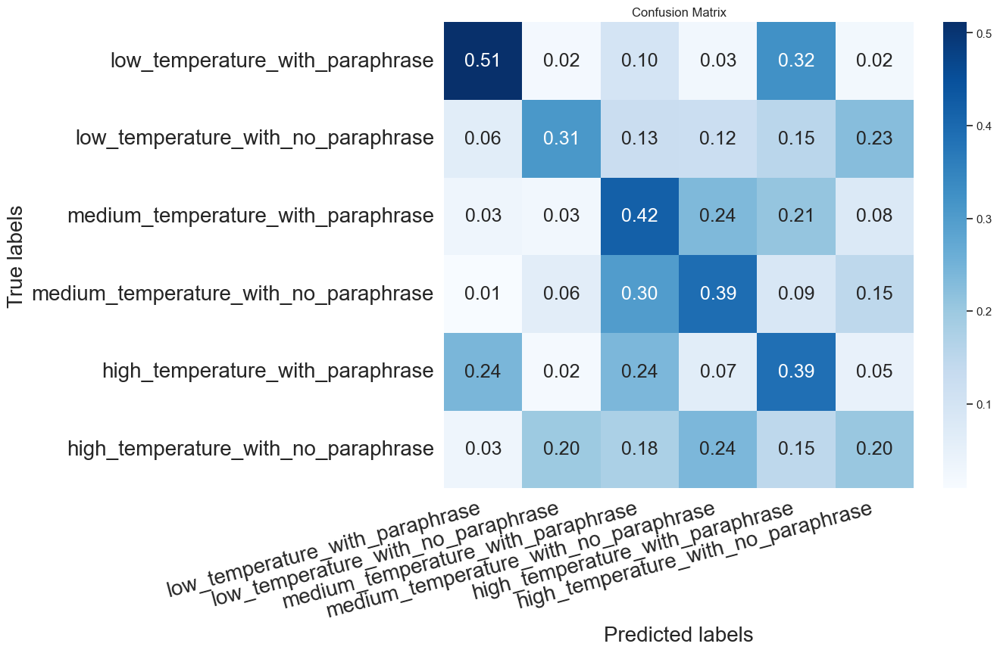

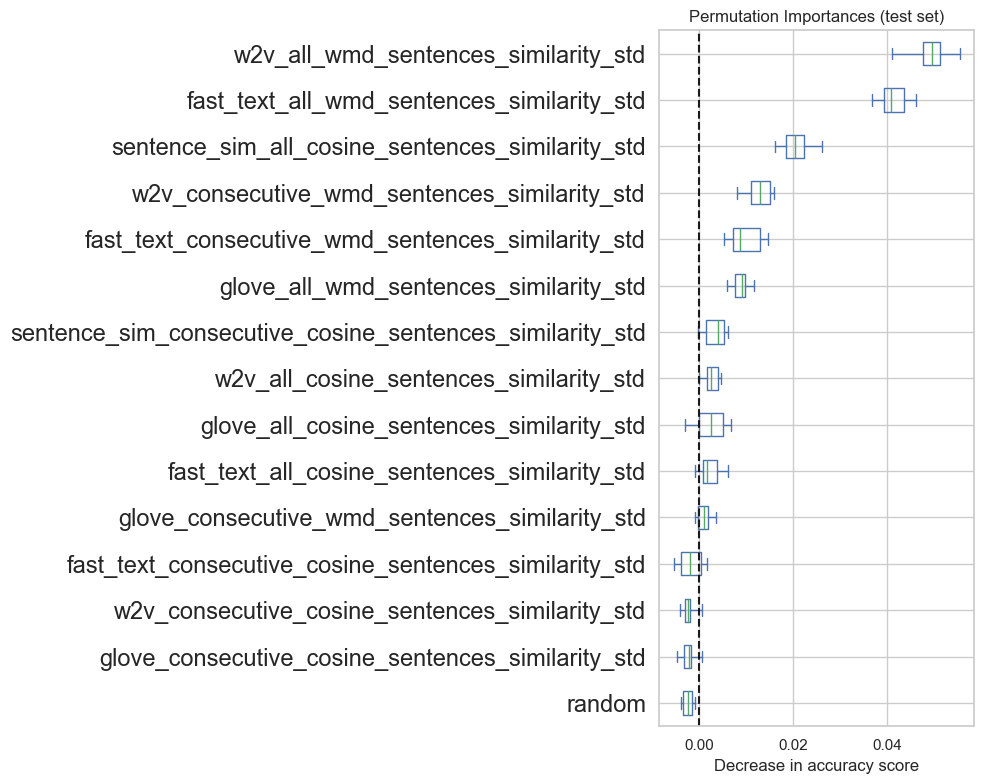

########################################
Training with all_features
Accuracy: 0.4912968480476713
F1 Score: 0.48754650727807447


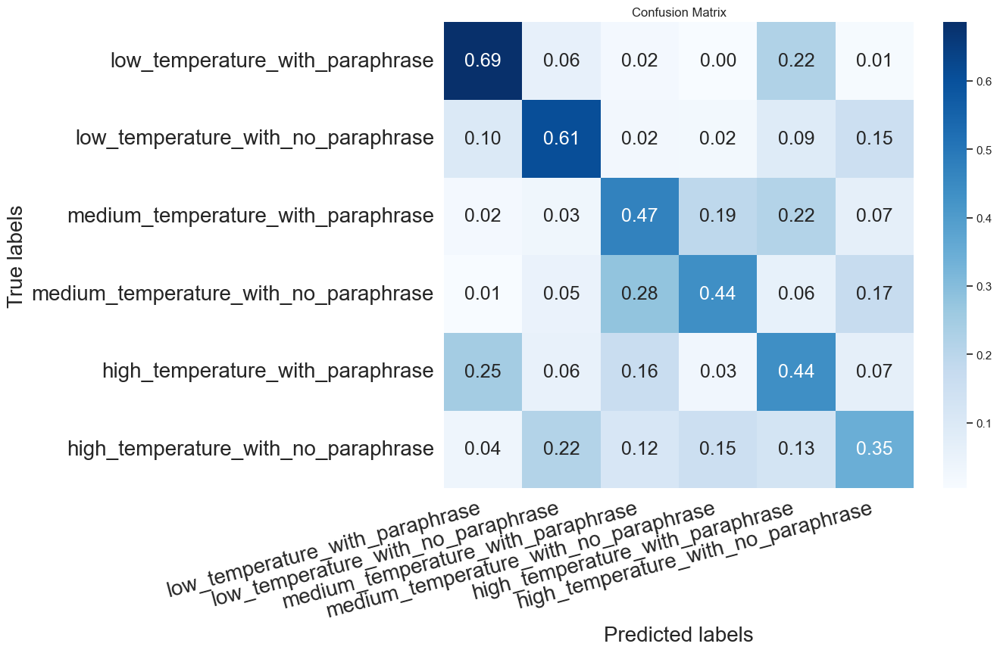

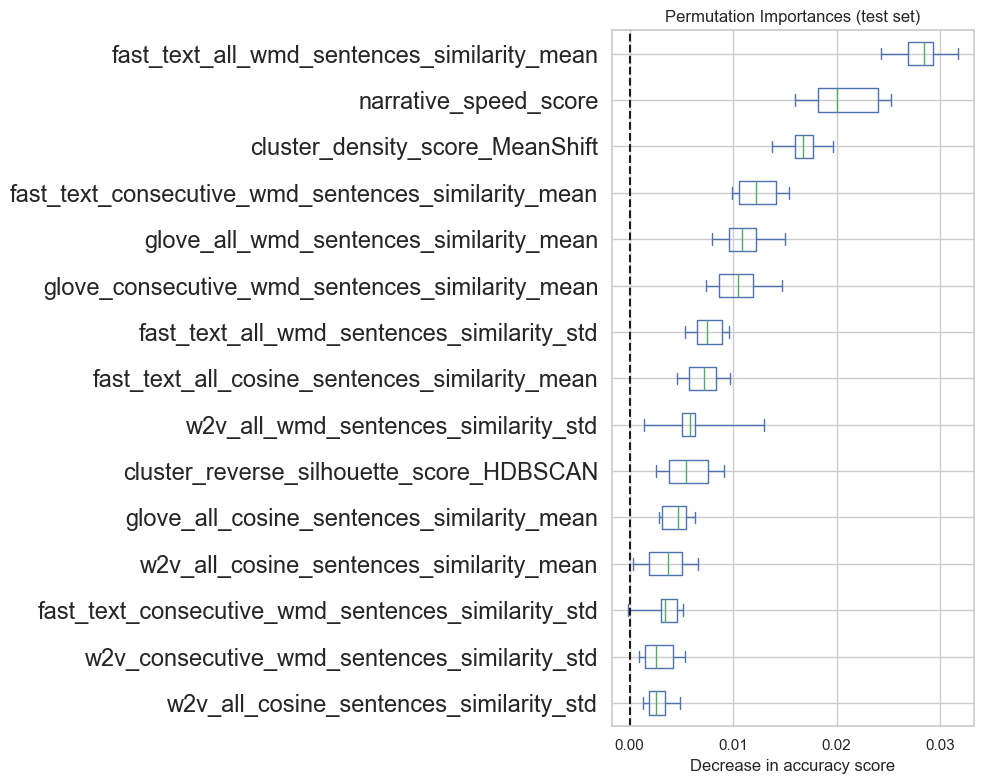

########################################
Training with best_features
Accuracy: 0.4718519680100361
F1 Score: 0.4660313457381907


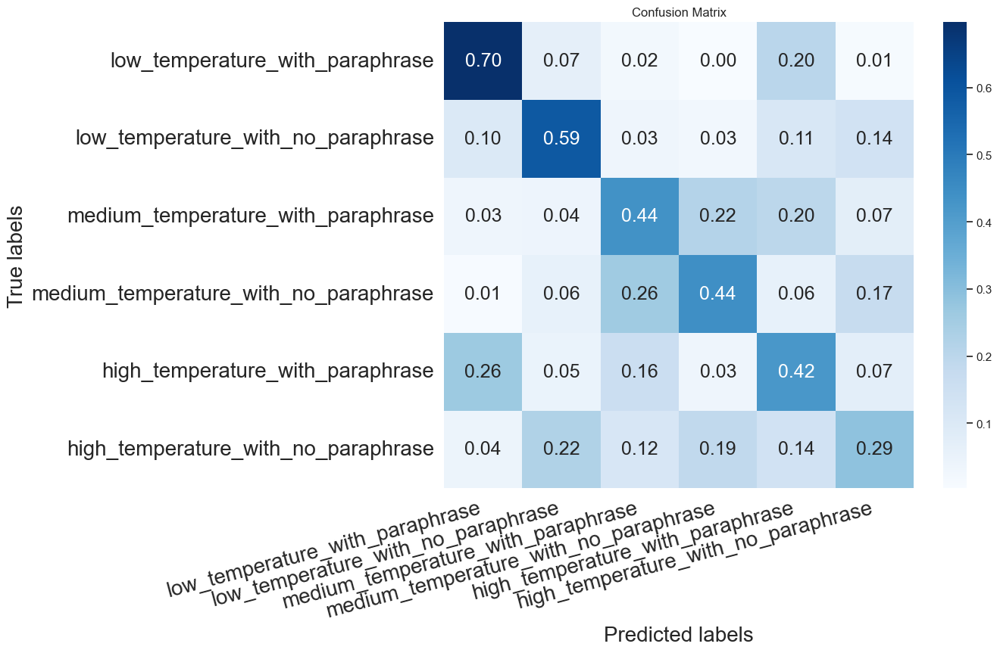

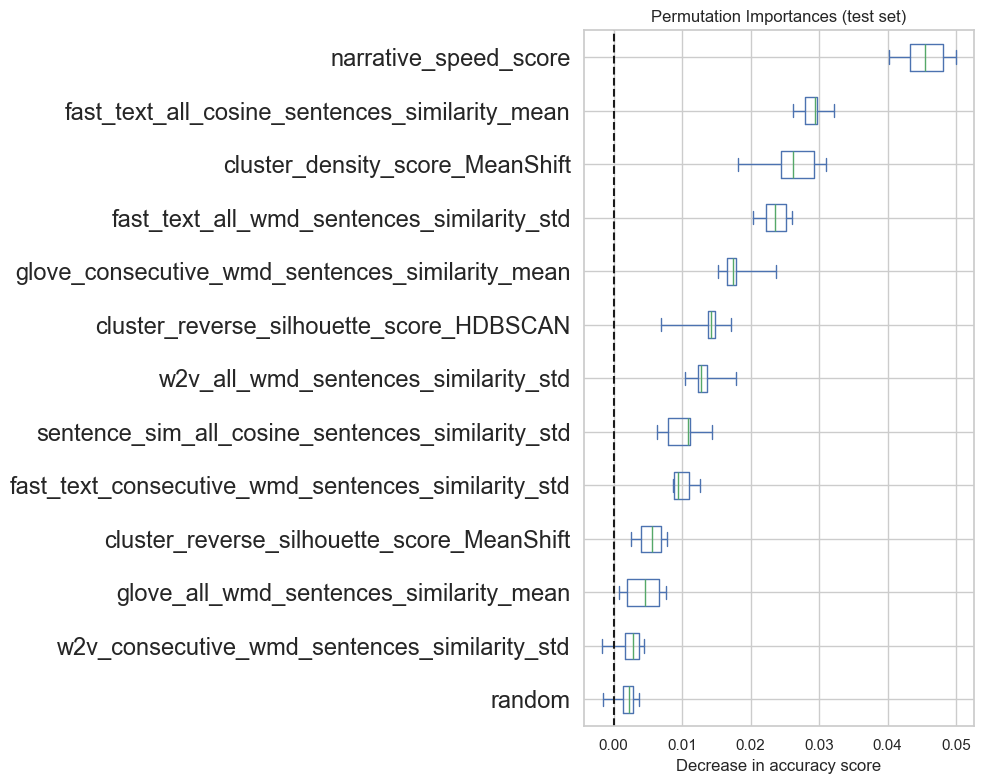

########################################
Training with semantic_contribution
Accuracy: 0.2610945585698604
F1 Score: 0.23538950395707214


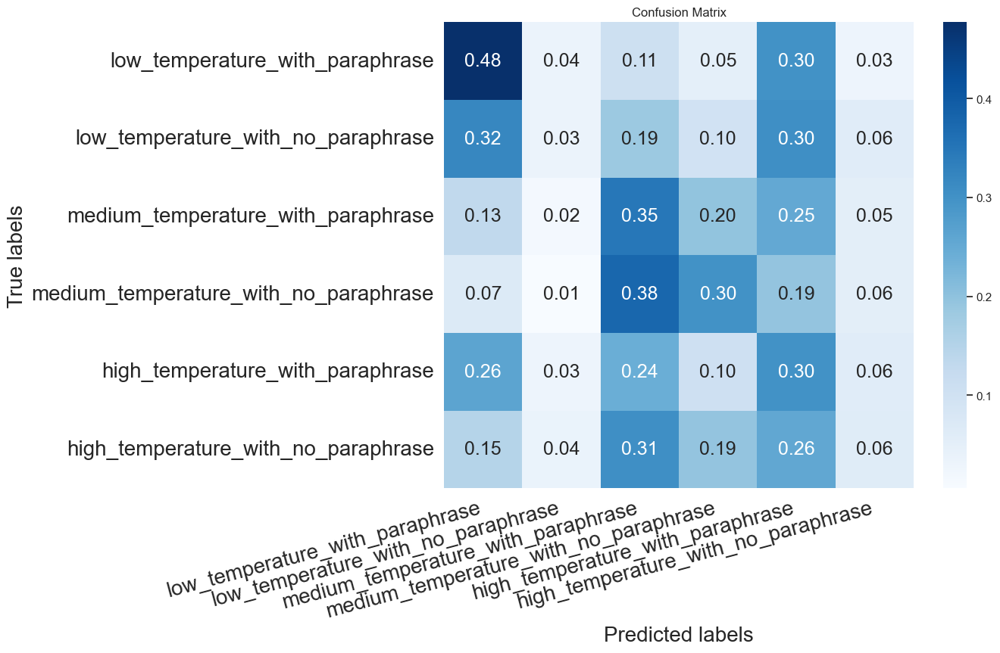

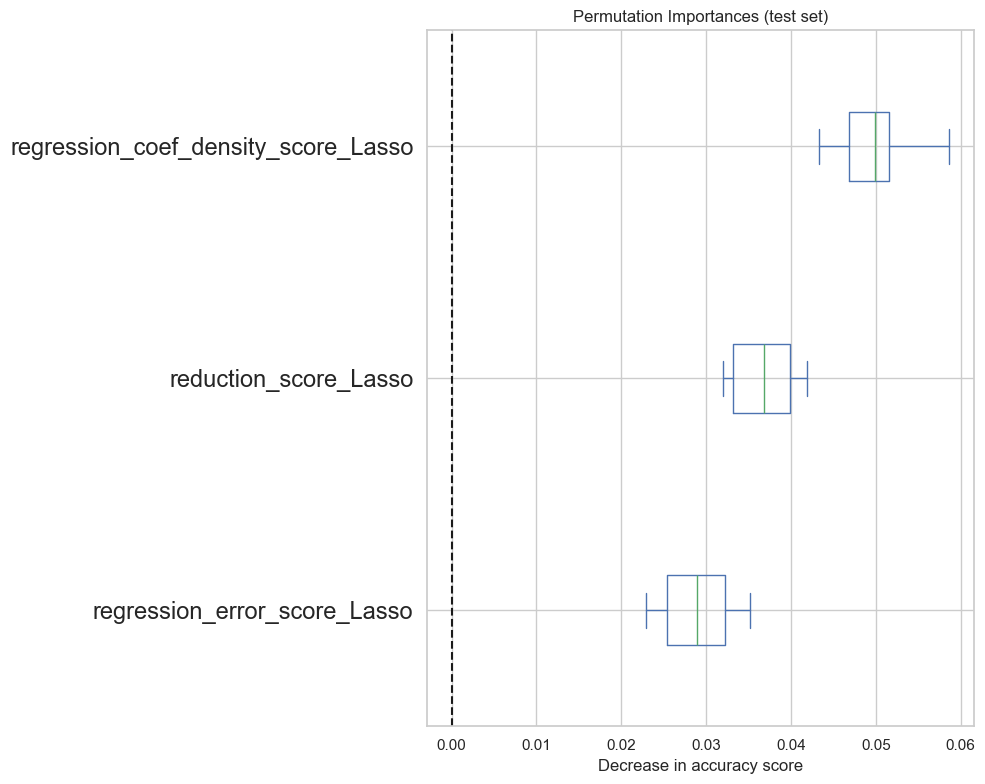

########################################
Training with structural_density
Accuracy: 0.37525482201662225
F1 Score: 0.3661169031758866


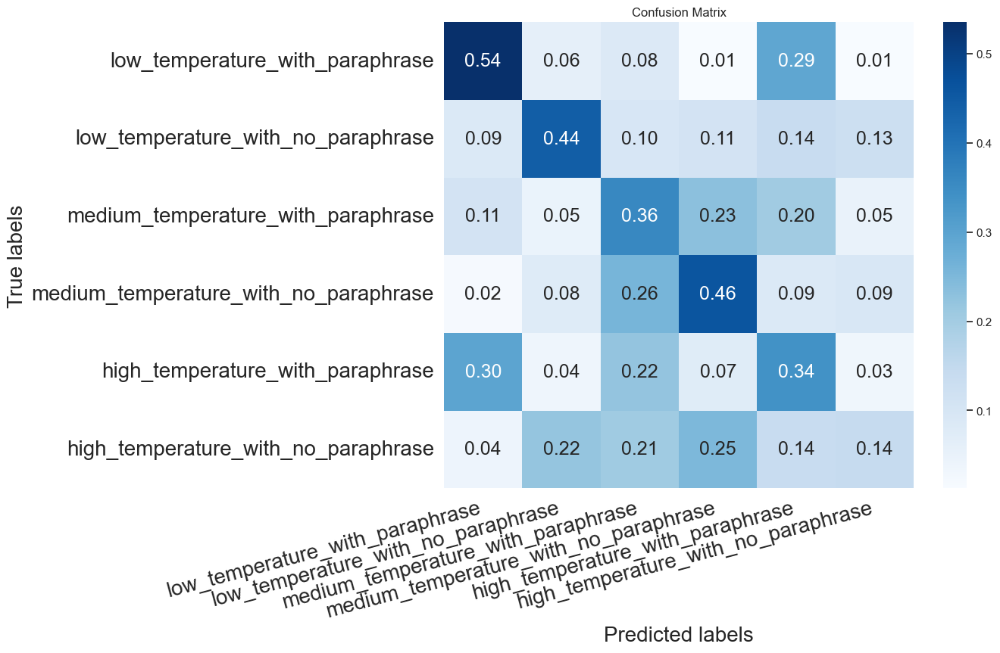

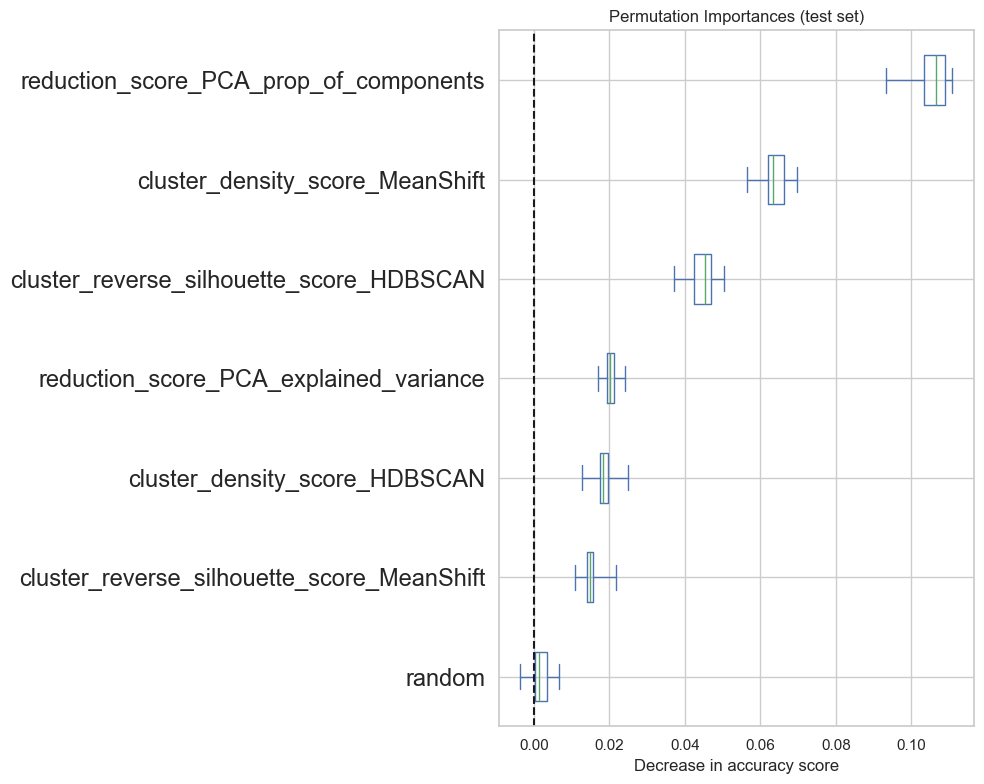

########################################
Training with average_features
Accuracy: 0.3959542104437823
F1 Score: 0.3908284356208809


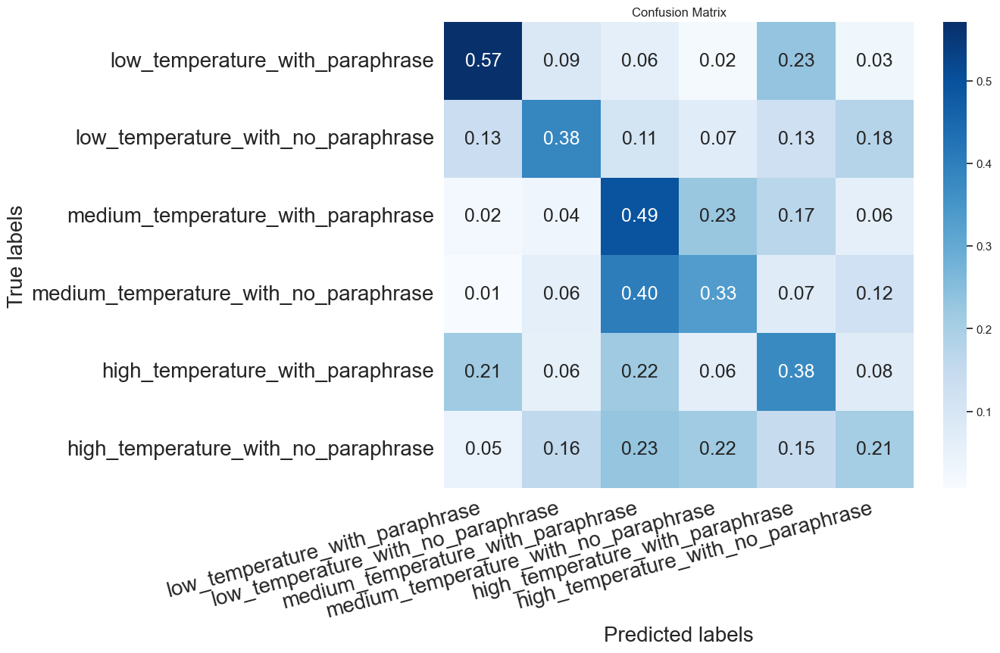

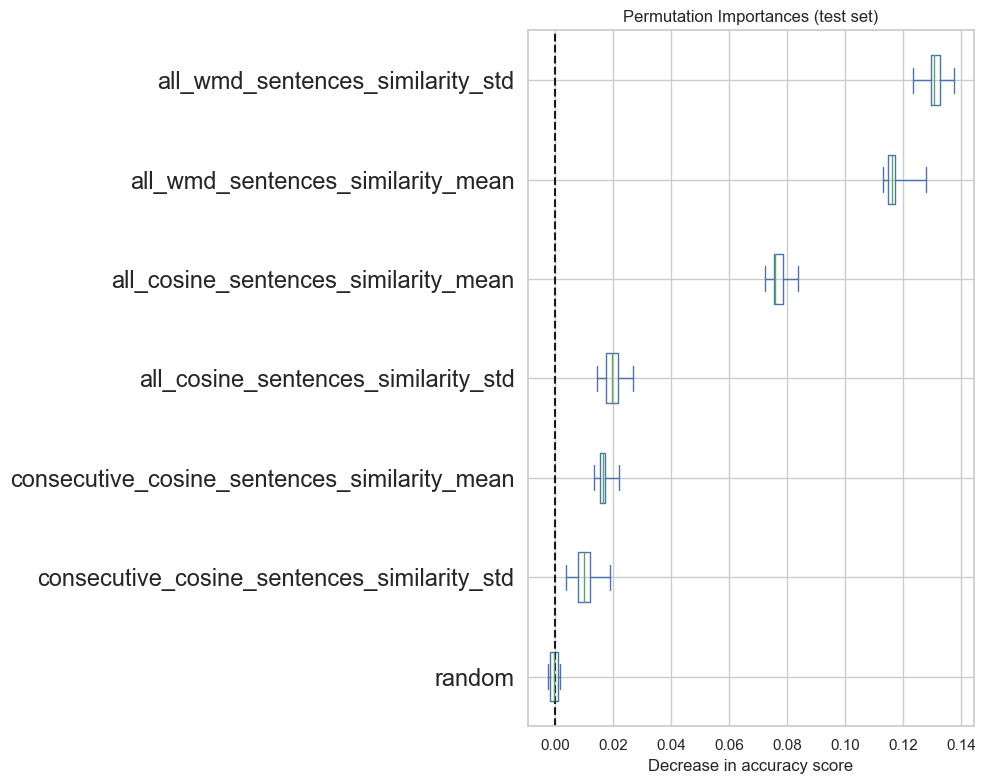

########################################
Training with average_and_structural_density
Accuracy: 0.4337462756782186
F1 Score: 0.4249160355820792


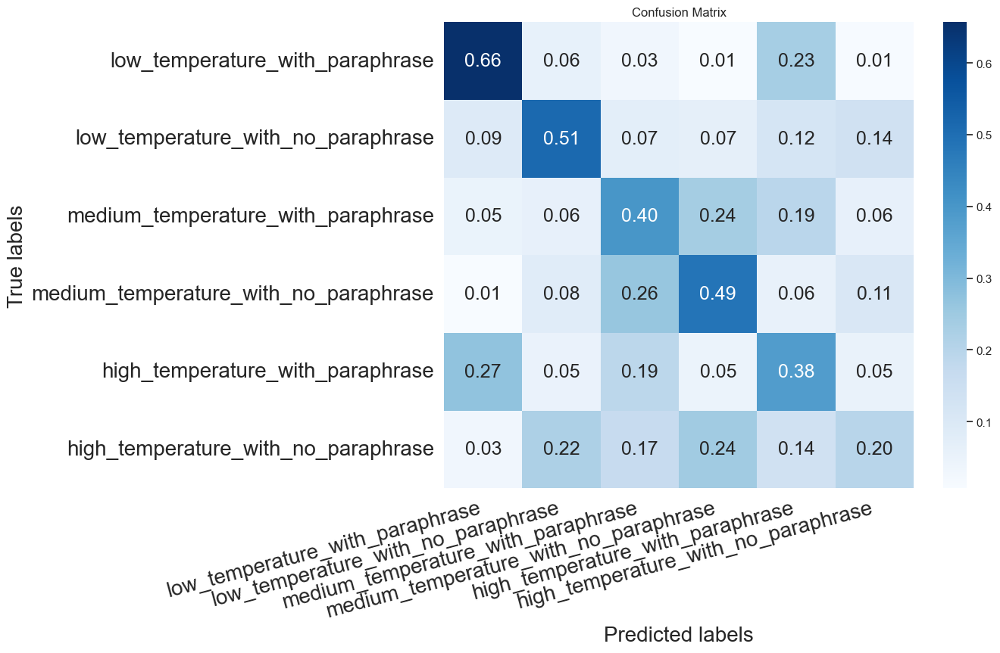

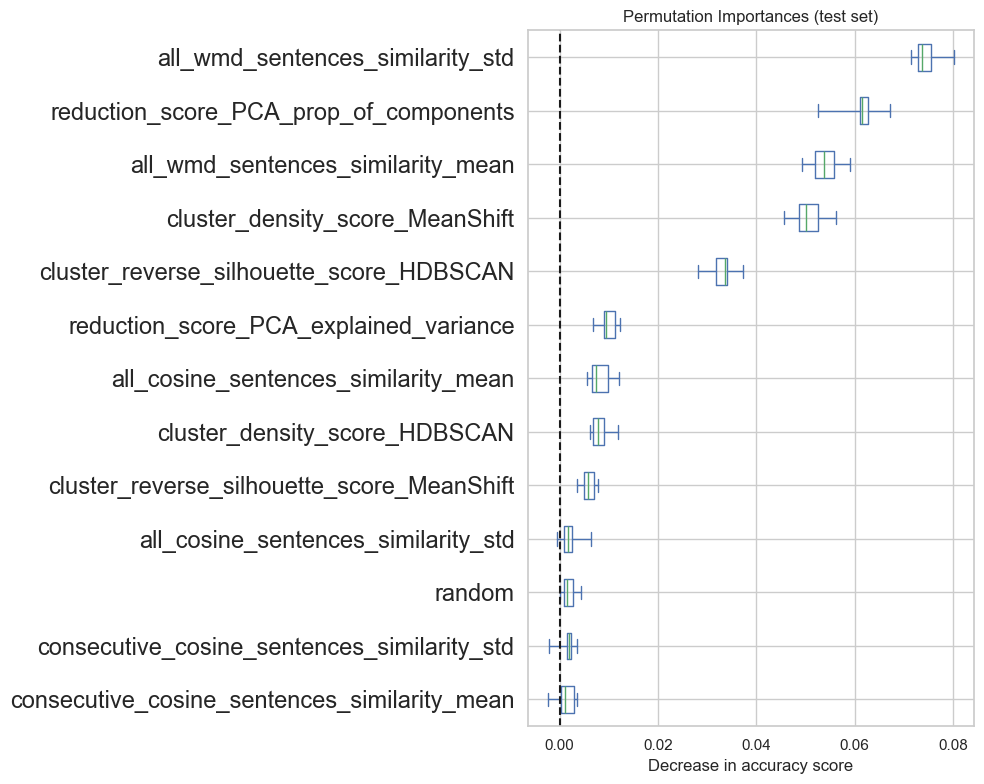

########################################
Training with narrative_speed
Accuracy: 0.28602791281166695
F1 Score: 0.25554940226999573


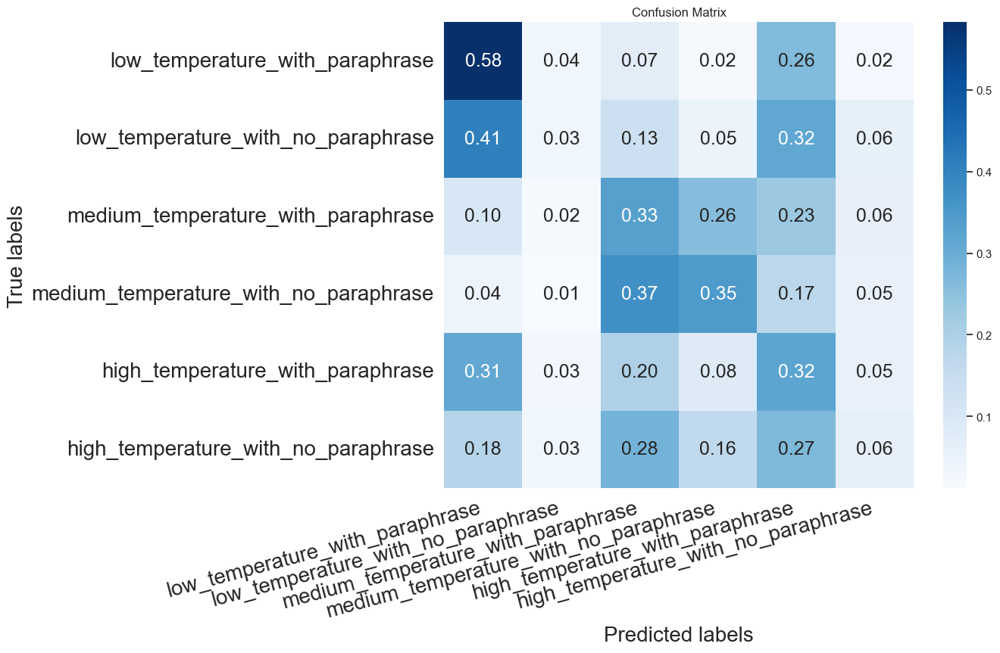

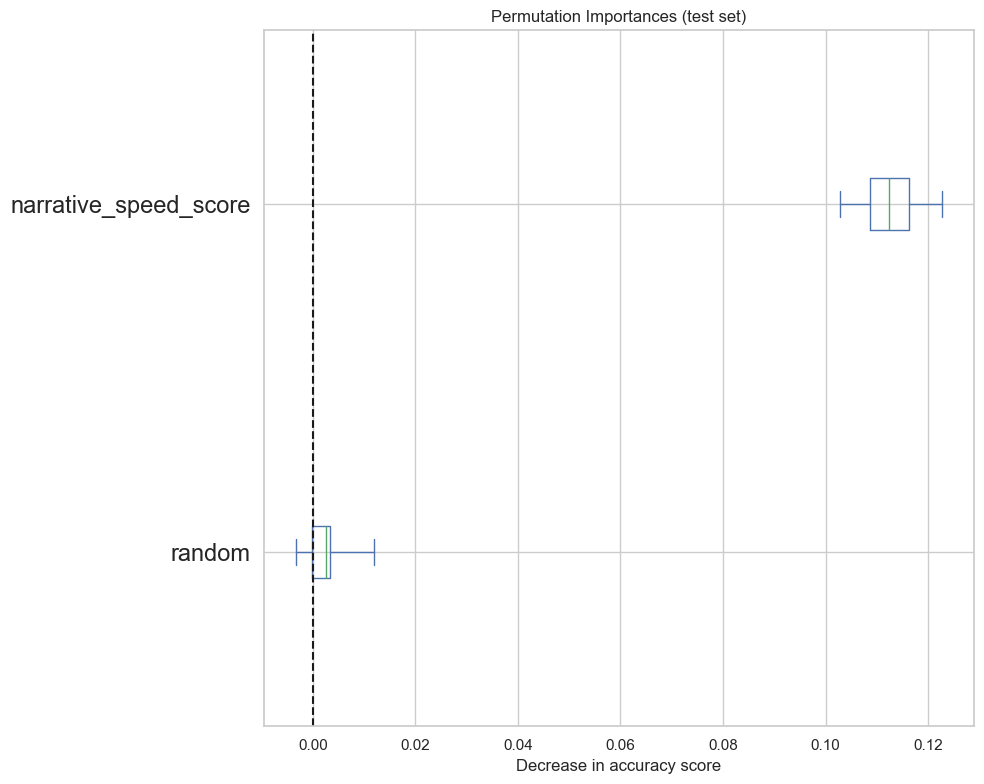

,features_name,accuracy,f1_score
7,all_features,0.491297,0.487547
8,best_features,0.471852,0.466031
12,average_and_structural_density,0.433746,0.424916
11,average_features,0.395954,0.390828
5,density_features,0.389995,0.382655
4,mean_sim_metrics,0.381214,0.372102
6,std_sim_metrics,0.373687,0.371248
10,structural_density,0.375255,0.366117
3,wmd_std_sim_metrics,0.343735,0.341848
2,wmd_mean_sim_metrics,0.301239,0.281863


In [48]:
df_results = train_and_evaluate_rf(features_dict, best_parameters_dict, dataset, y_name="cat_label", num_to_label = num_to_label, plot = plot)
df_results.sort_values(by = "f1_score", ascending = False)
df_results[['features_name','accuracy','f1_score']].sort_values(by = "f1_score", ascending = False)

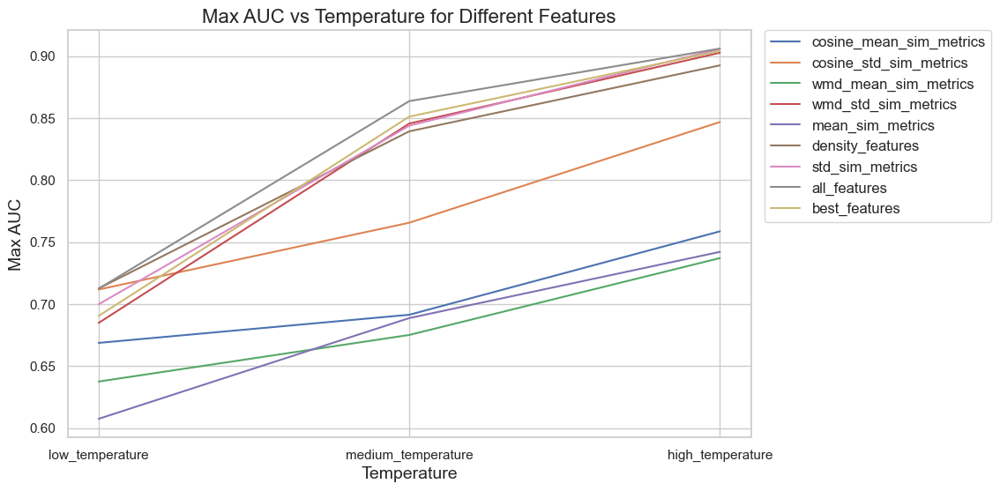

In [50]:
print(list(num_to_label.keys()))

[0, 1, 2, 3, 4, 5]


In [53]:
psm_dataset = filter_dataset(dataset,filter_name =  "psm")
y_name = "has_paraphrase"
psm_dataset['cat_label'] = psm_dataset[y_name]
print(list(num_to_label.keys()))

df_results = train_and_evaluate_xgb(features_dict, psm_dataset, y_name="cat_label", num_to_label = num_to_label)

Number of samples before and after PSM: 6317 -> 5405
[0, 1, 2]
########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.5899942495687176
F1 Score: 0.5900308666577815


ValueError: Number of classes, 2, does not match size of target_names, 3. Try specifying the labels parameter

[0, 1]
########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.5478502080443828
F1 Score: 0.5457621821959693


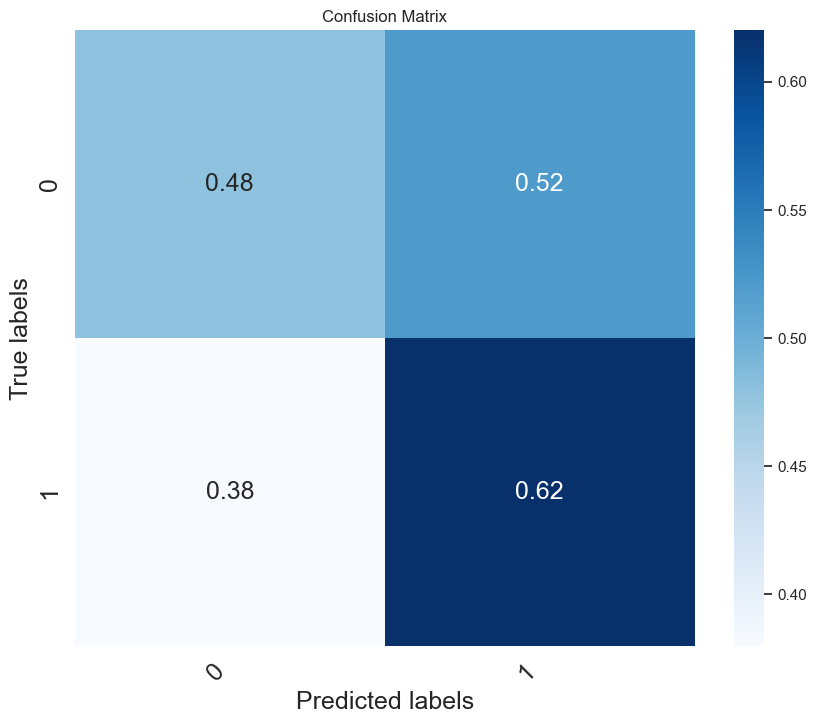

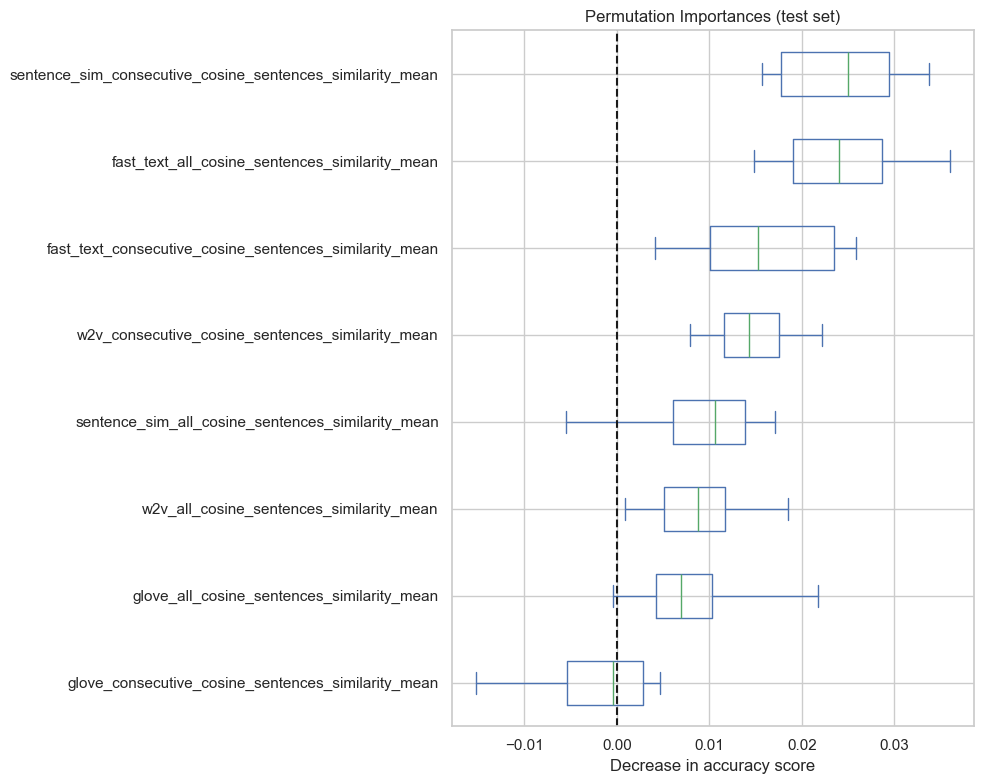

########################################
Training with cosine_std_sim_metrics
Accuracy: 0.584835876098012
F1 Score: 0.5848866357335438


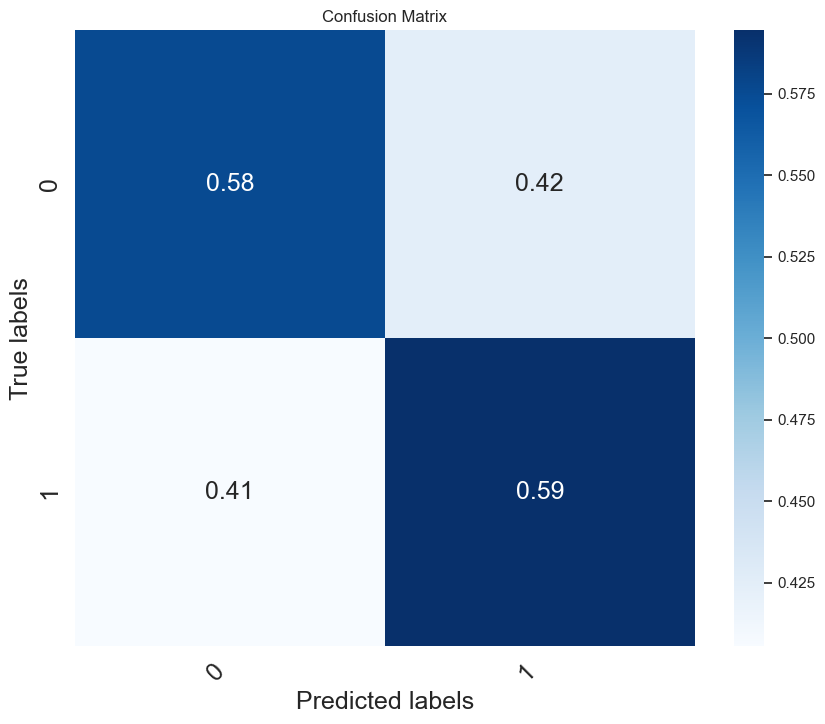

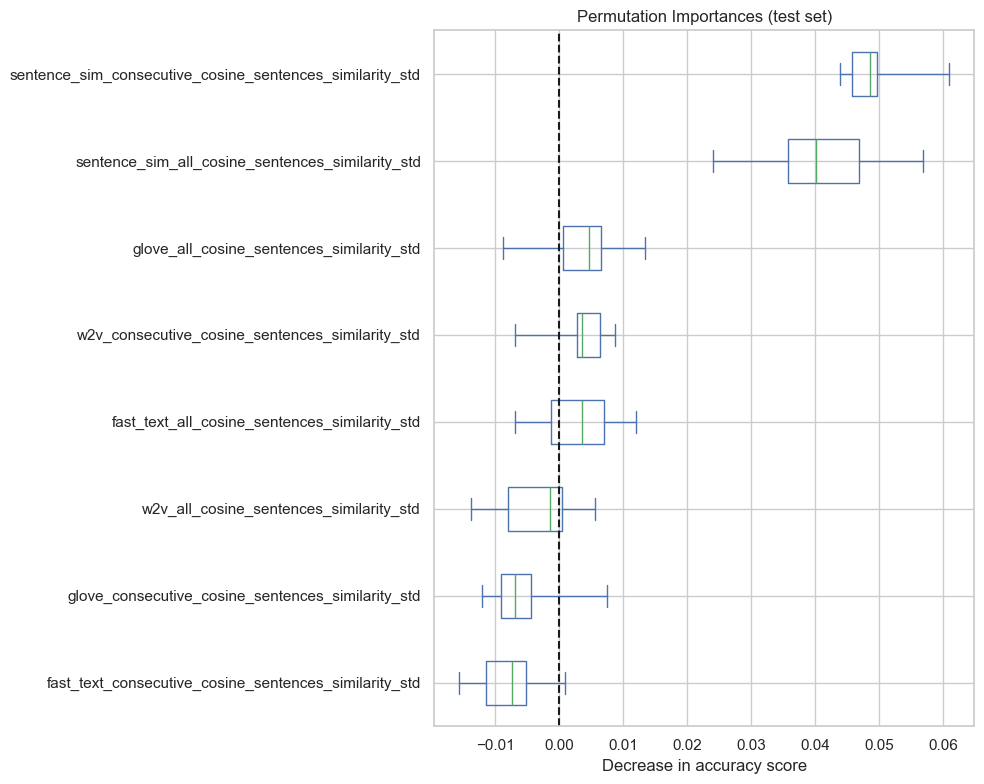

########################################
Training with wmd_mean_sim_metrics
Accuracy: 0.5922330097087378
F1 Score: 0.5923020536076558


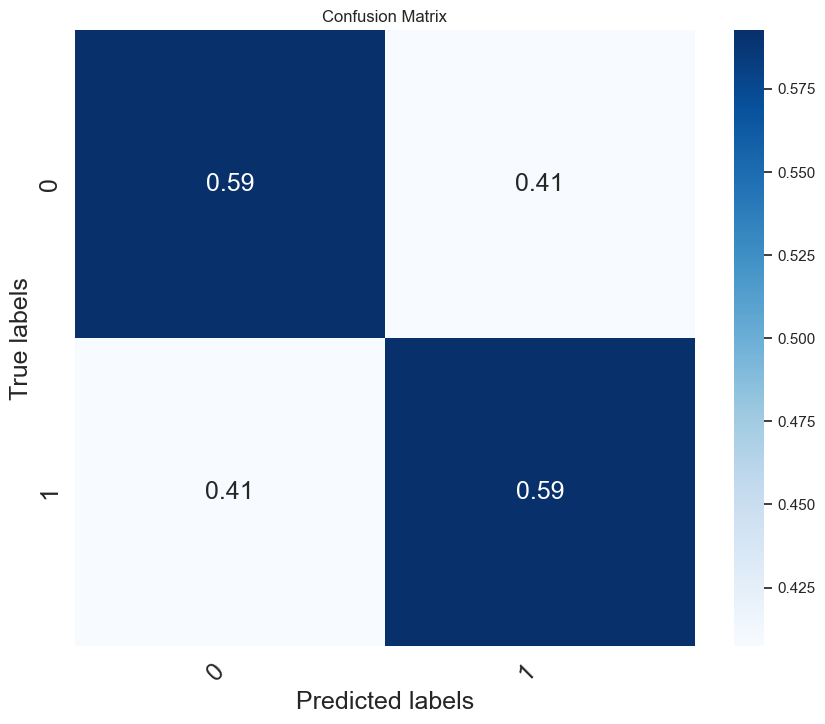

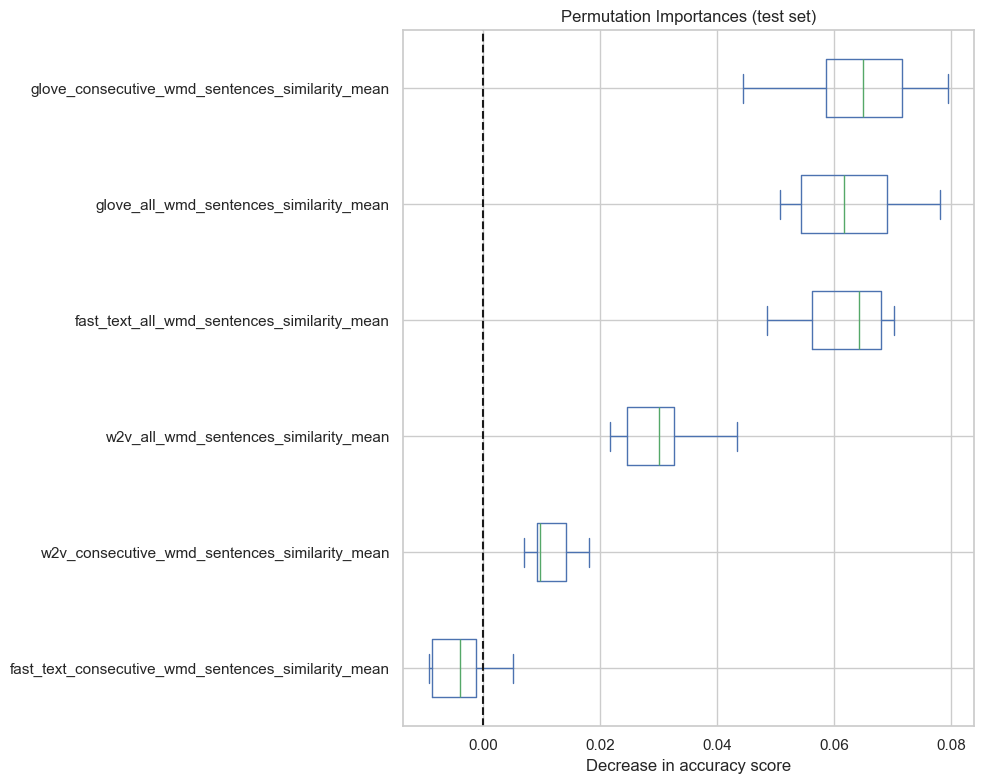

########################################
Training with wmd_std_sim_metrics
Accuracy: 0.6213592233009708
F1 Score: 0.6202641189761843


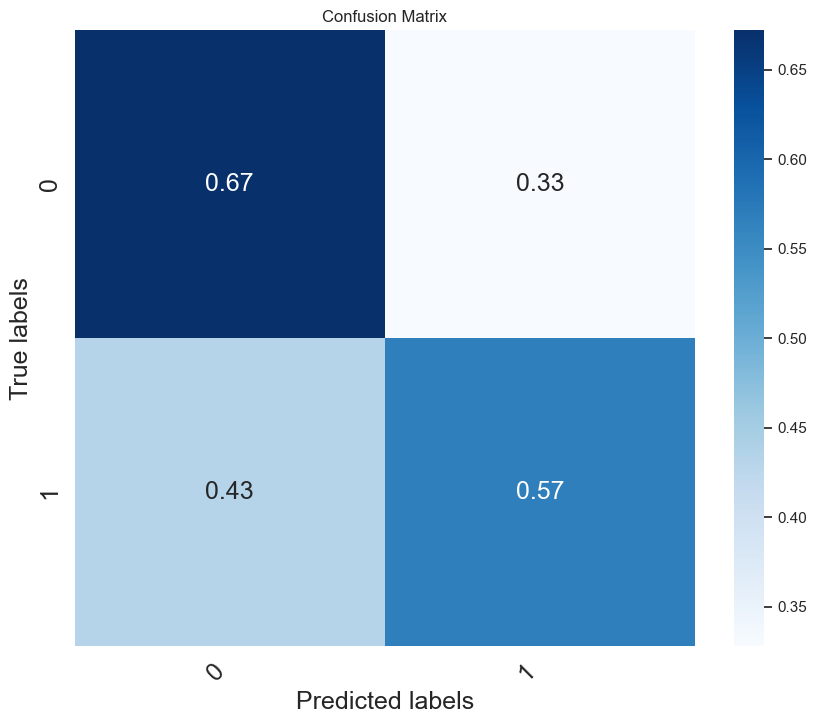

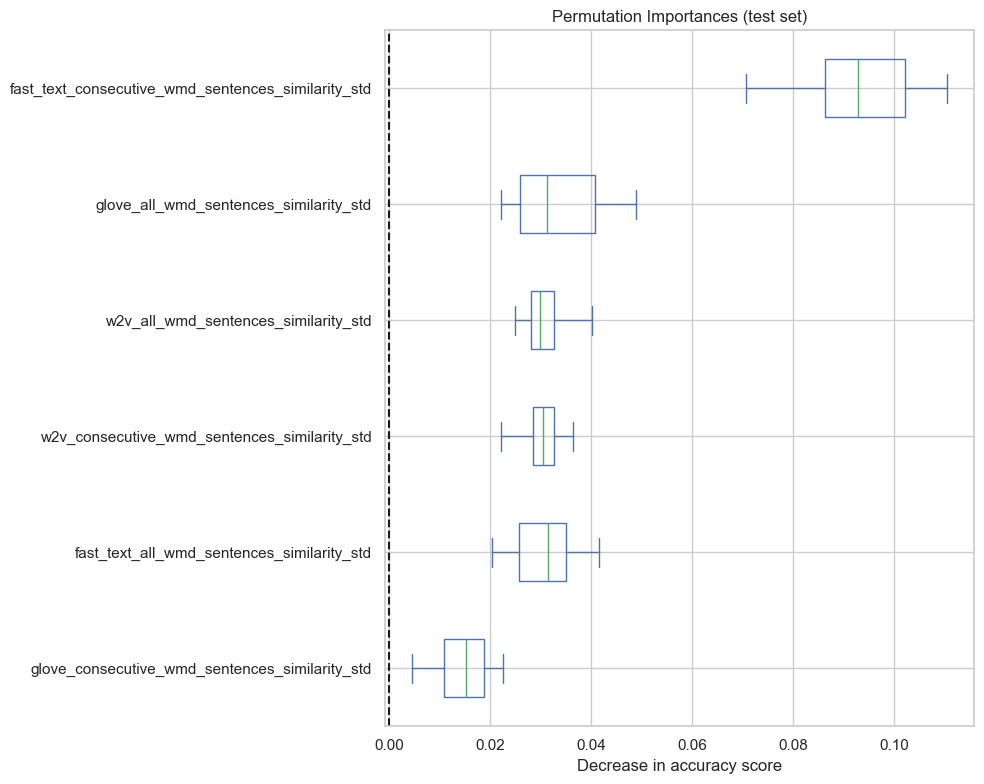

########################################
Training with mean_sim_metrics
Accuracy: 0.6675913083680074
F1 Score: 0.6623851607319967


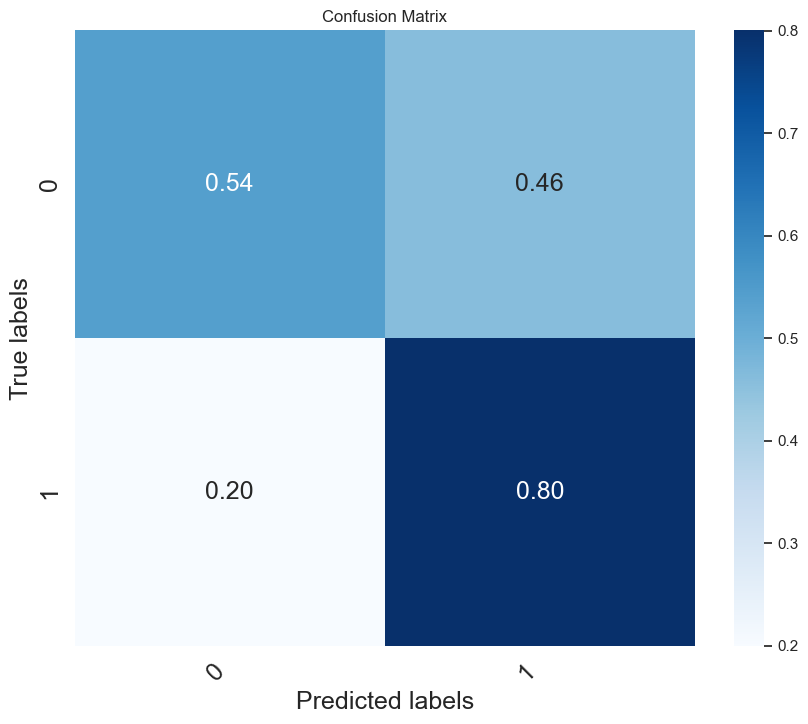

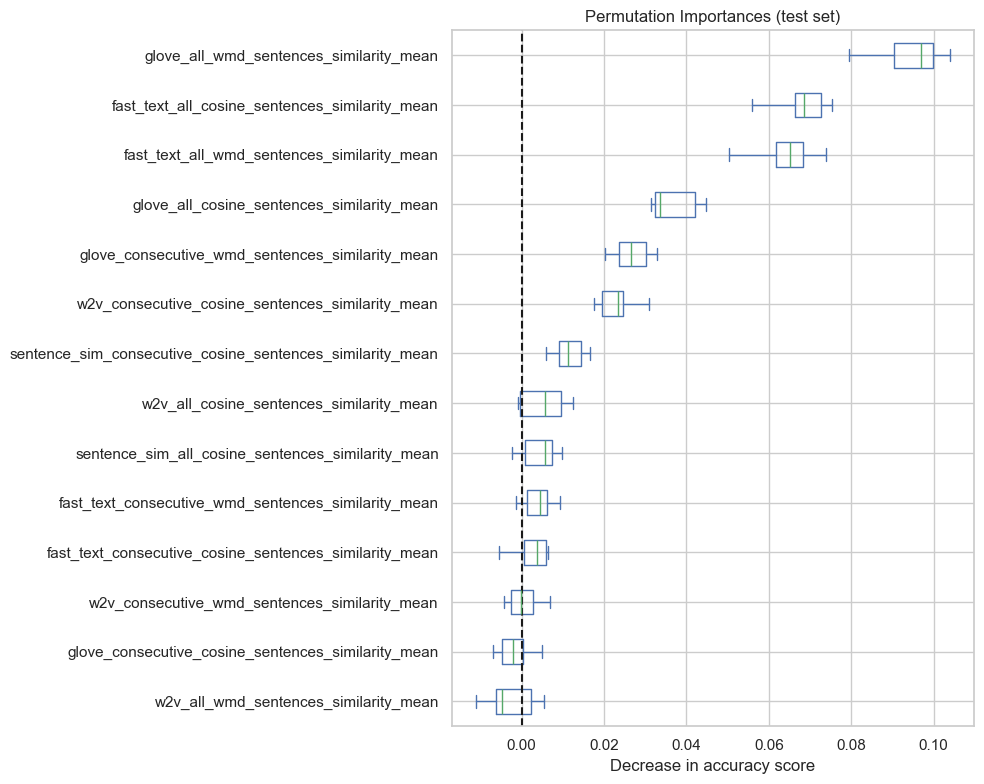

########################################
Training with density_features
Accuracy: 0.6403143781784558
F1 Score: 0.6403758899232432


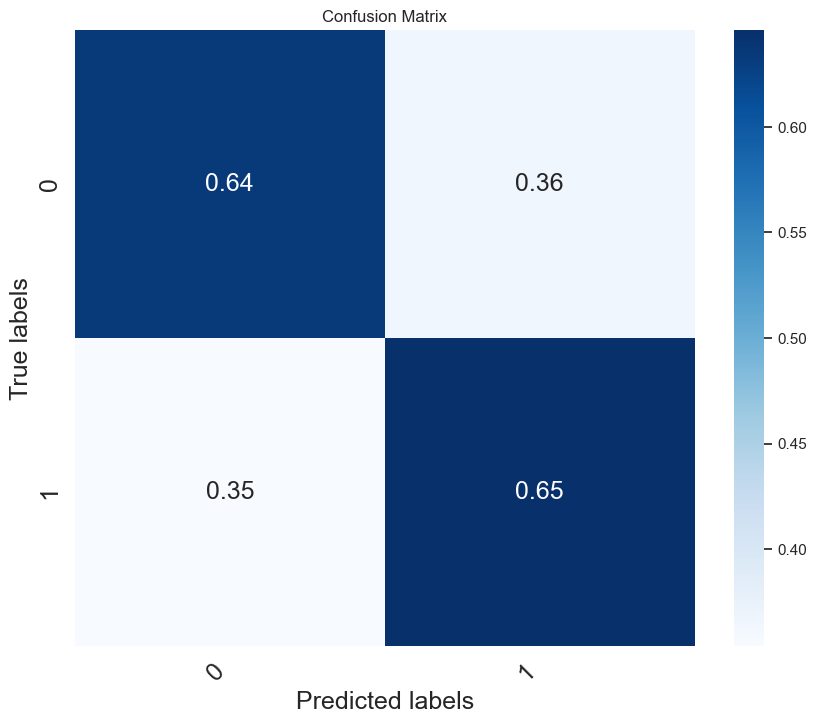

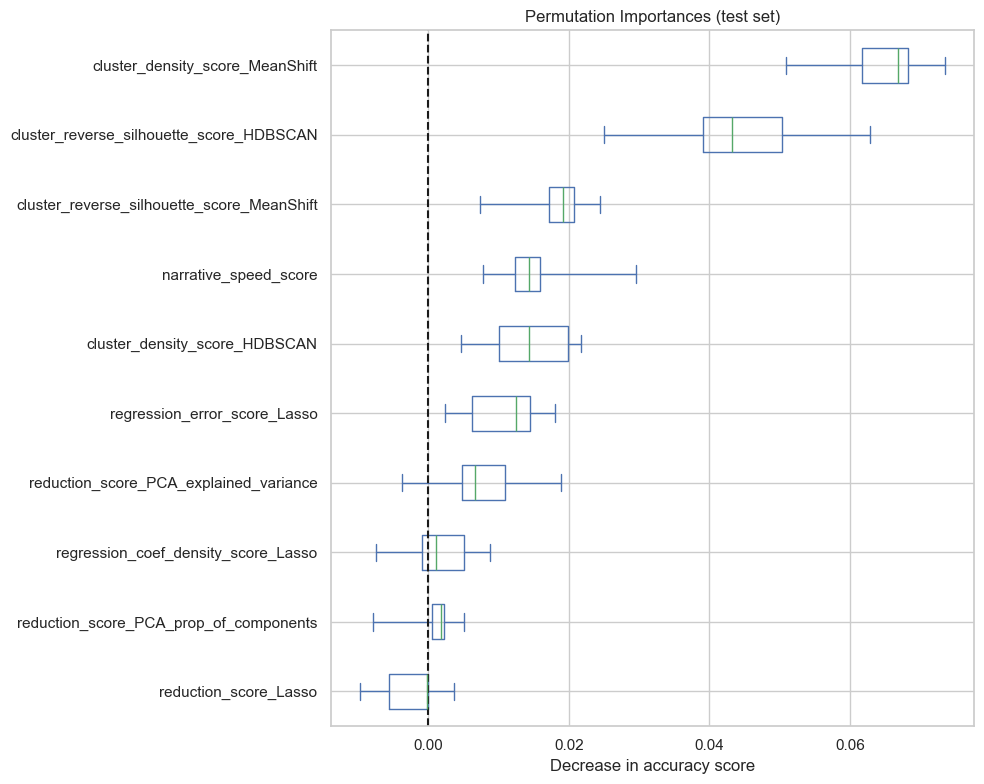

########################################
Training with std_sim_metrics
Accuracy: 0.6472491909385113
F1 Score: 0.6471401828638363


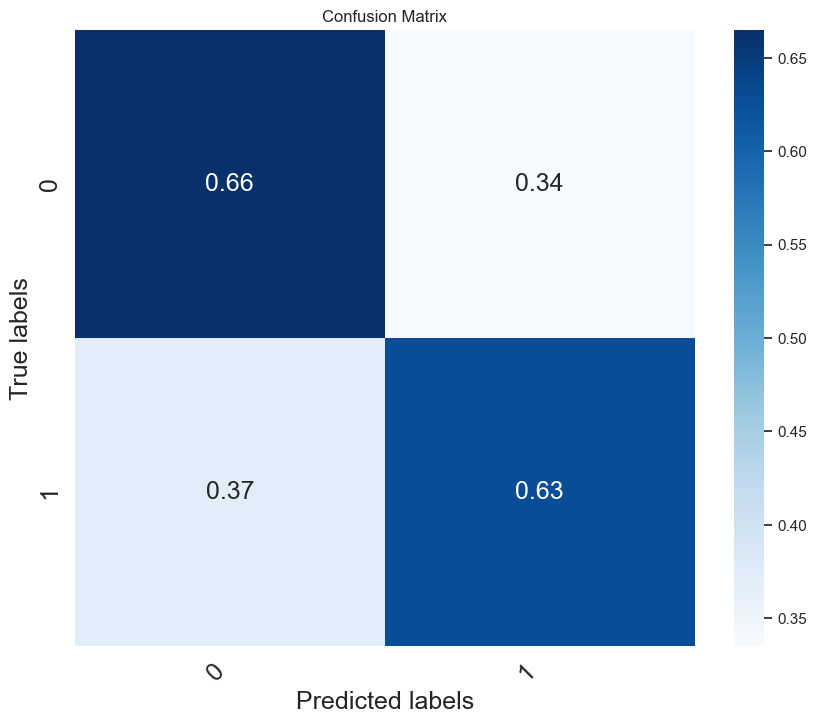

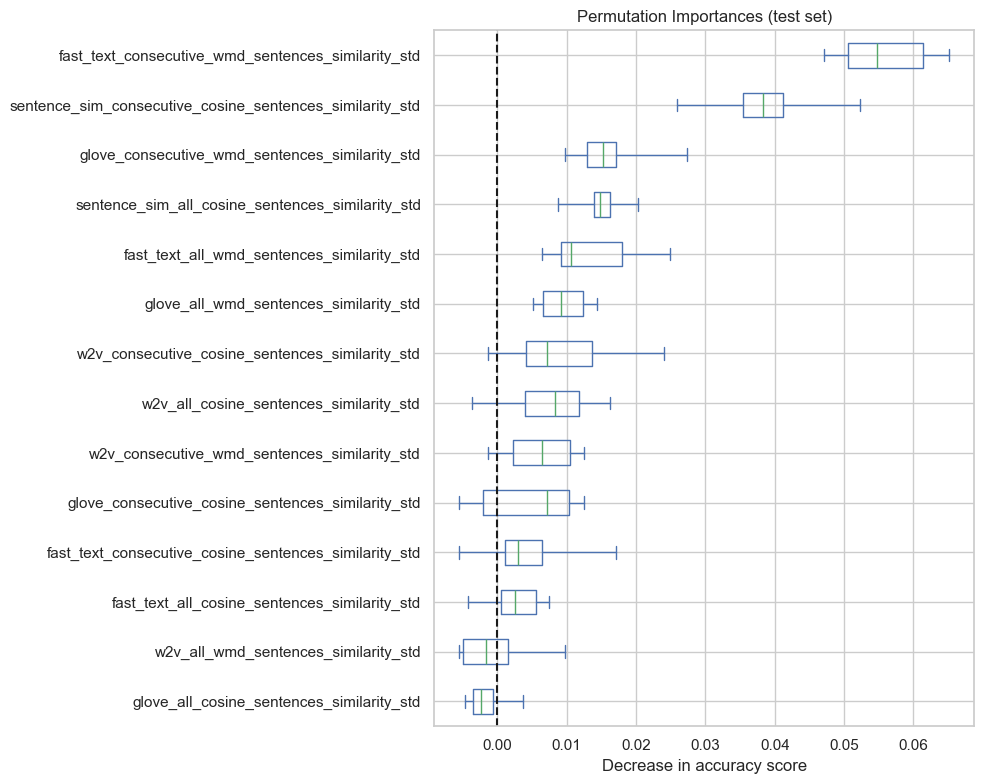

########################################
Training with all_features
Accuracy: 0.7831715210355987
F1 Score: 0.7828123105446835


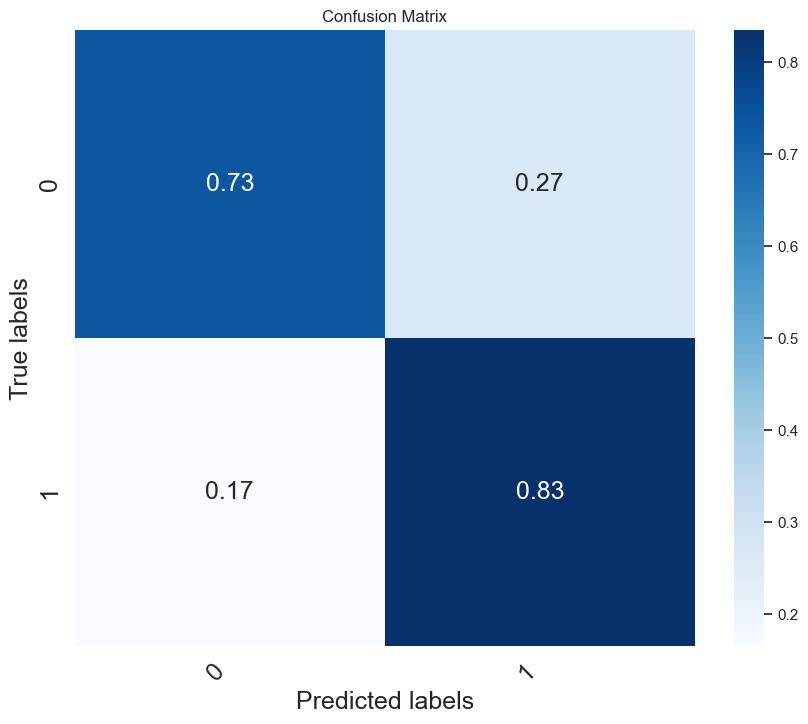

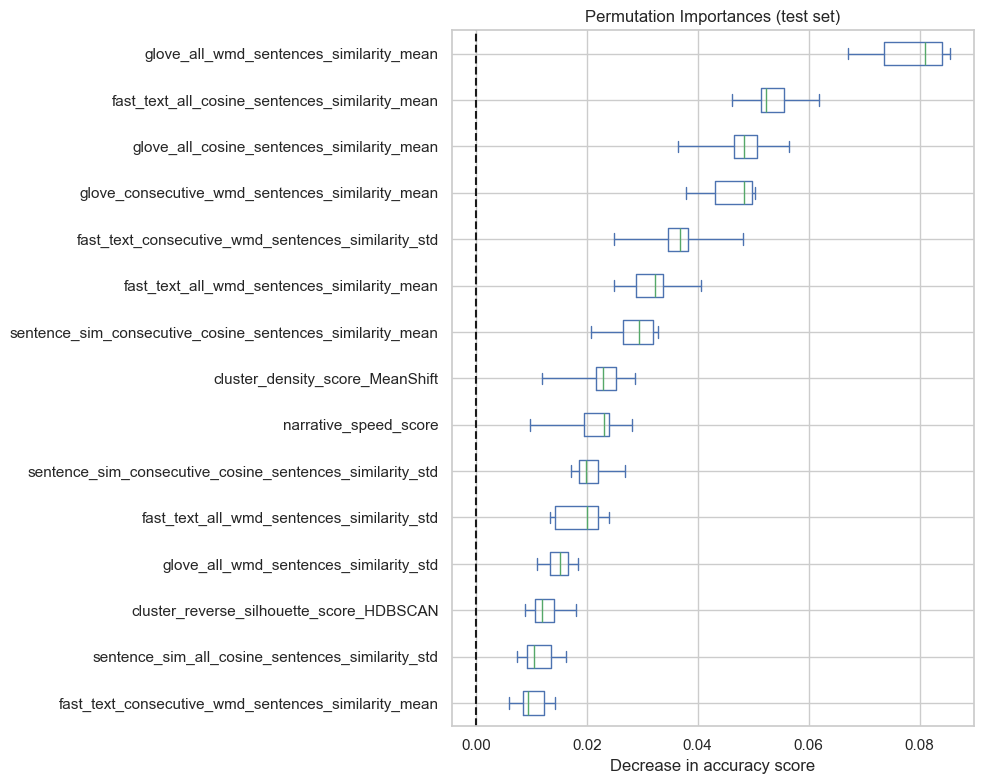

########################################
Training with best_features
Accuracy: 0.7374017568192326
F1 Score: 0.7361205683613908


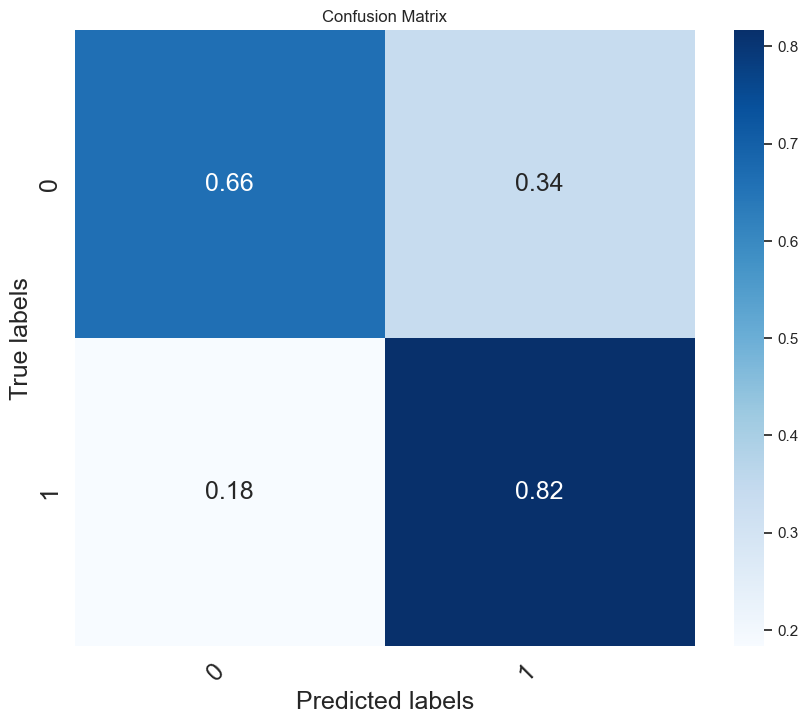

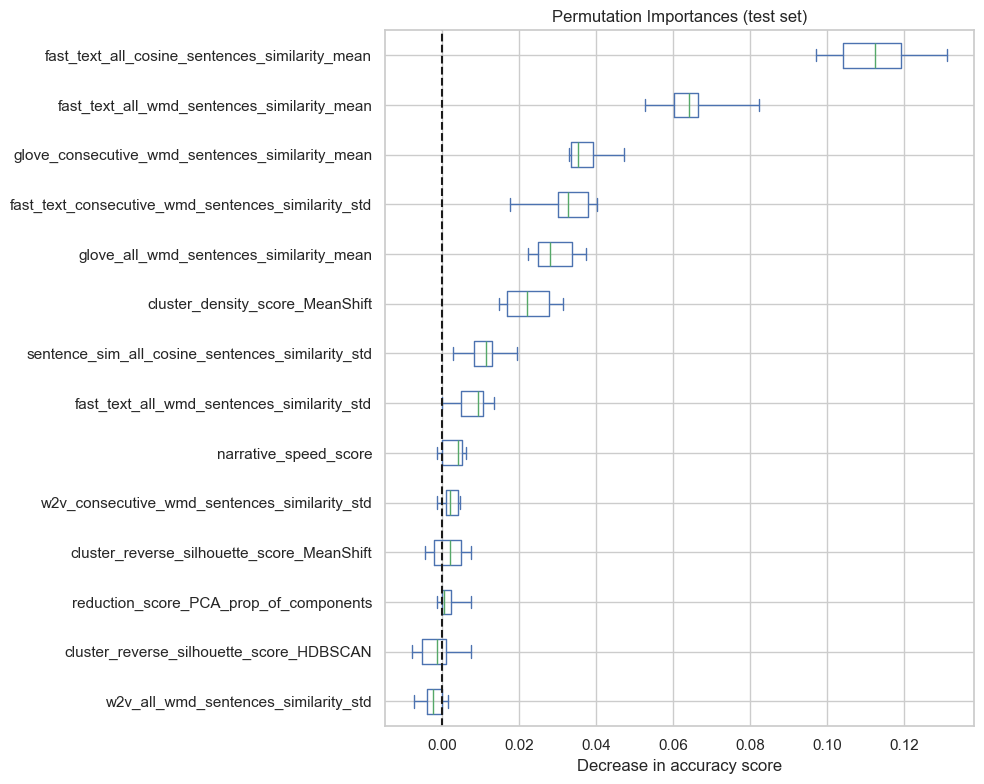

In [233]:
label_encoded_dict = {k:i for i,k in enumerate(dataset[target].unique())}
num_to_label = {v: k for k, v in label_encoded_dict.items()}

dataset['cat_label'] = dataset[target].map(label_encoded_dict)

#dataset = dataset[dataset.had_paraphrase==0].reset_index(drop=True)
#dataset['cat_label'] = dataset['combined_label'].astype('category').cat.codes
print(list(num_to_label.keys()))
#train_and_evaluate_rf(features_dict, best_parameters_dict, dataset, y_name = "cat_label")
df_results = train_and_evaluate_xgb(features_dict, dataset, y_name="cat_label", num_to_label = num_to_label)

In [234]:
df_results

,features_name,accuracy,f1_score,confusion_matrix
0,cosine_mean_sim_metrics,0.54785,0.545762,"[[532, 578], [400, 653]]"
1,cosine_std_sim_metrics,0.584836,0.584887,"[[639, 471], [427, 626]]"
2,wmd_mean_sim_metrics,0.592233,0.592302,"[[657, 453], [429, 624]]"
3,wmd_std_sim_metrics,0.621359,0.620264,"[[746, 364], [455, 598]]"
4,mean_sim_metrics,0.667591,0.662385,"[[601, 509], [210, 843]]"
5,density_features,0.640314,0.640376,"[[705, 405], [373, 680]]"
6,std_sim_metrics,0.647249,0.64714,"[[738, 372], [391, 662]]"
7,all_features,0.783172,0.782812,"[[815, 295], [174, 879]]"
8,best_features,0.737402,0.736121,"[[735, 375], [193, 860]]"


In [230]:
df_results.to_csv('results_psm_filter_mean_cosine_sentence_sim_treatment_1.tsv', index = False,sep='\t')

In [226]:
dataset[dataset['cat_label'].isna()].combined_label.value_counts()

combined_label
medium_temperature_with_paraphrase    2331
Name: count, dtype: int64

In [227]:
label_encoded_dict

{'low_temperature_with_no_paraphrase': 0,
 'high_temperature_with_paraphrase': 1,
 'medium_temperature_with_paraphrase': 2}

In [189]:
dataset = data.sample(frac = 1).copy()
dataset.cat_label.value_counts()

cat_label
3.0    3641
2.0    3032
5.0    2929
0.0    2929
4.0    2703
Name: count, dtype: int64

In [52]:
dataset = data.copy()
dataset = data[data.combined_label.isin(["low_temperature_with_no_paraphrase","high_temperature_with_paraphrase"])].reset_index(drop=True)
dataset['cat_label'] = dataset['combined_label'].astype('category').cat.codes

train_and_evaluate_xgb(features_dict, dataset, y_name="cat_label")

########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.6336831584207896
F1 Score: 0.632318921786362


ValueError: Number of classes, 2, does not match size of target_names, 6. Try specifying the labels parameter

Number of samples before and after PSM: 18848 -> 7227
########################################
Training with cosine_mean_sim_metrics
Accuracy: 0.483454398708636
F1 Score: 0.4496443377515149


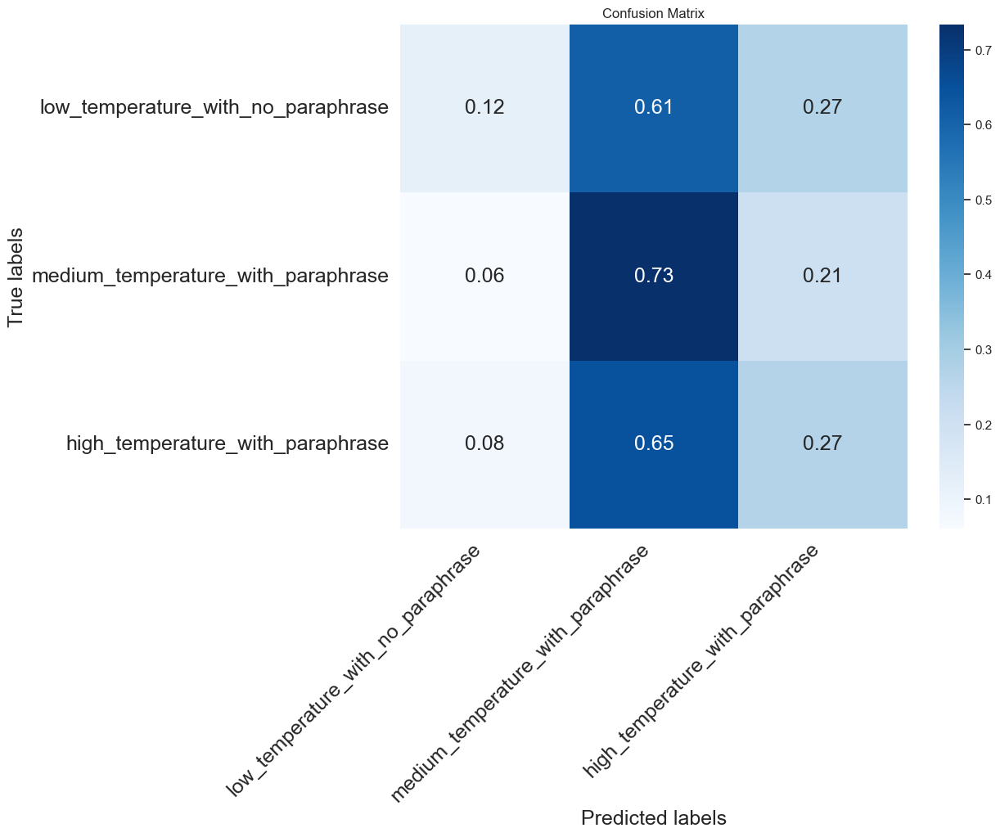

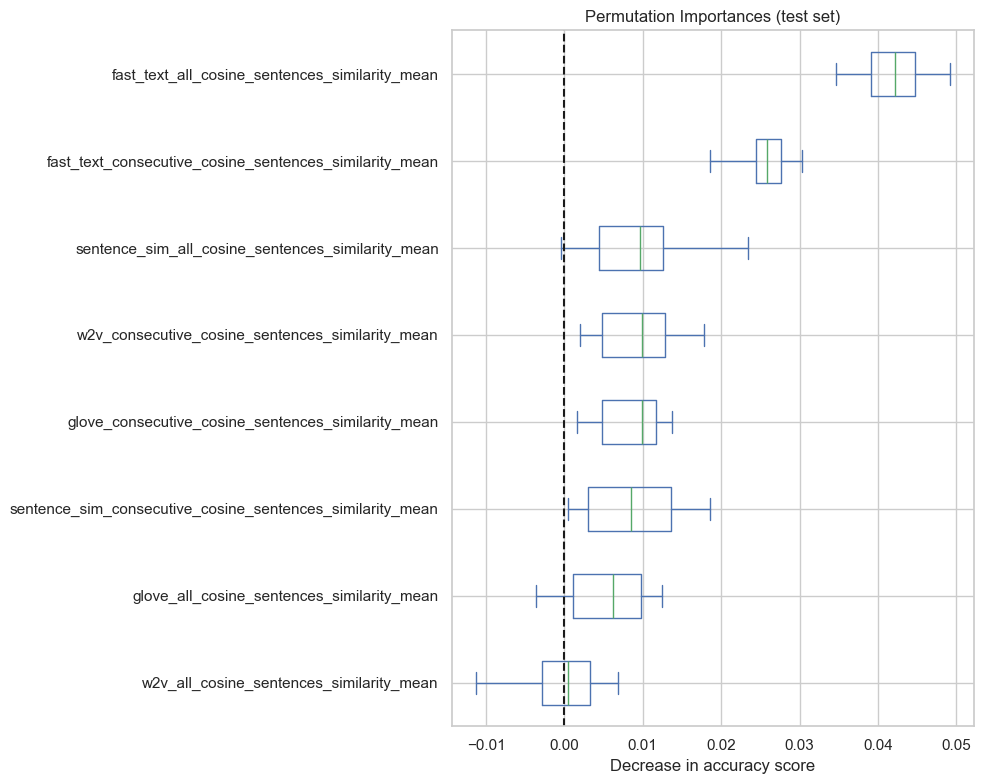

########################################
Training with cosine_std_sim_metrics
Accuracy: 0.5145278450363197
F1 Score: 0.49213110796364706


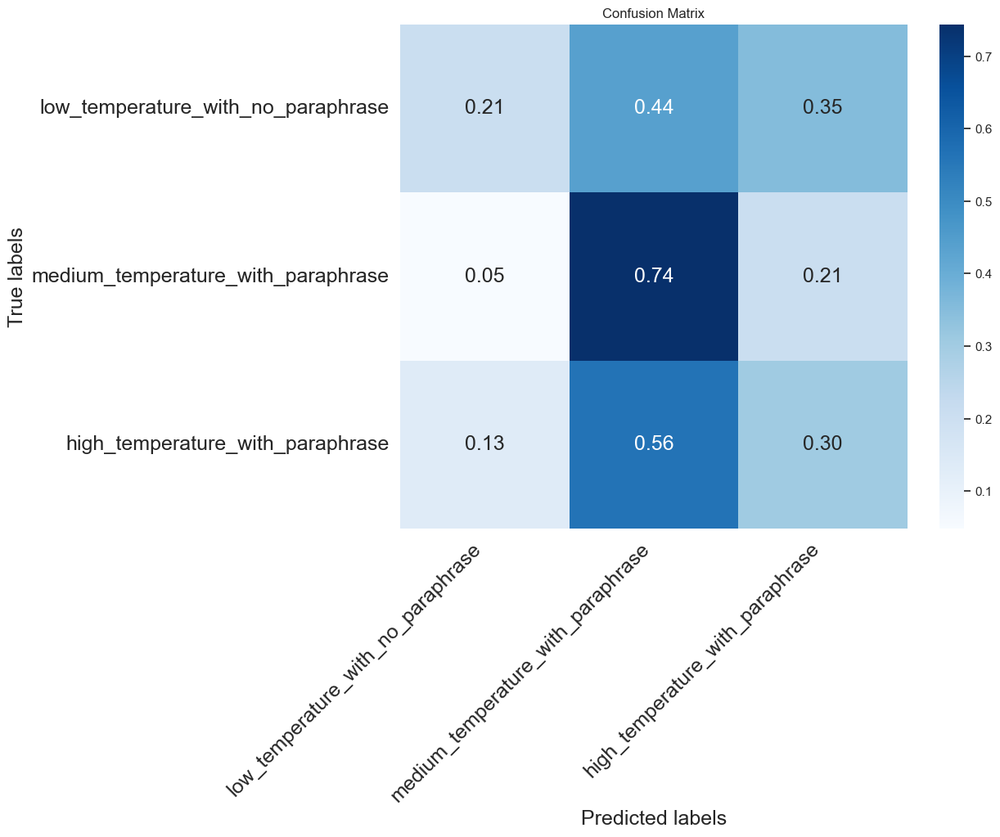

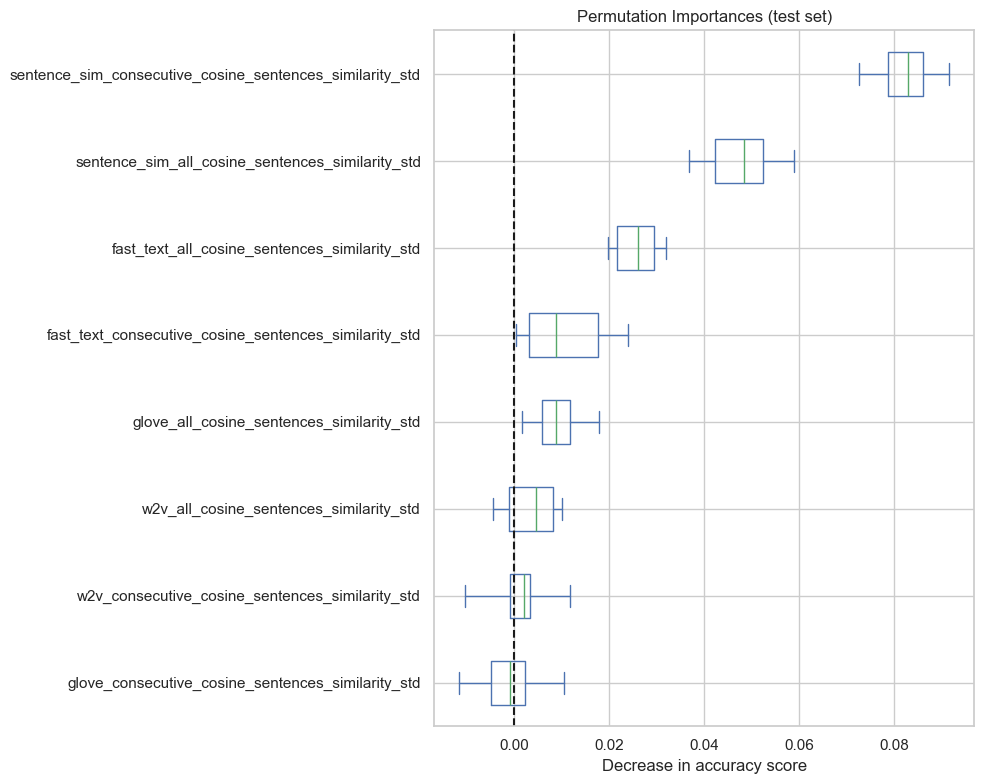

########################################
Training with wmd_mean_sim_metrics
Accuracy: 0.4600484261501211
F1 Score: 0.4655825805188242


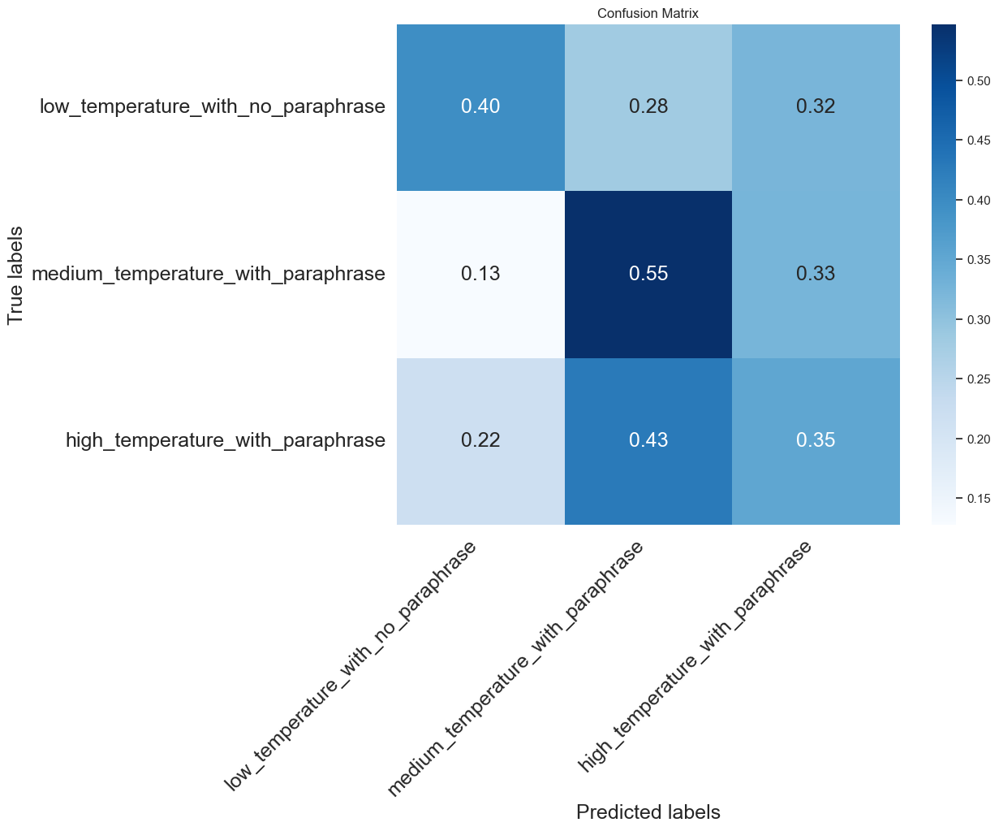

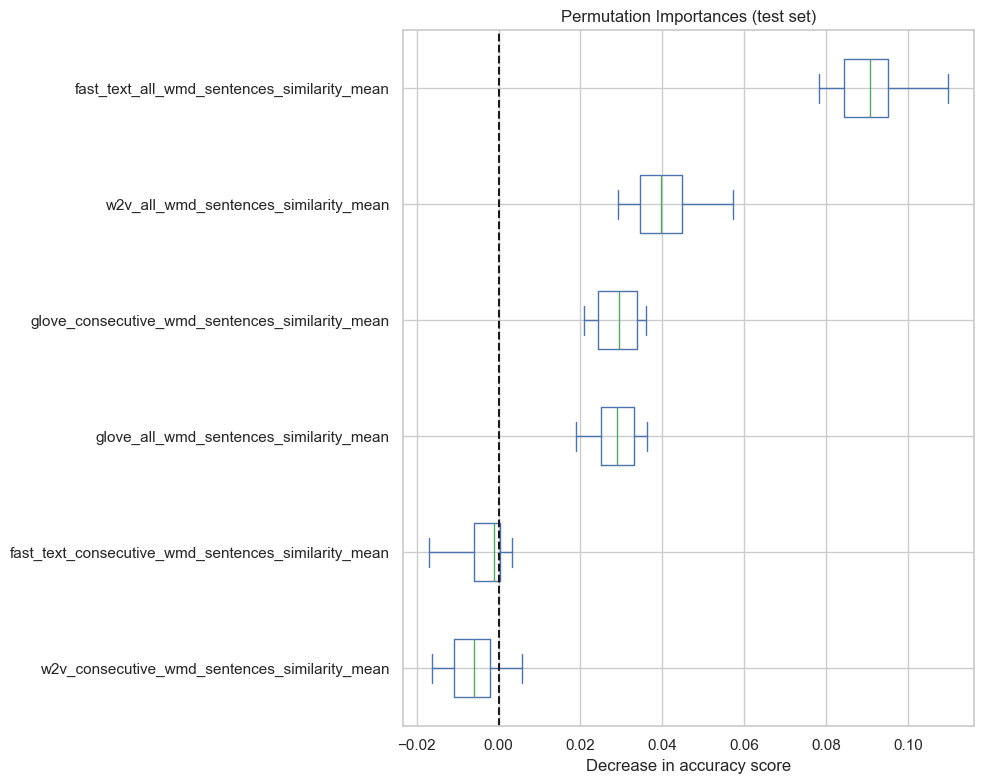

########################################
Training with wmd_std_sim_metrics
Accuracy: 0.5399515738498789
F1 Score: 0.5201125806476257


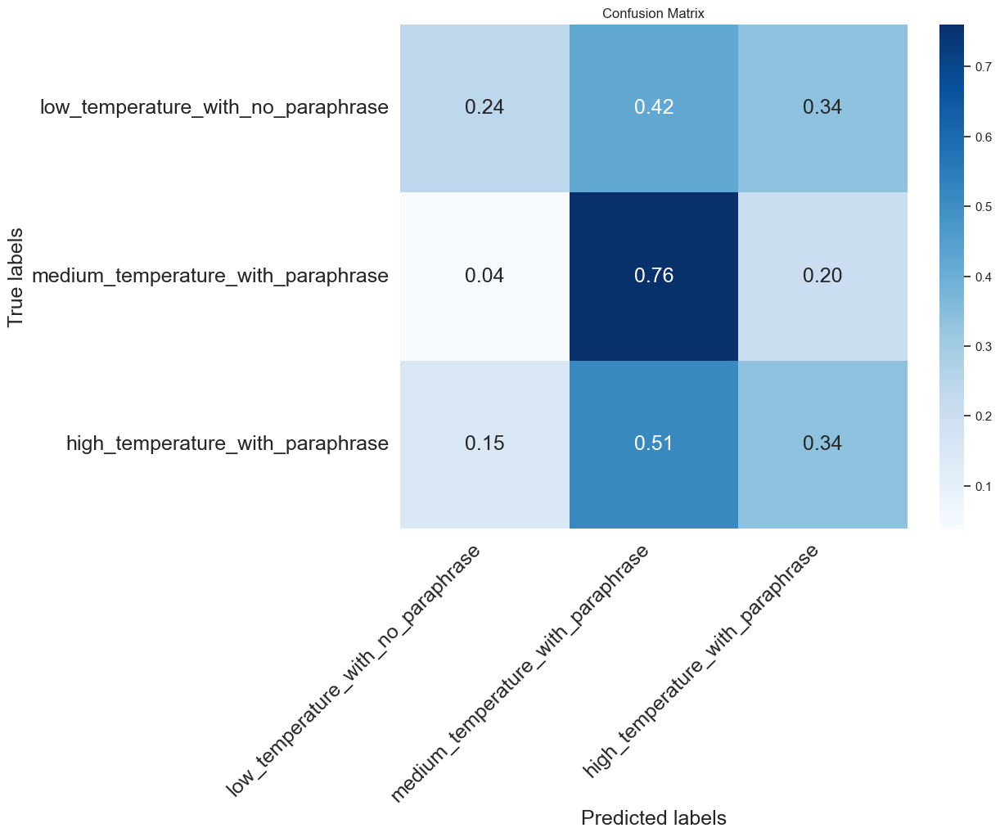

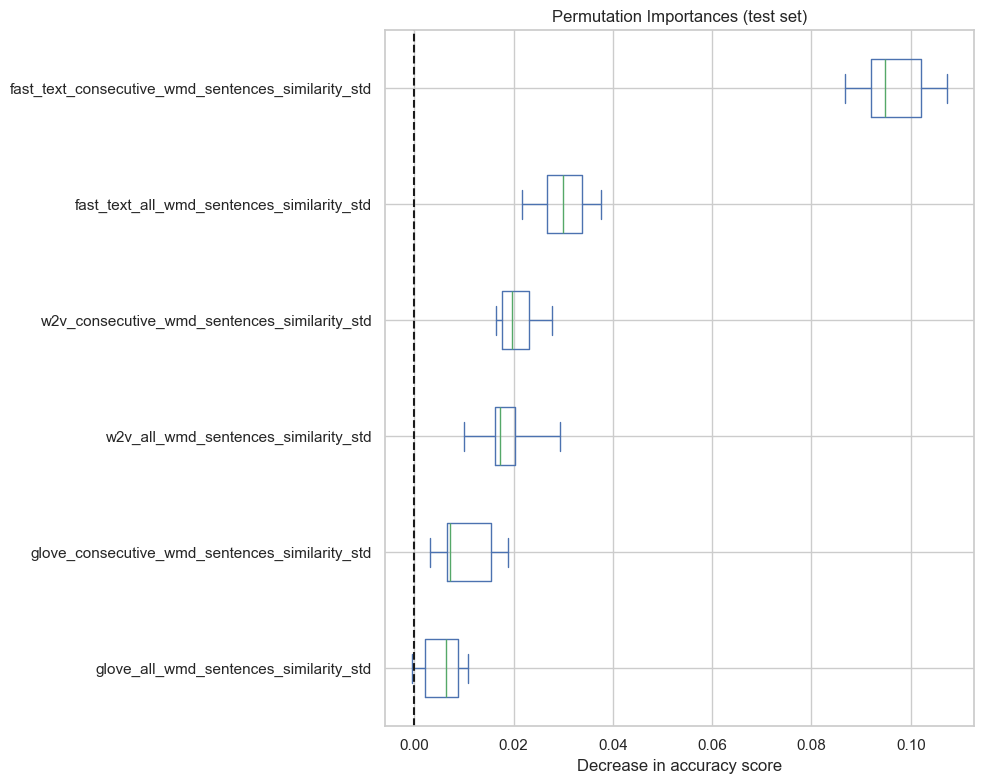

########################################
Training with mean_sim_metrics
Accuracy: 0.5819209039548022
F1 Score: 0.5826425207276646


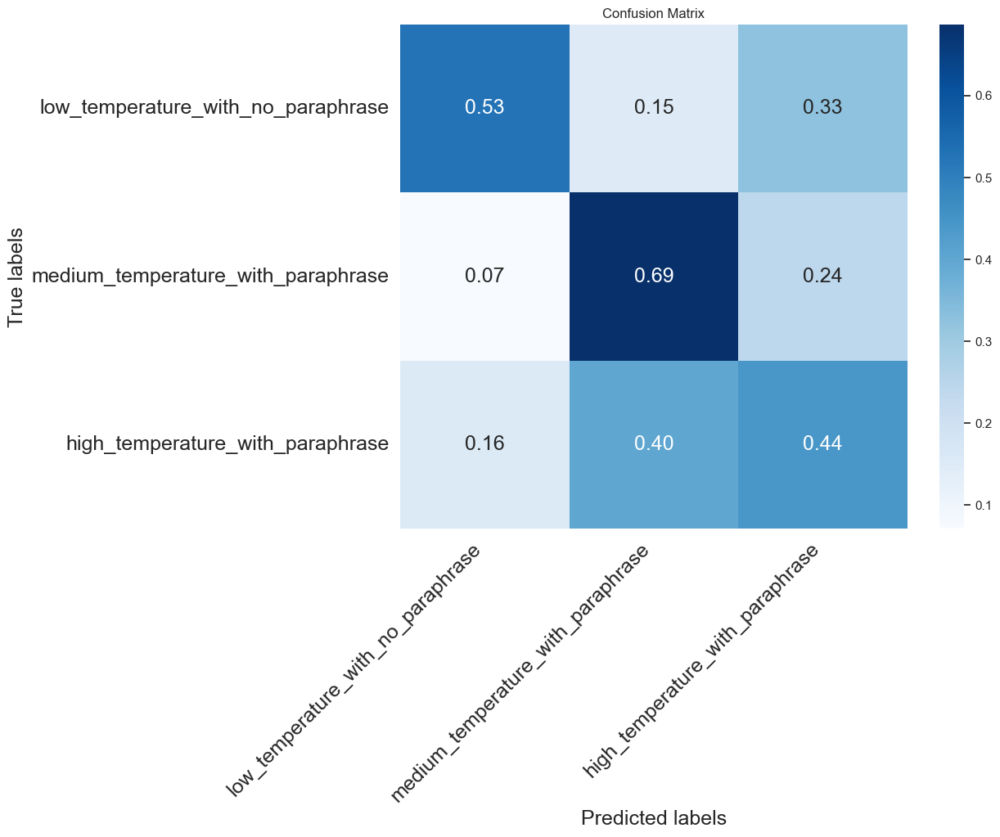

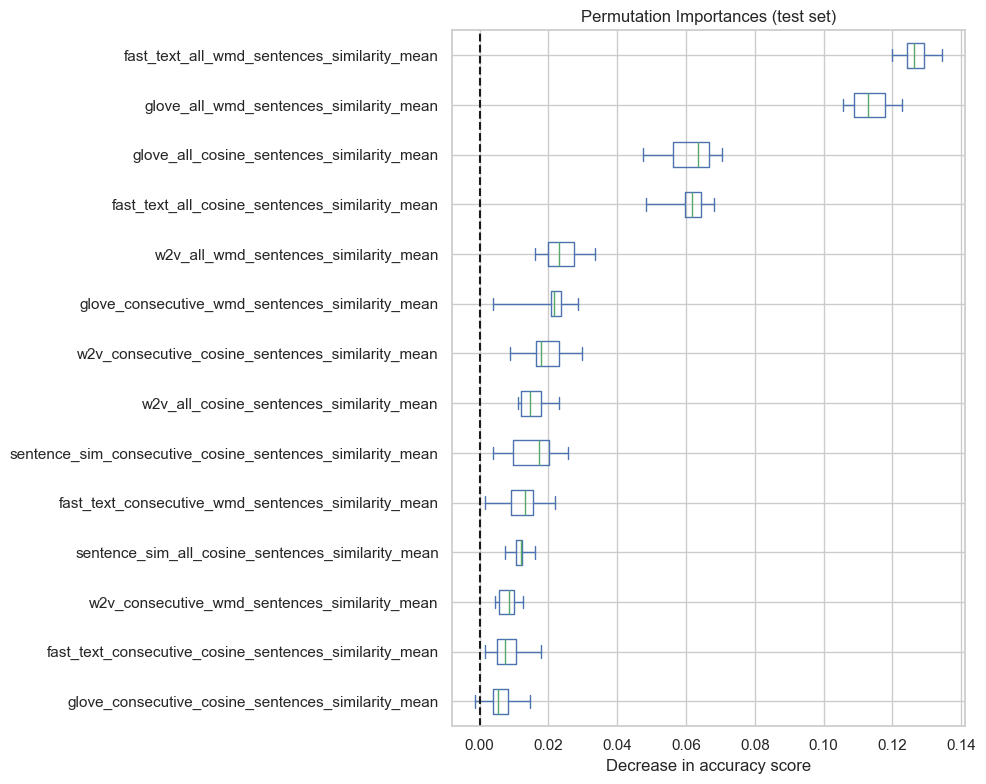

########################################
Training with density_features
Accuracy: 0.5690072639225182
F1 Score: 0.5549787722898915


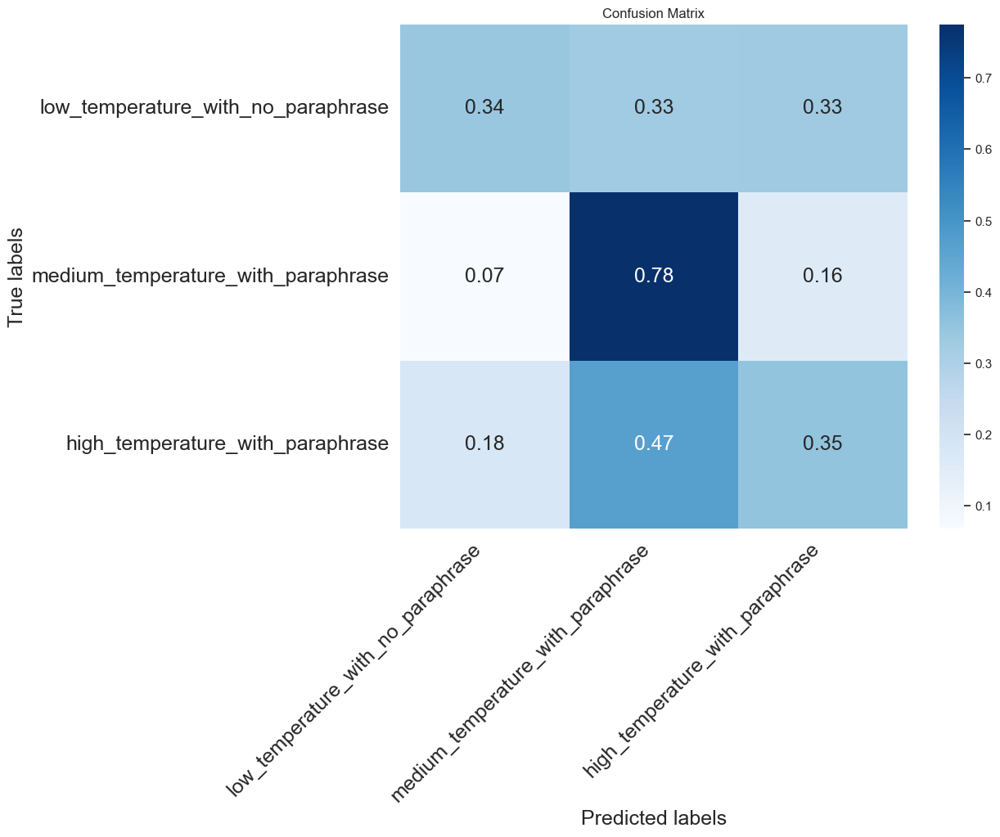

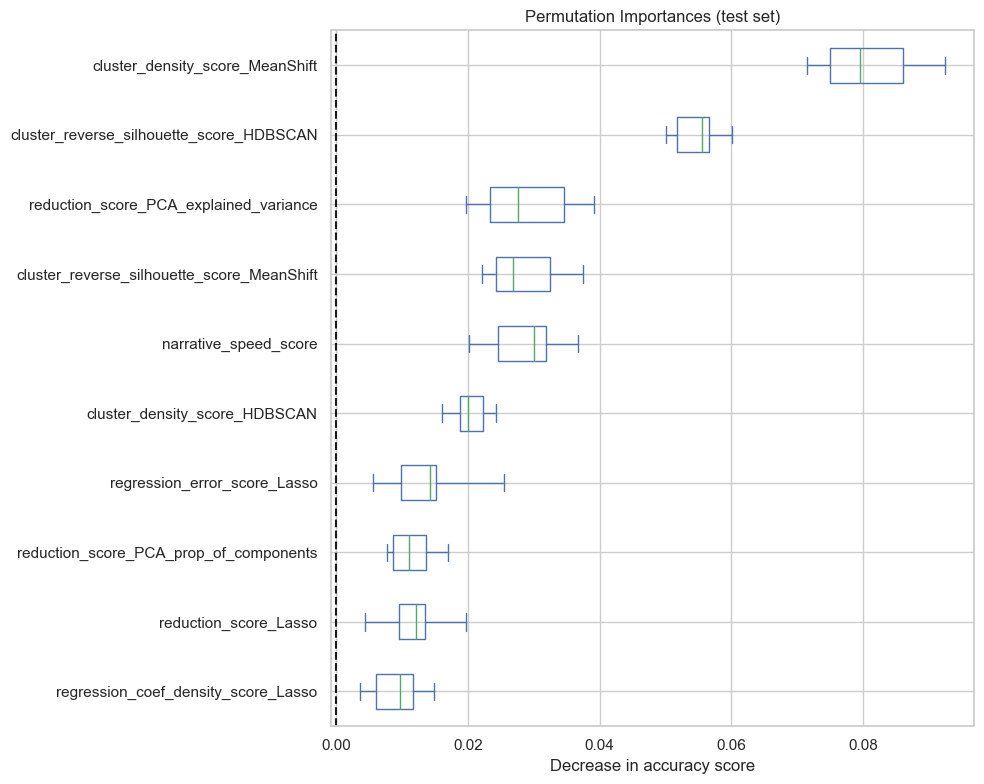

########################################
Training with std_sim_metrics
Accuracy: 0.5738498789346247
F1 Score: 0.5574920568464695


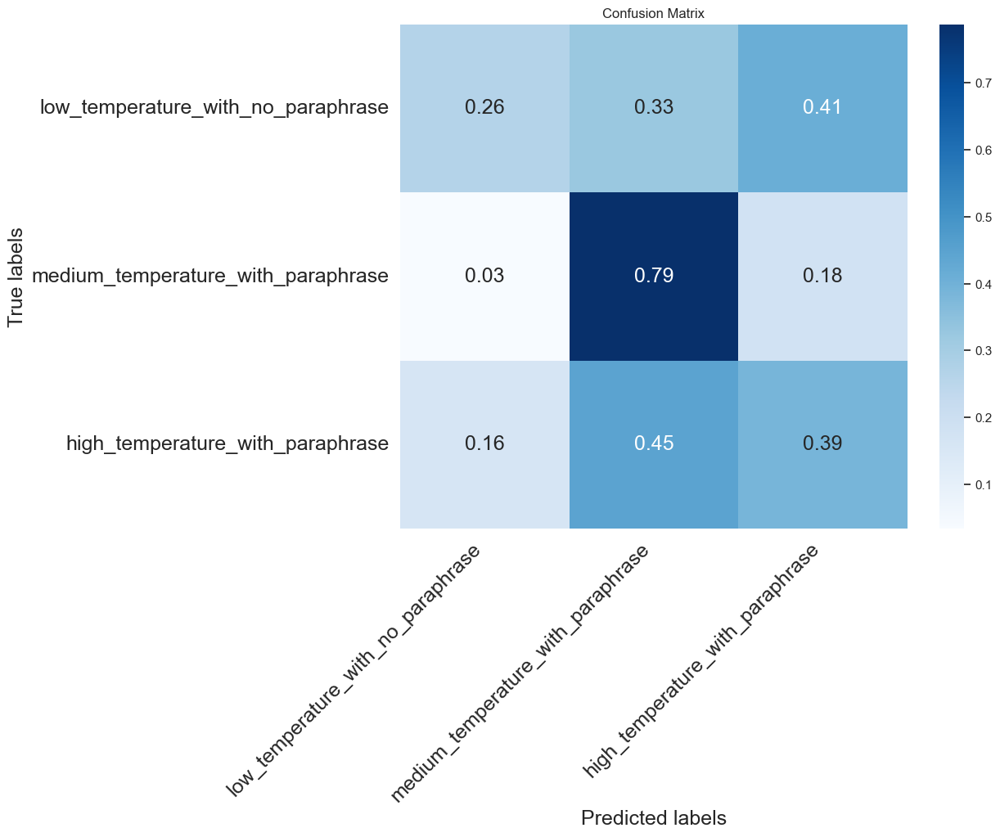

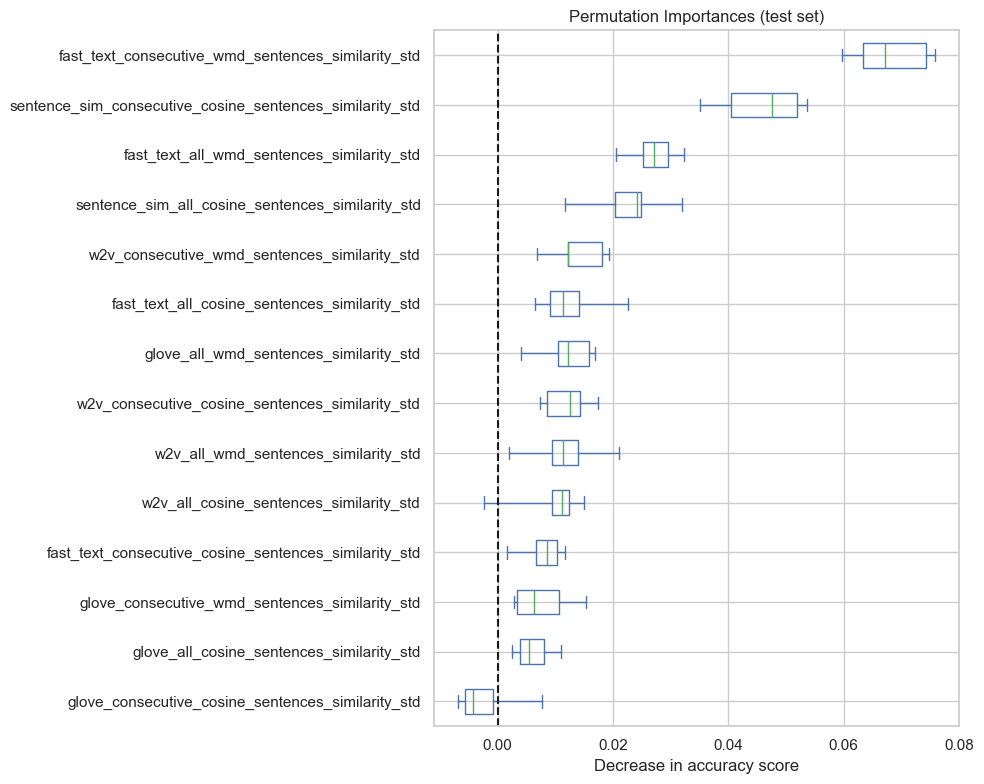

########################################
Training with all_features
Accuracy: 0.6937046004842615
F1 Score: 0.6919378192230601


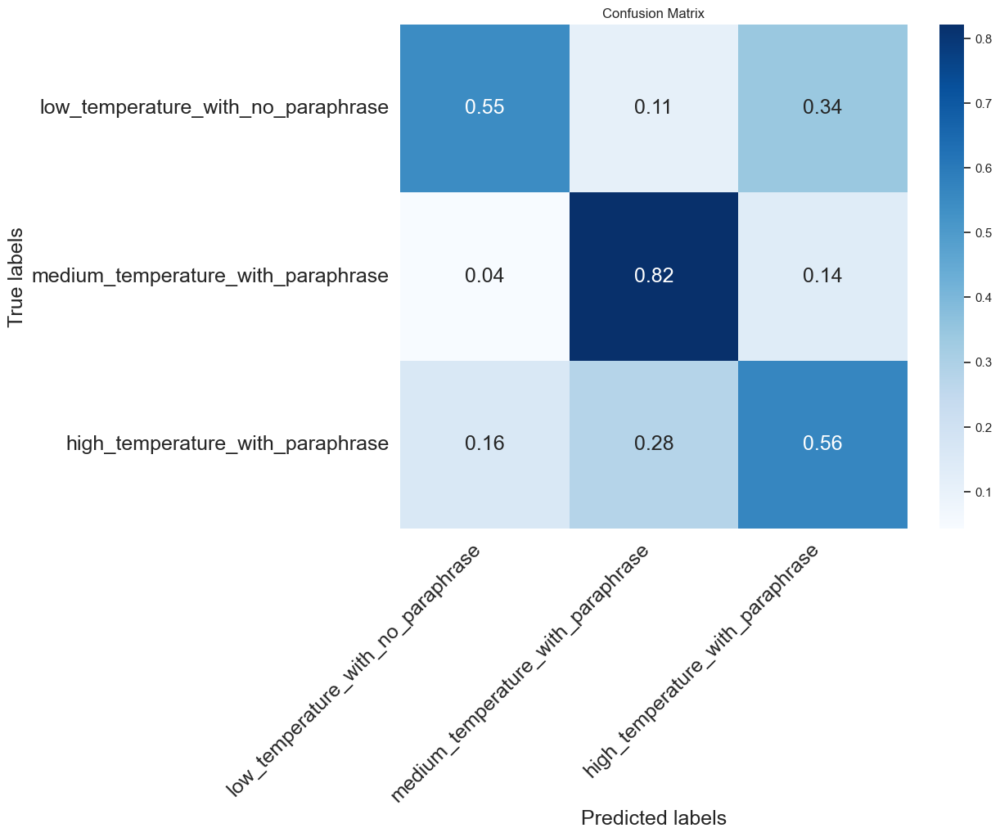

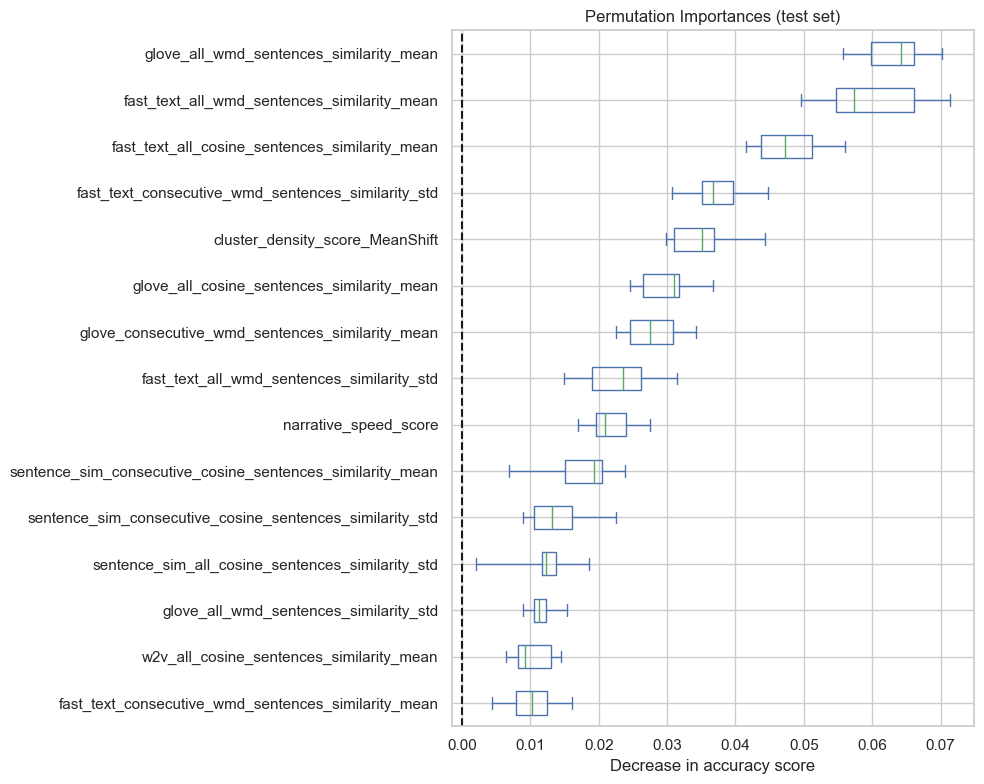

########################################
Training with best_features
Accuracy: 0.6731234866828087
F1 Score: 0.6678410804403897


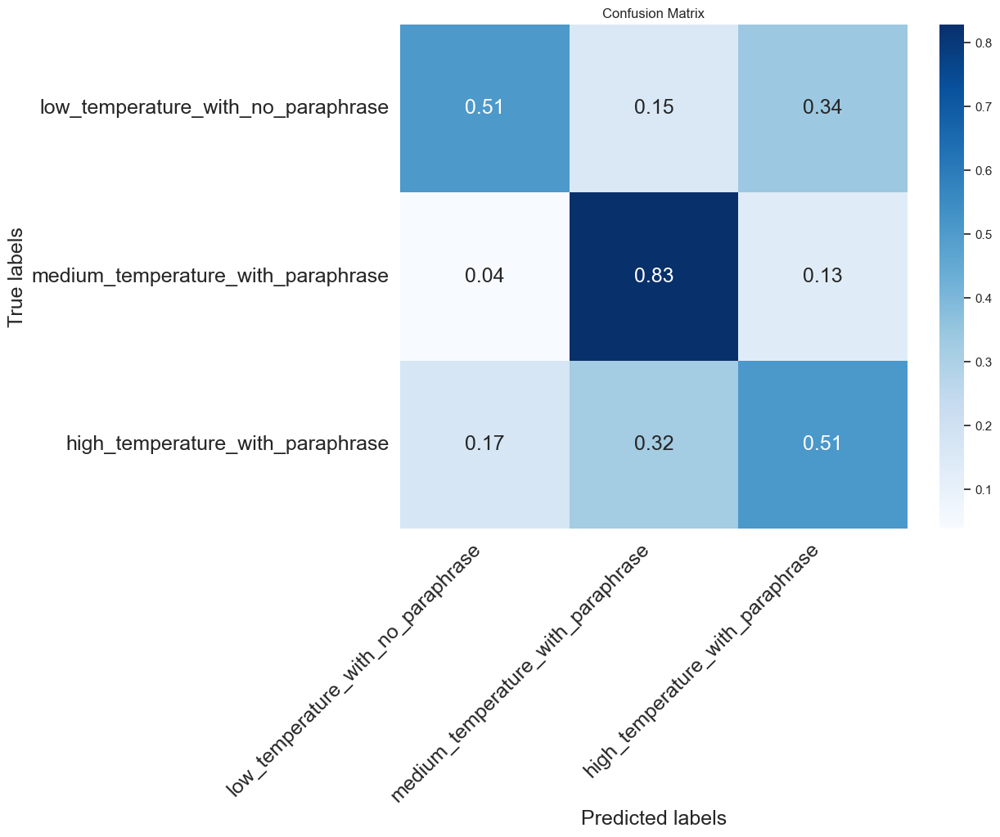

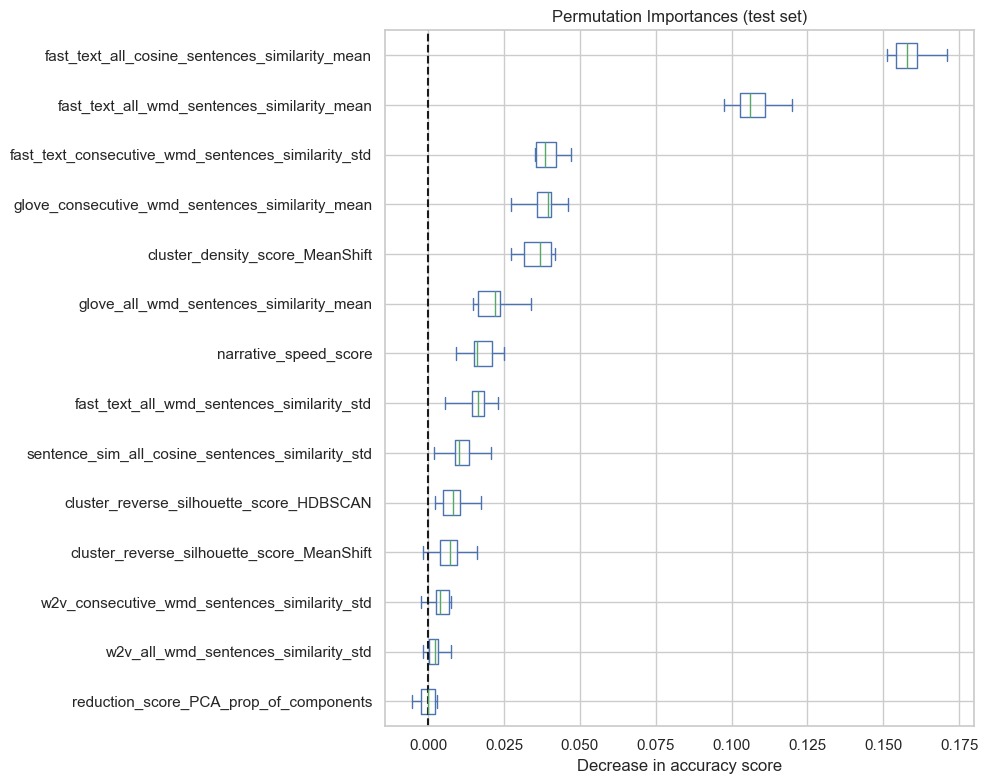

,features_name,accuracy,f1_score,confusion_matrix
0,cosine_mean_sim_metrics,0.483454,0.449644,"[[49, 250, 110], [78, 936, 262], [65, 515, 213]]"
1,cosine_std_sim_metrics,0.514528,0.492131,"[[85, 179, 145], [62, 949, 265], [106, 446, 241]]"
2,wmd_mean_sim_metrics,0.460048,0.465583,"[[162, 115, 132], [163, 698, 415], [174, 339, ..."
3,wmd_std_sim_metrics,0.539952,0.520113,"[[98, 173, 138], [50, 970, 256], [115, 408, 270]]"
4,mean_sim_metrics,0.581921,0.582643,"[[215, 61, 133], [91, 876, 309], [123, 319, 351]]"
5,density_features,0.569007,0.554979,"[[140, 133, 136], [87, 989, 200], [143, 369, 2..."
6,std_sim_metrics,0.57385,0.557492,"[[108, 133, 168], [43, 1005, 228], [128, 356, ..."
7,all_features,0.693705,0.691938,"[[224, 45, 140], [55, 1048, 173], [126, 220, 4..."
8,best_features,0.673123,0.667841,"[[207, 63, 139], [49, 1057, 170], [134, 255, 4..."


In [90]:
dataset = data.copy()
#dataset = data[data.combined_label.isin(["low_temperature_with_no_paraphrase","high_temperature_with_paraphrase"])].reset_index(drop=True)
dataset = filter_dataset(dataset,filter_name =  "psm")
dataset['cat_label'] = dataset['combined_label'].astype('category').cat.codes

train_and_evaluate_xgb(features_dict, dataset, y_name="cat_label")

In [19]:
def make_treatment_1(x):
    if x in ['low_temperature_with_no_paraphrase']:
        return 0
    elif x in ['high_temperature_with_paraphrase', 'medium_temperature_with_paraphrase']:
        return 1
    else :  return -1

def make_treatment_desorganisation(x):
    if x == "low_temperature":
        return 0
    else : 
        return 1


  
def from_target_and_treatment_name_to_index(dataset, target_list, treatment_name):
    dataset = dataset[dataset[treatment_name ]!= -1]
    df_to_match = dataset[target_list + [treatment_name,'index']]

    psm = PsmPy(df_to_match, treatment=treatment_name, indx="index",exclude = [])
    psm.logistic_ps(balance = True)
    psm.knn_matched(matcher='propensity_logit', replacement=False, caliper=None)

    df_id = psm.matched_ids
    df_sep_id = df_id[df_id['index'] != df_id.matched_ID]

    return df_sep_id, dataset


def compute_z_score(x):
    return (x - x.mean()) / x.std()


def compute_z_score_for_one_features(dataset, feature_name,df_id):
    source = df_id["index"].tolist()
    target = df_id["matched_ID"].tolist()
    diff_list = []
    for s, t in zip(source, target):
        source_value = dataset[dataset['index']==s][feature_name].values[0]
        target_value = dataset[dataset['index']==t][feature_name].values[0]
        diff = source_value - target_value
        diff_list.append(diff)
        
    z = abs(np.mean(diff_list))

    return z
    
def compute_z_score_for_paired_sample(dataset,pair_index,feature_name_list):
    df_results = pd.DataFrame(columns=["features_name","average_gap","std"])
    i = 0
    for features_name in feature_name_list:
        if features_name in dataset.columns:
            z = compute_z_score_for_one_features(dataset, features_name,pair_index)
            result = {"features_name":features_name,"average_gap":z,"std" : dataset[features_name].std()}
            df_results.loc[i] = pd.Series(result)
            i+=1
    return df_results



def from_target_and_treatment_name_to_results(dataset,target_list, treatment_name, features_list = all_features):
    df_sep_id, dataset = from_target_and_treatment_name_to_index(dataset, target_list, treatment_name)
    df_results = compute_z_score_for_paired_sample(dataset,df_sep_id,features_list)
    return df_results

dataset = data.copy()
dataset['treatment_1'] = dataset['combined_label'].apply(make_treatment_1)
dataset['treatment_temperature'] = dataset['temperature_enc'].apply(make_treatment_desorganisation)
dataset['treatment_repetition'] = dataset['has_paraphrase']
dataset['index'] = dataset.index


#target_list = ['sentence_sim_all_cosine_sentences_similarity_mean','sentence_sim_consecutive_cosine_sentences_similarity_mean']

target_list =  density_features #['average_mean_sim'] #cosine_mean_sim_metrics
treatment_name = "treatment_1"


results = from_target_and_treatment_name_to_results(dataset,target_list, treatment_name, features_list = all_features)
results.sort_values(by = "average_gap", ascending = False)

,features_name,average_gap,std
16,sentence_sim_consecutive_cosine_sentences_simi...,0.032805,0.089929
4,cluster_reverse_silhouette_score_HDBSCAN,0.031359,0.274354
5,cluster_density_score_MeanShift,0.021427,0.320394
21,fast_text_consecutive_wmd_sentences_similarity...,0.018048,0.026867
23,glove_consecutive_wmd_sentences_similarity_mean,0.016754,0.025325
19,w2v_consecutive_wmd_sentences_similarity_mean,0.015854,0.031317
11,w2v_all_cosine_sentences_similarity_mean,0.012216,0.131208
0,narrative_speed_score,0.012173,0.038354
6,cluster_reverse_silhouette_score_MeanShift,0.011659,0.413591
8,regression_error_score_Lasso,0.011356,0.119435


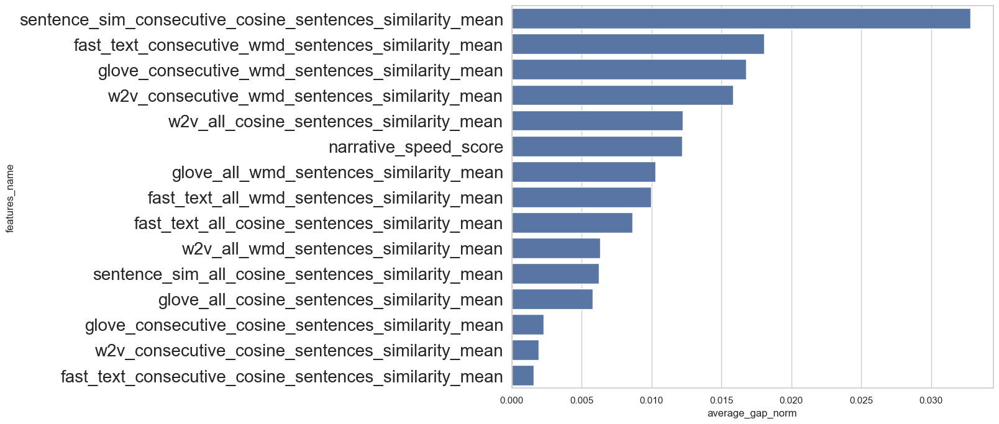

In [21]:
results['average_gap_norm'] = results['average_gap'] #/ results['std']
filter_results = results[~results['features_name'].isin(density_features+std_sim_metrics)]
ax = sns.barplot(data=filter_results.sort_values(by="average_gap_norm", ascending=False)[:15], x="average_gap_norm", y="features_name")
ax.set_yticklabels(ax.get_yticklabels(), fontsize=20)  # Adjust the fontsize as needed
plt.show()

In [141]:
target_list = ['narrative_speed_score']
results_deso = from_target_and_treatment_name_to_results(dataset,
                                                    target_list,
                                                    "treatment_1",
                                                    features_list = all_features)
results_deso.sort_values(by = "average_gap",ascending = False)

,features_name,average_gap
5,cluster_density_score_MeanShift,0.122754
6,cluster_reverse_silhouette_score_MeanShift,0.052318
3,cluster_density_score_HDBSCAN,0.022447
4,cluster_reverse_silhouette_score_HDBSCAN,0.016958
1,reduction_score_PCA_explained_variance,0.016872
30,sentence_sim_consecutive_cosine_sentences_simi...,0.015848
11,w2v_all_cosine_sentences_similarity_mean,0.014883
23,glove_consecutive_wmd_sentences_similarity_mean,0.014095
21,fast_text_consecutive_wmd_sentences_similarity...,0.013935
16,sentence_sim_consecutive_cosine_sentences_simi...,0.011659


In [138]:
results.sort_values(by = "average_gap",ascending = False)

,features_name,average_gap
5,cluster_density_score_MeanShift,0.212818
6,cluster_reverse_silhouette_score_MeanShift,0.134028
4,cluster_reverse_silhouette_score_HDBSCAN,0.047432
7,regression_coef_density_score_Lasso,0.034861
1,reduction_score_PCA_explained_variance,0.034616
3,cluster_density_score_HDBSCAN,0.027247
11,w2v_all_cosine_sentences_similarity_mean,0.025409
30,sentence_sim_consecutive_cosine_sentences_simi...,0.023212
13,fast_text_all_cosine_sentences_similarity_mean,0.019465
10,w2v_consecutive_cosine_sentences_similarity_mean,0.019111


In [117]:
len(set(df_sep_id['index']))*2 /len(dataset) * 100

54.46571825863729

In [136]:
df_results.sort_values(by="average_gap",ascending=False)

,features_name,average_gap
5,cluster_density_score_MeanShift,0.213653
6,cluster_reverse_silhouette_score_MeanShift,0.143584
4,cluster_reverse_silhouette_score_HDBSCAN,0.05231
7,regression_coef_density_score_Lasso,0.045976
1,reduction_score_PCA_explained_variance,0.03924
11,w2v_all_cosine_sentences_similarity_mean,0.027683
3,cluster_density_score_HDBSCAN,0.023317
30,sentence_sim_consecutive_cosine_sentences_simi...,0.022456
13,fast_text_all_cosine_sentences_similarity_mean,0.021766
10,w2v_consecutive_cosine_sentences_similarity_mean,0.020026


In [99]:
df_id

,index,matched_ID
0,5334,5334
1,5335,5335
2,5337,5337
3,5340,5340
4,5341,5341
...,...,...
3609,7098,4433
3610,7100,2745
3611,7104,10402
3612,7109,10106


In [72]:
data['cat_label'] = dataset['combined_label'].astype('category').cat.codes

train_and_evaluate_xgb(features_dict, data, y_name="cat_label")

########################################
Training with sim_features


ValueError: Invalid classes inferred from unique values of `y`.  Expected: [0 1 2 3 4 5 6], got [ 0.  1.  2.  3.  4.  5. nan]

In [18]:
# the idea is to find an equivalent of a low temperature text without parpahrasing with a high or medium temperature with paraphrasing using the sentence consine similarity mean
from psmpy import PsmPy
from psmpy.functions import cohenD
from psmpy.plotting import *


In [41]:
def make_treatment(x):
    if x in ['low_temperature_with_no_paraphrase']:
        return 0
    elif x in ['high_temperature_with_paraphrase', 'medium_temperature_with_paraphrase']:
        return 1
    else :  return -1

data['treatment'] = data['combined_label'].apply(make_treatment)

In [42]:
dataset = data[['sentence_sim_all_cosine_sentences_similarity_mean',
                 'sentence_sim_consecutive_cosine_sentences_similarity_mean', 'treatment']]


dataset = dataset[dataset.treatment != -1].reset_index(drop=True)
dataset['index'] = dataset.index
psm = PsmPy(dataset, treatment='treatment', indx="index",exclude = [])

In [43]:
psm.logistic_ps(balance = True)
psm.predicted_data

,index,sentence_sim_all_cosine_sentences_similarity_mean,sentence_sim_consecutive_cosine_sentences_similarity_mean,propensity_score,propensity_logit,treatment
0,0,0.248575,0.291794,0.548840,0.195987,0
1,2,0.410728,0.511726,0.395439,-0.424506,0
2,6,0.263064,0.331970,0.499211,-0.003158,0
3,7,0.431556,0.400208,0.616407,0.474325,0
4,8,0.430641,0.476719,0.483375,-0.066523,0
...,...,...,...,...,...,...
9344,6360,0.163223,0.239957,0.515775,0.063122,1
9345,6361,0.198220,0.299805,0.463877,-0.144746,1
9346,6362,0.301691,0.423458,0.399828,-0.406180,1
9347,6363,0.244950,0.304499,0.519028,0.076150,1


In [44]:
psm.knn_matched(matcher='propensity_logit', replacement=False, caliper=None)

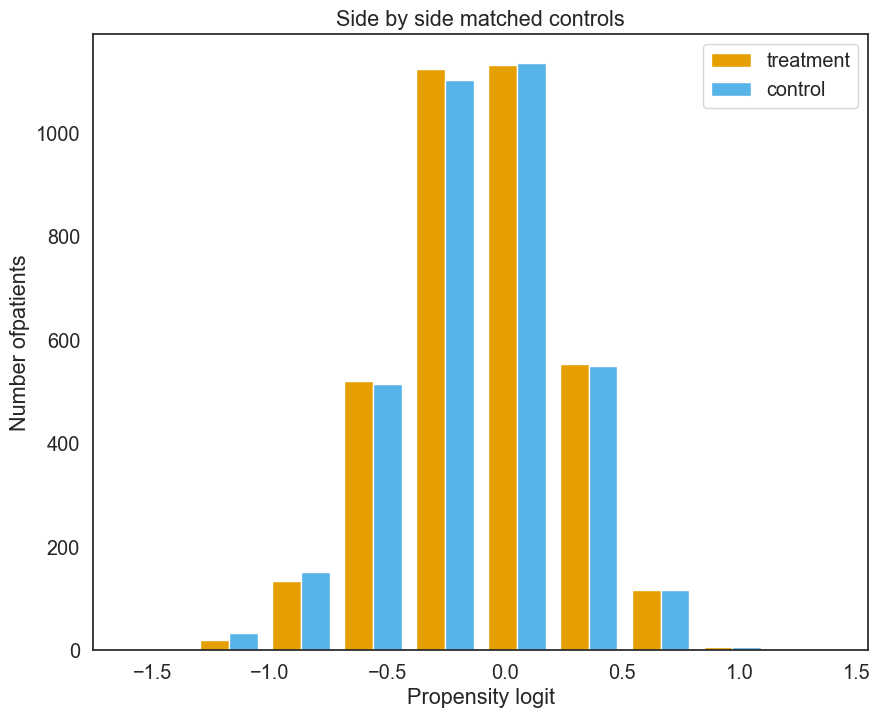

In [45]:
psm.plot_match(Title='Side by side matched controls', Ylabel='Number ofpatients', Xlabel= 'Propensity logit',names = ['treatment', 'control'], colors=['#E69F00', '#56B4E9'] ,save=True)

In [46]:
psm.matched_ids

,index,matched_ID
0,0,3727
1,2,3928
2,6,616
3,7,2175
4,8,4977
...,...,...
3609,9332,846
3610,9334,496
3611,9338,3060
3612,9342,4447


In [59]:
len(psm.df_matched['index'])

7227

In [52]:
len(psm.df_matched) , len(dataset)

(7227, 9349)

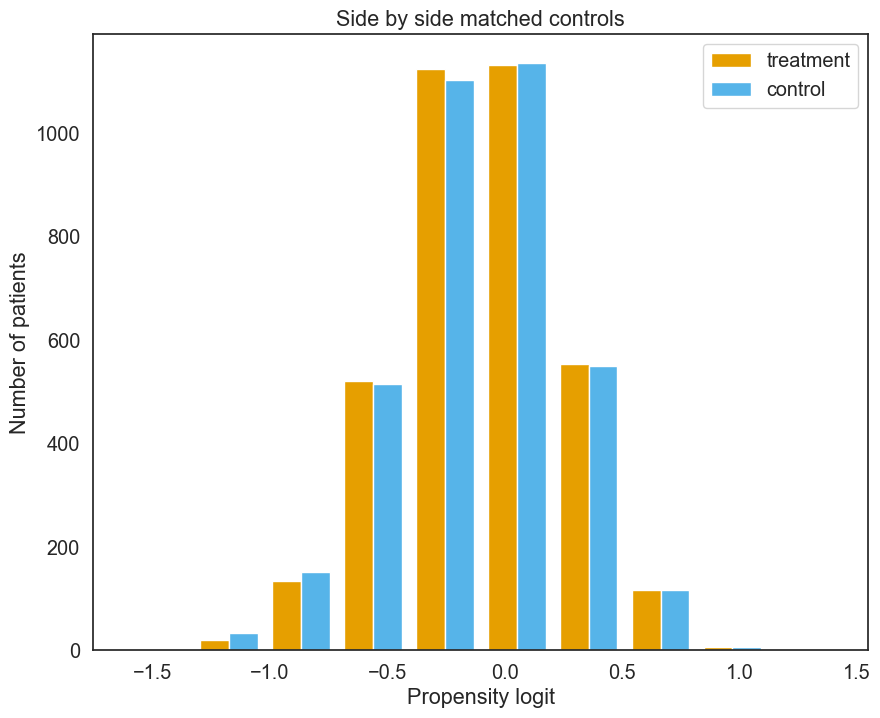

In [49]:
psm.plot_match(Title='Side by side matched controls', Ylabel='Number of patients', Xlabel= 'Propensity logit', names = ['treatment', 'control'], save=True)

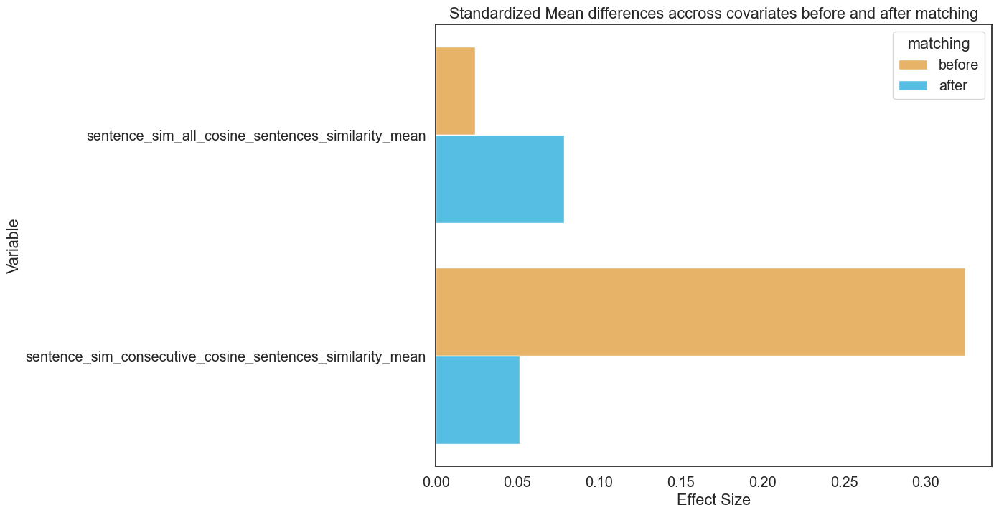

In [50]:
psm.effect_size_plot(save=True)

In [51]:
psm.effect_size

,Variable,matching,Effect Size
0,sentence_sim_all_cosine_sentences_similarity_mean,before,0.024043
1,sentence_sim_all_cosine_sentences_similarity_mean,after,0.078491
2,sentence_sim_consecutive_cosine_sentences_simi...,before,0.324310
3,sentence_sim_consecutive_cosine_sentences_simi...,after,0.051552


In [12]:
data[data.temperature_enc!="high_temperature"].reset_index(drop=True)

,index,prompt,generated_text,model_name,temperature,num_beams,text,llm_model,paraphrase_model,altered_text,...,paraphrase_is_short,paraphrase_at_end,has_paraphrase,prompt_cat,has_lexical_repetition,temperature_enc,paraphrase_enc,combined_label,cat_label,random
0,0,Most people start the day by,Most people start the day by getting out of be...,gpt2,1.031016,5,Most people start the day by getting out of be...,gpt2,-1,Most people start the day by getting out of be...,...,0,0,0,2,0,low_temperature,no_paraphrase,low_temperature_with_no_paraphrase,2,0.978634
1,1,Most people start the day by,Most people start the day by waking up in the ...,gpt2,0.942180,5,Most people start the day by waking up in the ...,gpt2,-1,Most people start the day by waking up in the ...,...,0,0,0,2,0,low_temperature,no_paraphrase,low_temperature_with_no_paraphrase,2,0.472494
2,3,Most people start the day by,Most people start the day by getting up and go...,gpt2,0.911323,5,Most people start the day by getting up and go...,gpt2,-1,Most people start the day by getting up and go...,...,0,0,0,2,0,low_temperature,no_paraphrase,low_temperature_with_no_paraphrase,2,0.538702
3,4,Most people start the day by,"Most people start the day by eating breakfast,...",gpt2,0.986080,5,Most people start the day by eating breakfast ...,gpt2,-1,Most people start the day by eating breakfast ...,...,0,0,0,2,0,low_temperature,no_paraphrase,low_temperature_with_no_paraphrase,2,0.638327
4,5,Most people start the day by,Most people start the day by getting up and go...,gpt2,1.020512,4,Most people start the day by getting up and go...,gpt2,-1,Most people start the day by getting up and go...,...,0,0,0,2,0,low_temperature,no_paraphrase,low_temperature_with_no_paraphrase,2,0.338798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13211,8894,I worry a lot about,"I worry a lot about my safety, but I don't wan...",pythia,2.264083,4,-1,pythia,gpt-3.5-turbo,I worry a lot about my safety but I dont want ...,...,0,0,0,1,0,medium_temperature,no_paraphrase,medium_temperature_with_no_paraphrase,4,0.057543
13212,8895,I worry a lot about,"I worry a lot about it, but what can we do wit...",pythia,2.837510,4,-1,pythia,gpt-3.5-turbo,I worry a lot about it but what can we do with...,...,0,0,0,1,0,medium_temperature,no_paraphrase,medium_temperature_with_no_paraphrase,4,0.074348
13213,8896,I worry a lot about,I worry a lot about it. I worry about things l...,pythia,2.010320,4,-1,pythia,gpt-3.5-turbo,I worry a lot about it. I worry about things l...,...,0,0,0,1,0,medium_temperature,no_paraphrase,medium_temperature_with_no_paraphrase,4,0.743518
13214,8897,I worry a lot about,"I worry a lot about what others might think"". ...",pythia,2.519119,5,-1,pythia,gpt-3.5-turbo,I worry a lot about what others might think. W...,...,0,0,0,1,0,medium_temperature,no_paraphrase,medium_temperature_with_no_paraphrase,4,0.577109


In [7]:
data.temperature_enc.value_counts()

temperature_enc
medium_temperature    6673
low_temperature       6543
high_temperature      5632
Name: count, dtype: int64

In [82]:
data.combined_label.value_counts()

combined_label
medium_temperature_with_no_paraphrase    3641
low_temperature_with_no_paraphrase       3614
medium_temperature_with_paraphrase       3032
high_temperature_with_no_paraphrase      2929
low_temperature_with_paraphrase          2929
high_temperature_with_paraphrase         2703
Name: count, dtype: int64

########################################
Training with narrative_speed_score
Accuracy: 0.33364538475940836
F1 Score: 0.2711519430771039


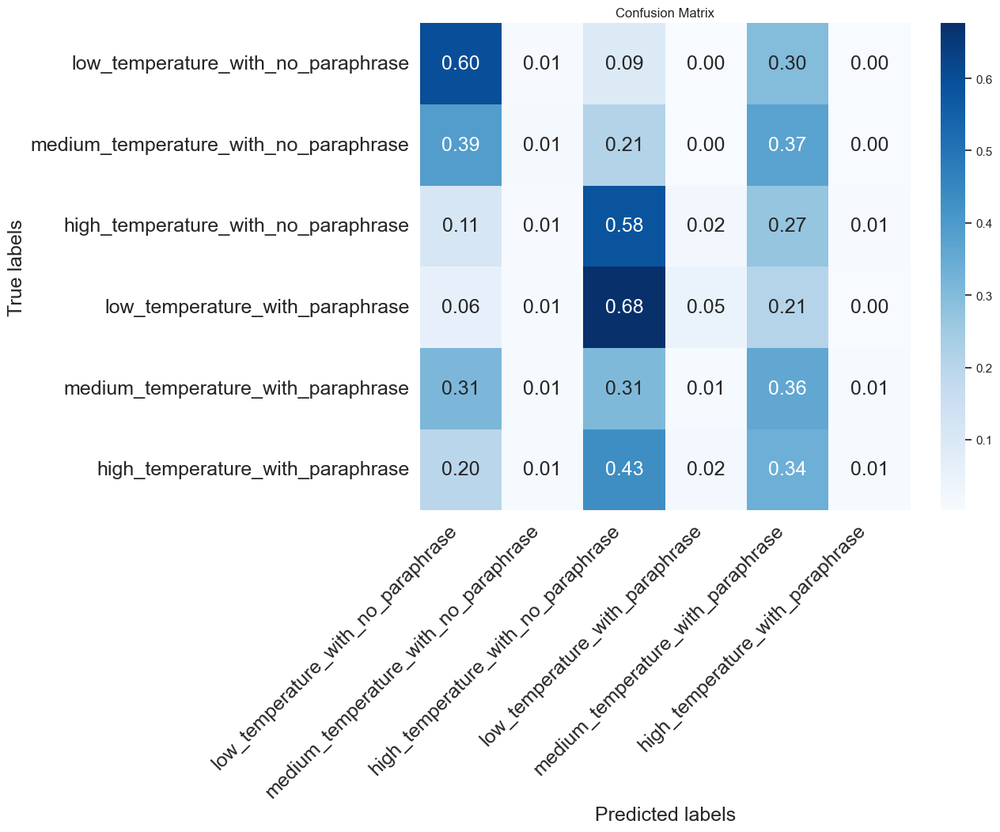

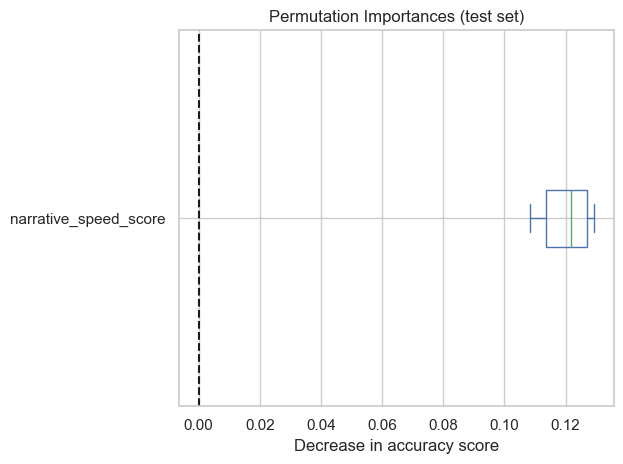

########################################
Training with reduction_score_PCA_explained_variance
Accuracy: 0.24340011233851339
F1 Score: 0.20392406740968108


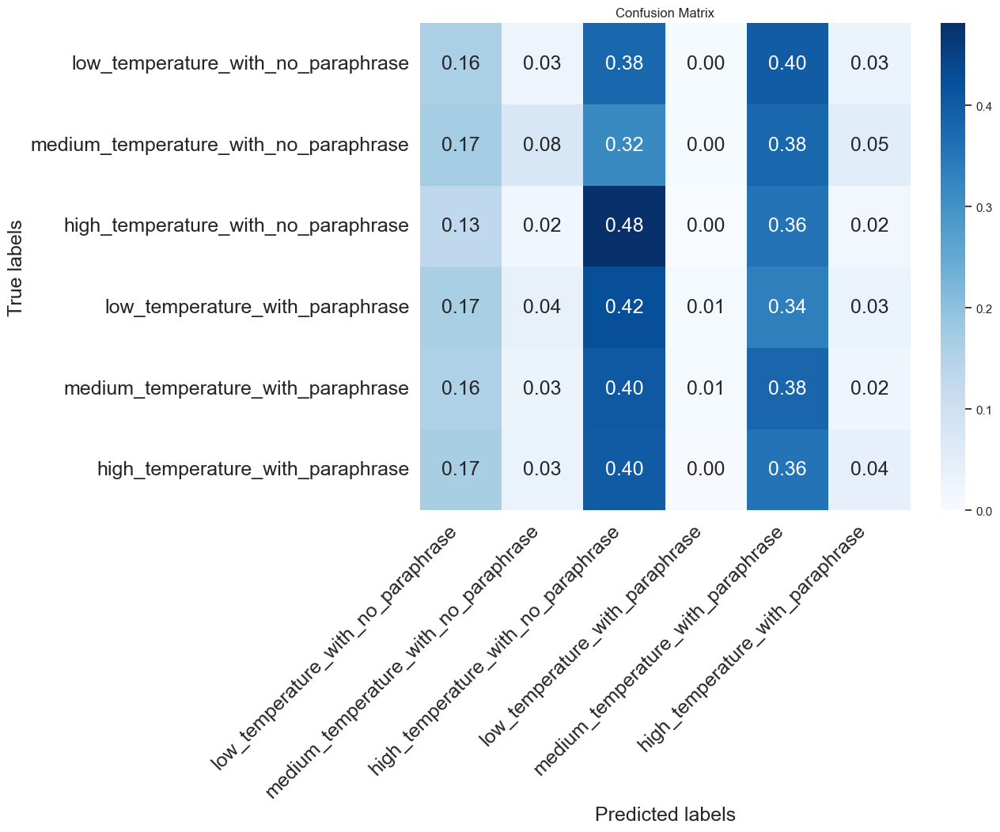

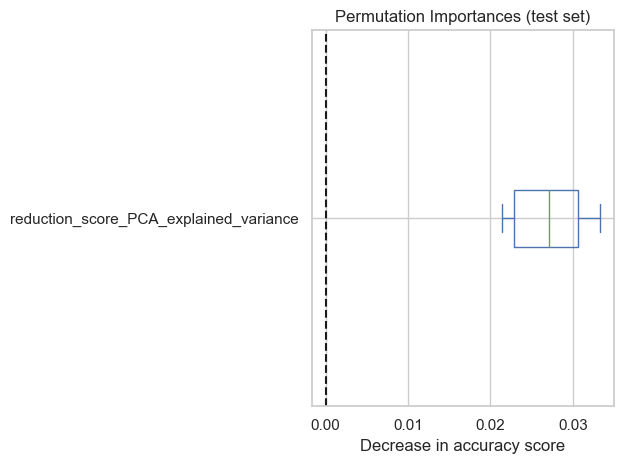

########################################
Training with reduction_score_PCA_prop_of_components
Accuracy: 0.32091368657554764
F1 Score: 0.24063064364584005


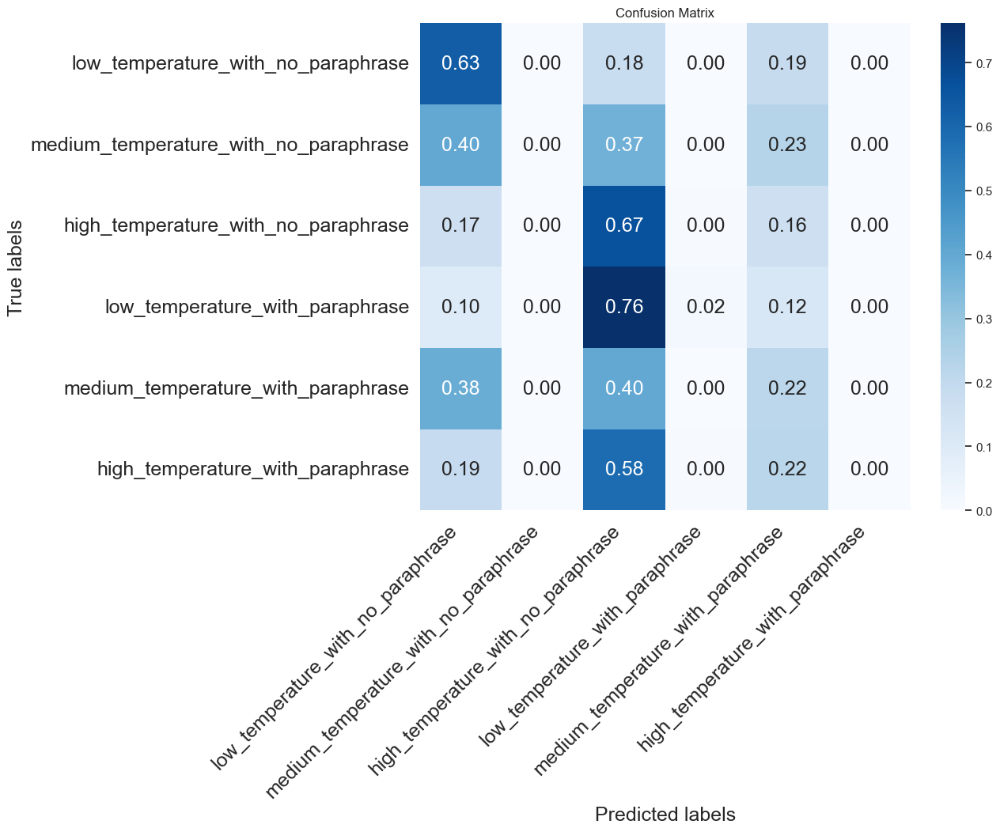

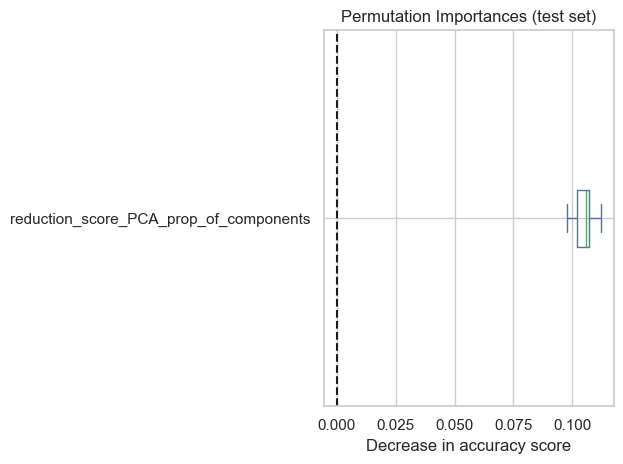

########################################
Training with cluster_density_score_HDBSCAN
Accuracy: 0.2963864444860513
F1 Score: 0.21764811020838637


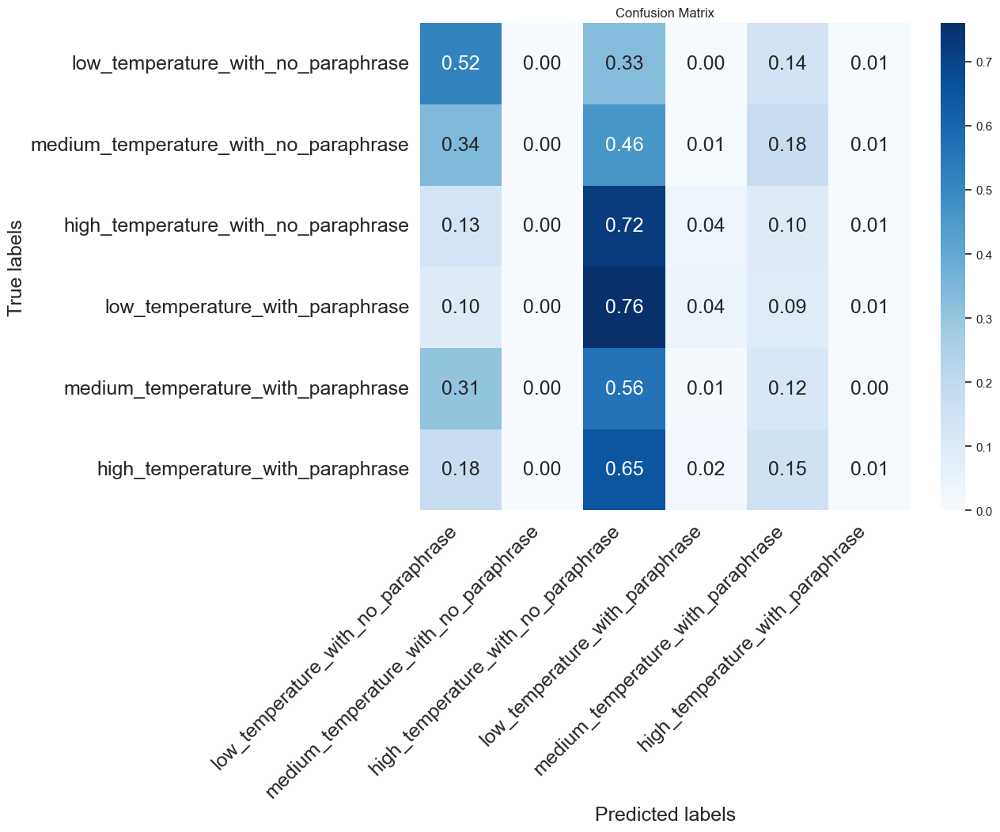

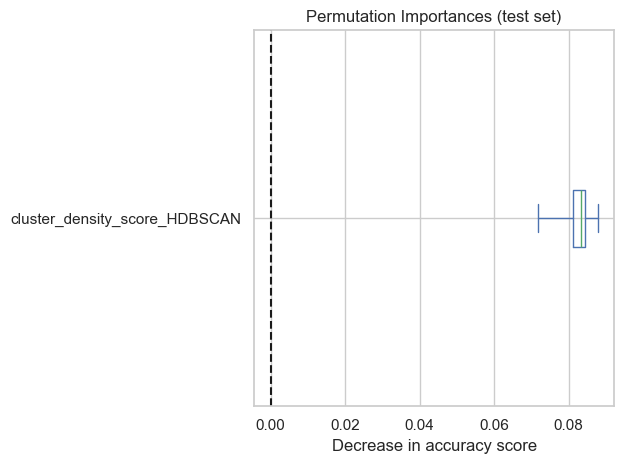

########################################
Training with cluster_reverse_silhouette_score_HDBSCAN
Accuracy: 0.27017412469574986
F1 Score: 0.25190203790180515


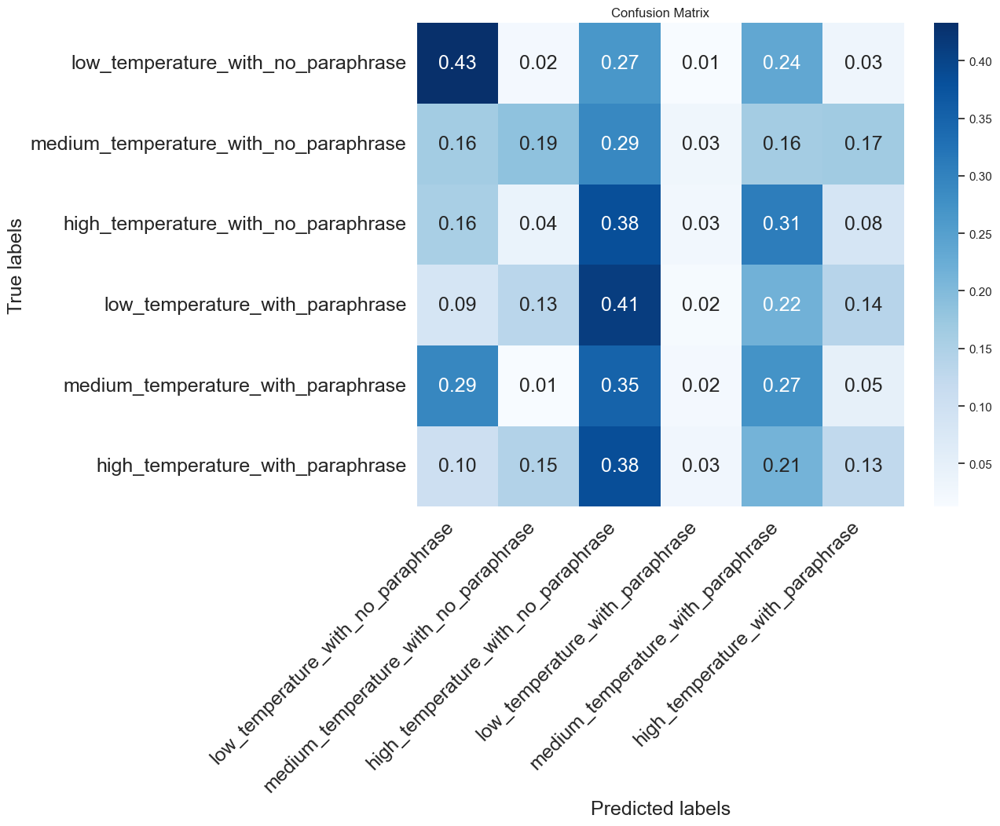

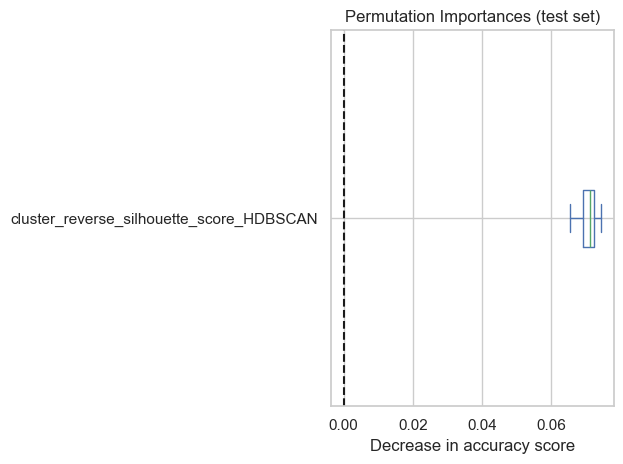

########################################
Training with cluster_density_score_MeanShift
Accuracy: 0.3255944579666729
F1 Score: 0.2725302006905927


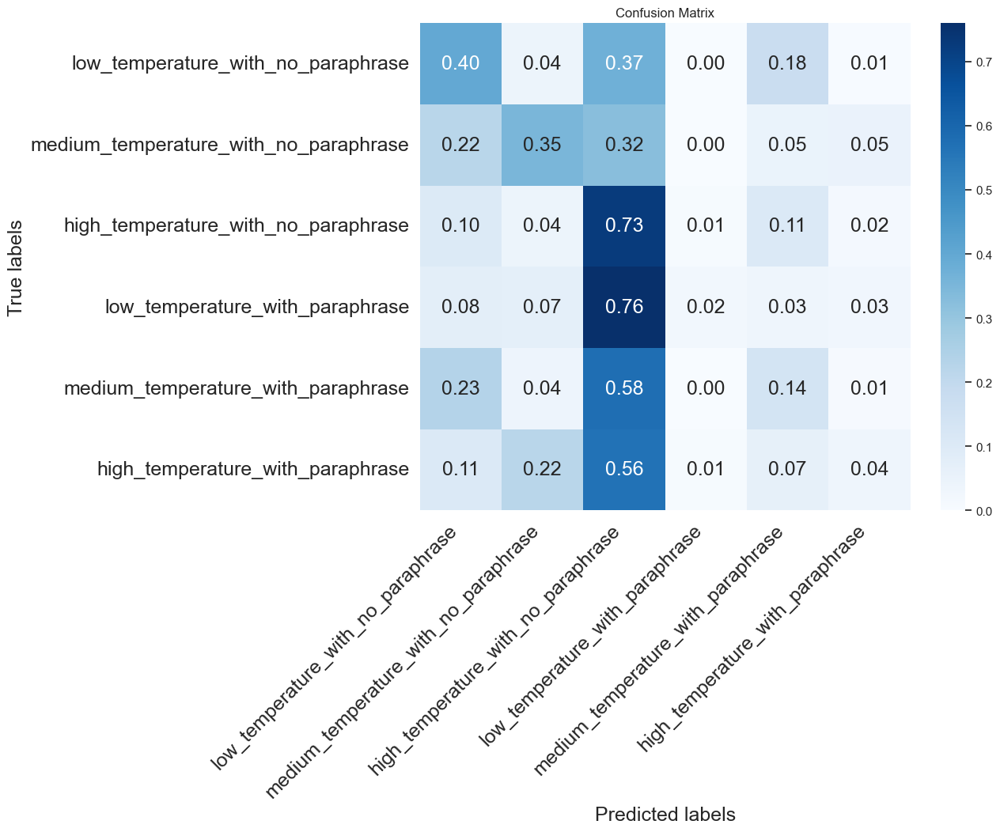

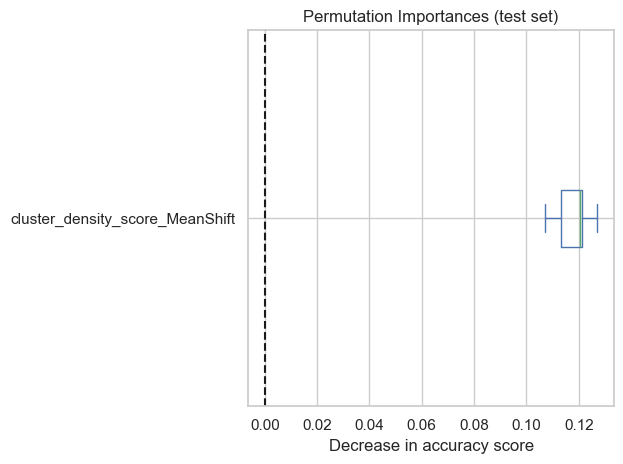

########################################
Training with cluster_reverse_silhouette_score_MeanShift
Accuracy: 0.2692379704175248
F1 Score: 0.2368229697461102


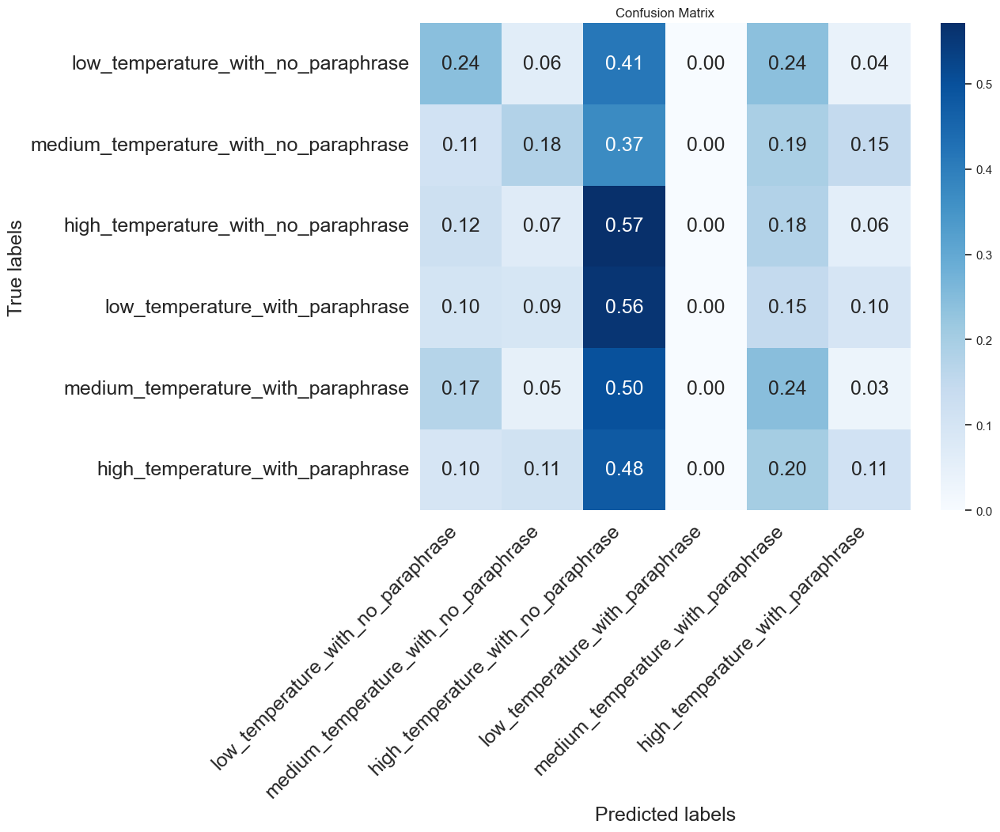

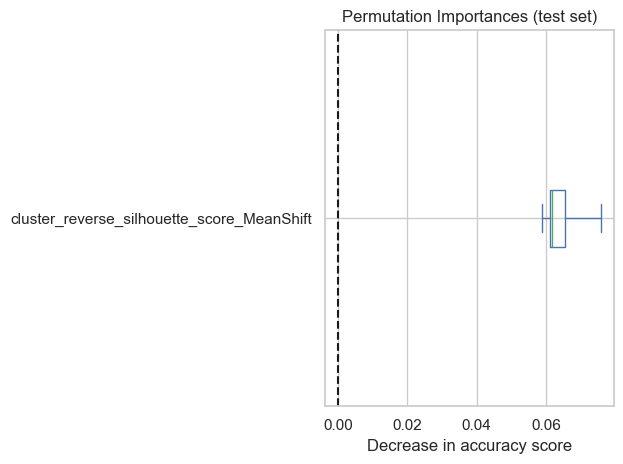

########################################
Training with regression_coef_density_score_Lasso
Accuracy: 0.28271859202396554
F1 Score: 0.22462492844280688


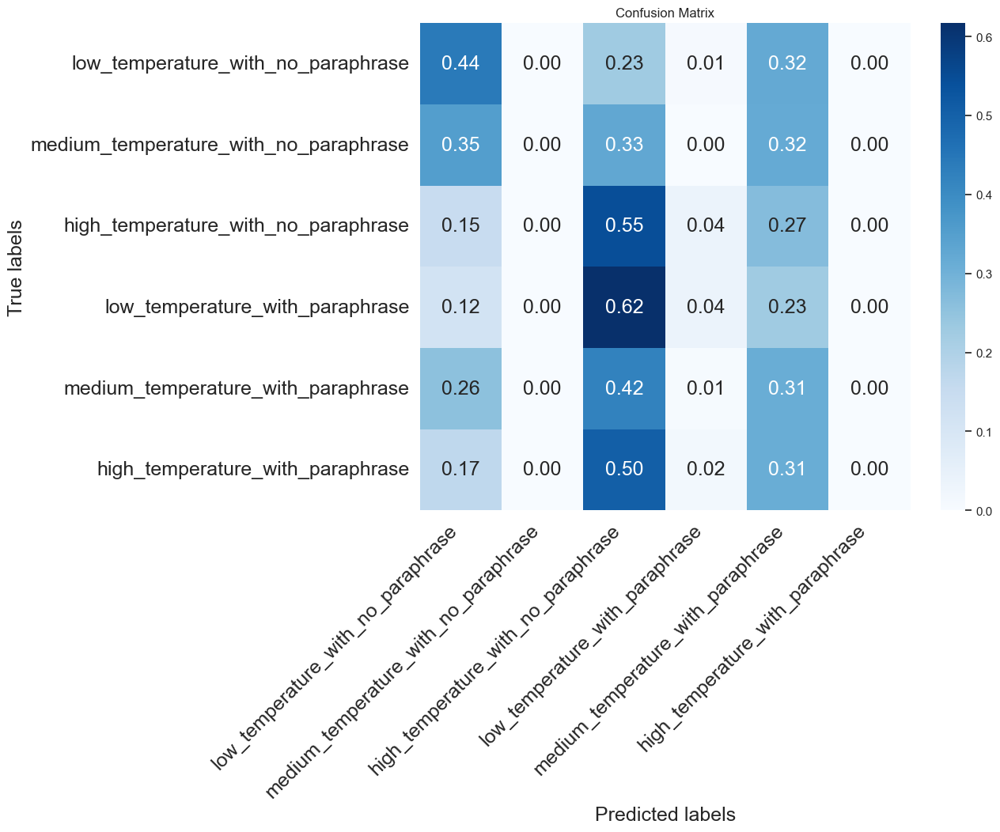

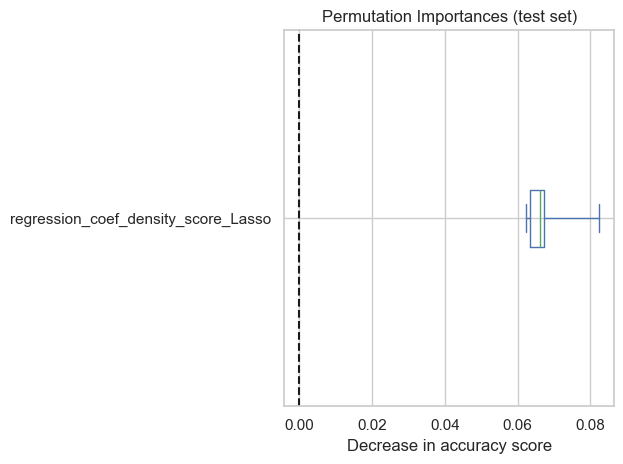

########################################
Training with regression_error_score_Lasso
Accuracy: 0.2108219434562816
F1 Score: 0.17071433549441573


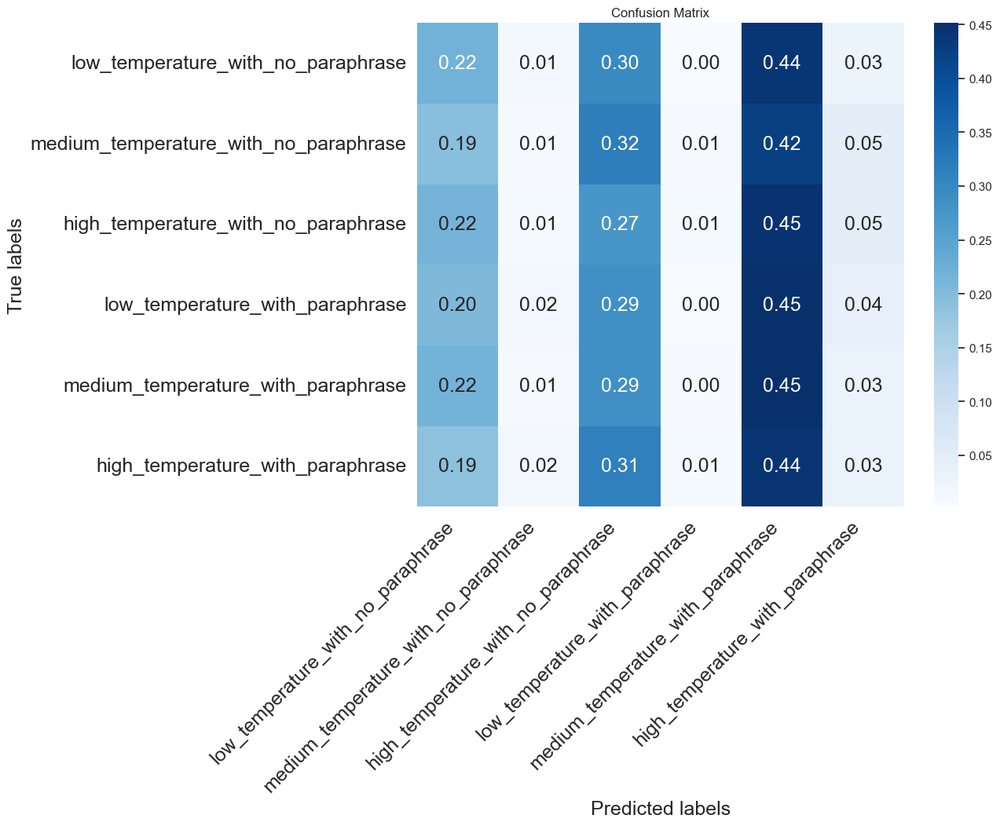

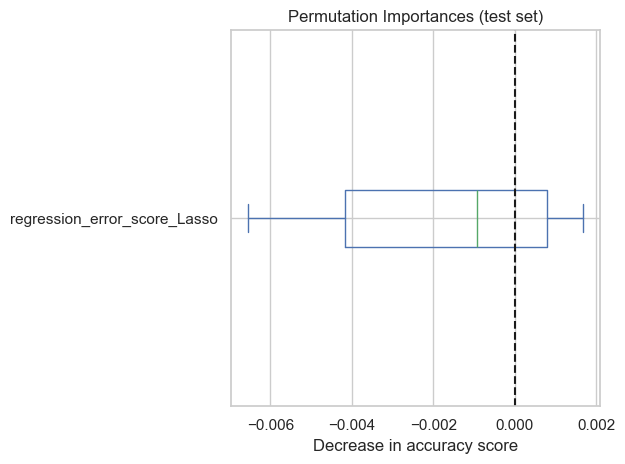

########################################
Training with reduction_score_Lasso
Accuracy: 0.29507582849653624
F1 Score: 0.2315471638239451


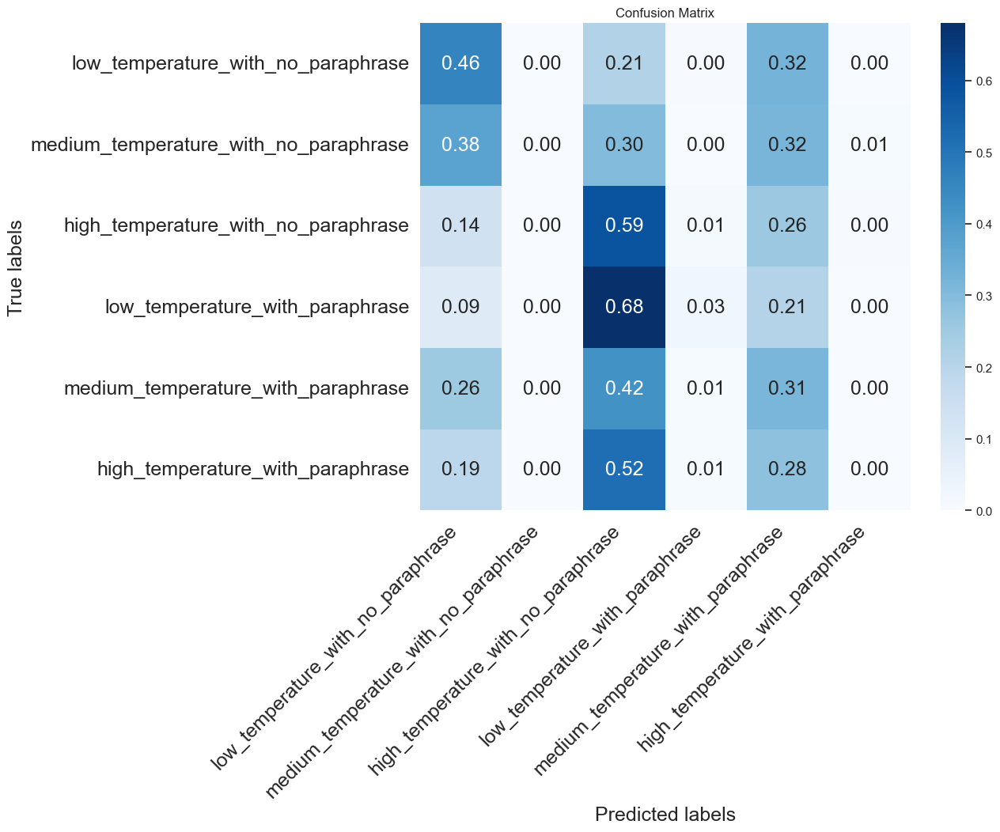

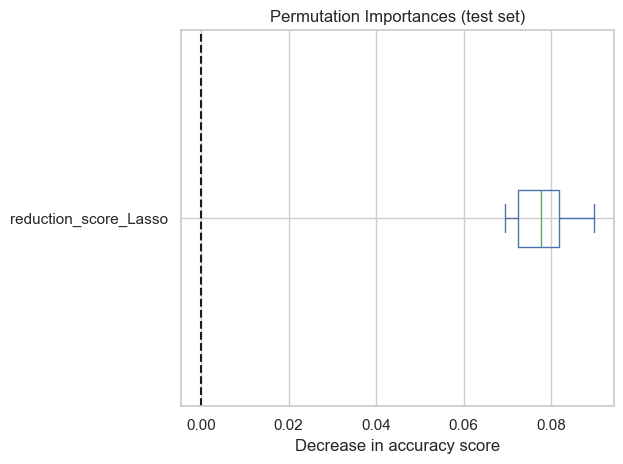

In [77]:
test_dict  = {elt : [elt] for elt in density_features}
from src.utils import encode_temperature
data['temperature_enc_int'] = data['temperature'].apply(encode_temperature)
train_and_evaluate_xgb(test_dict, dataset, y_name="cat_label")

########################################
Training with sim_features
Accuracy: 0.4777099953073674
F1 Score: 0.4757435386514532


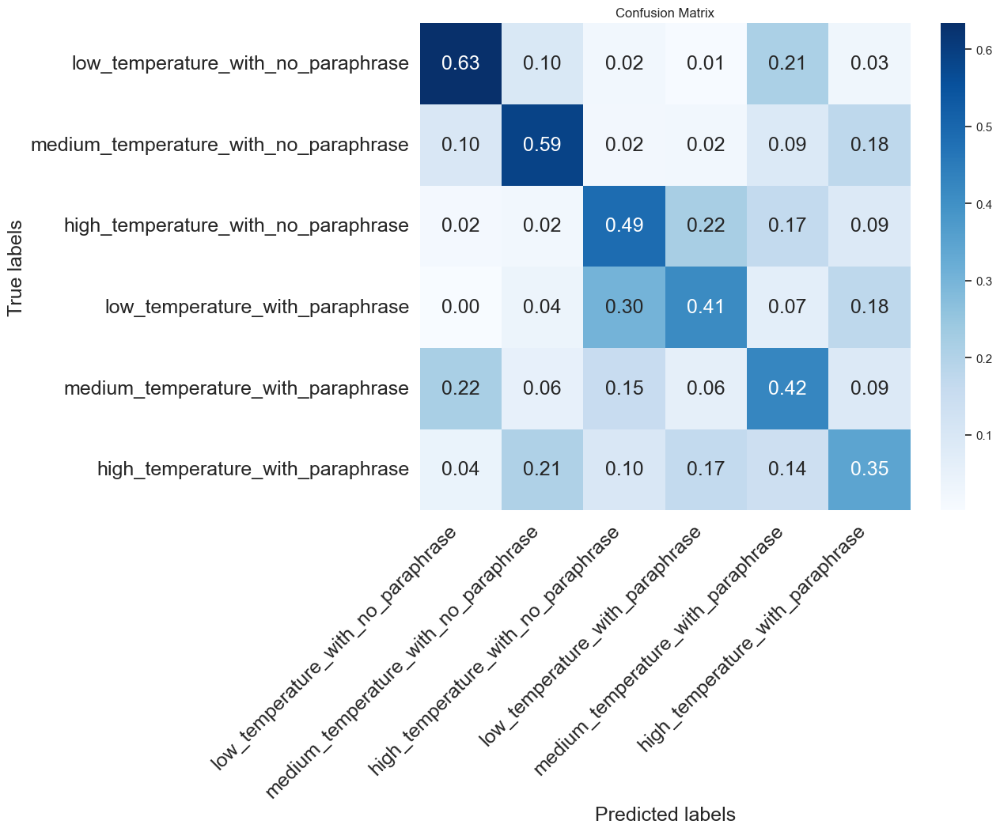

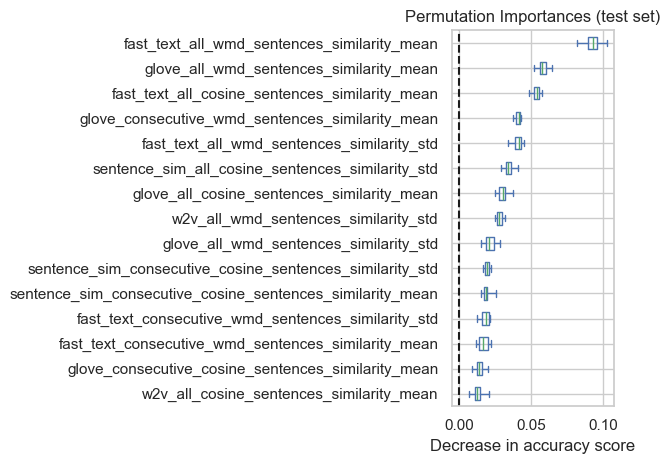

########################################
Training with density_features
Accuracy: 0.36758955107148444
F1 Score: 0.36383761361559747


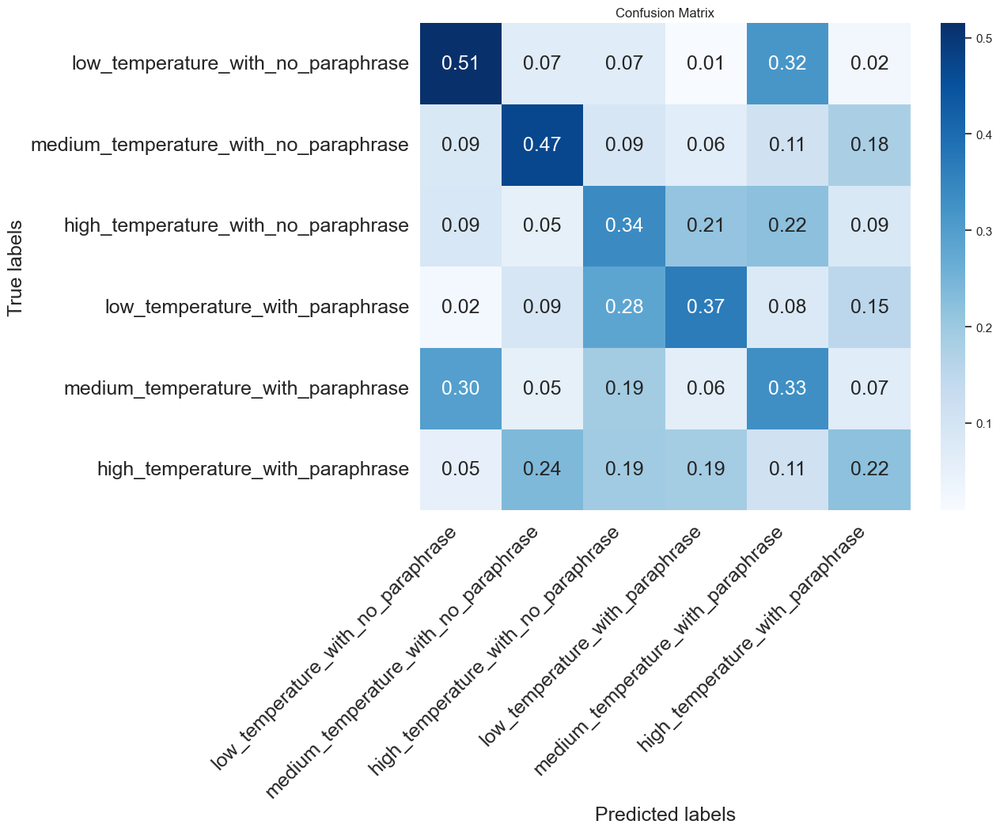

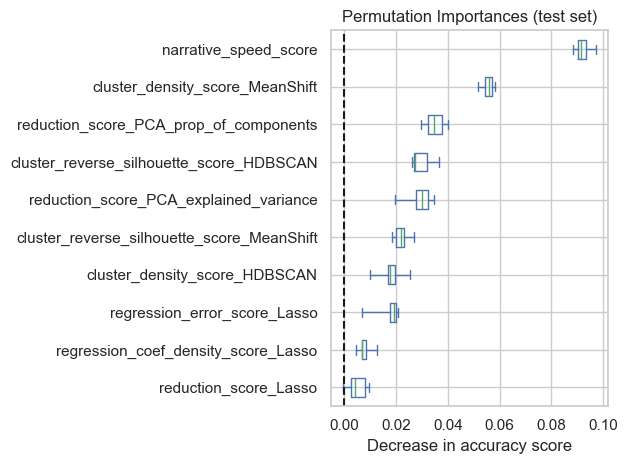

########################################
Training with mean_sim_metrics
Accuracy: 0.3663381823869858
F1 Score: 0.36313269987163505


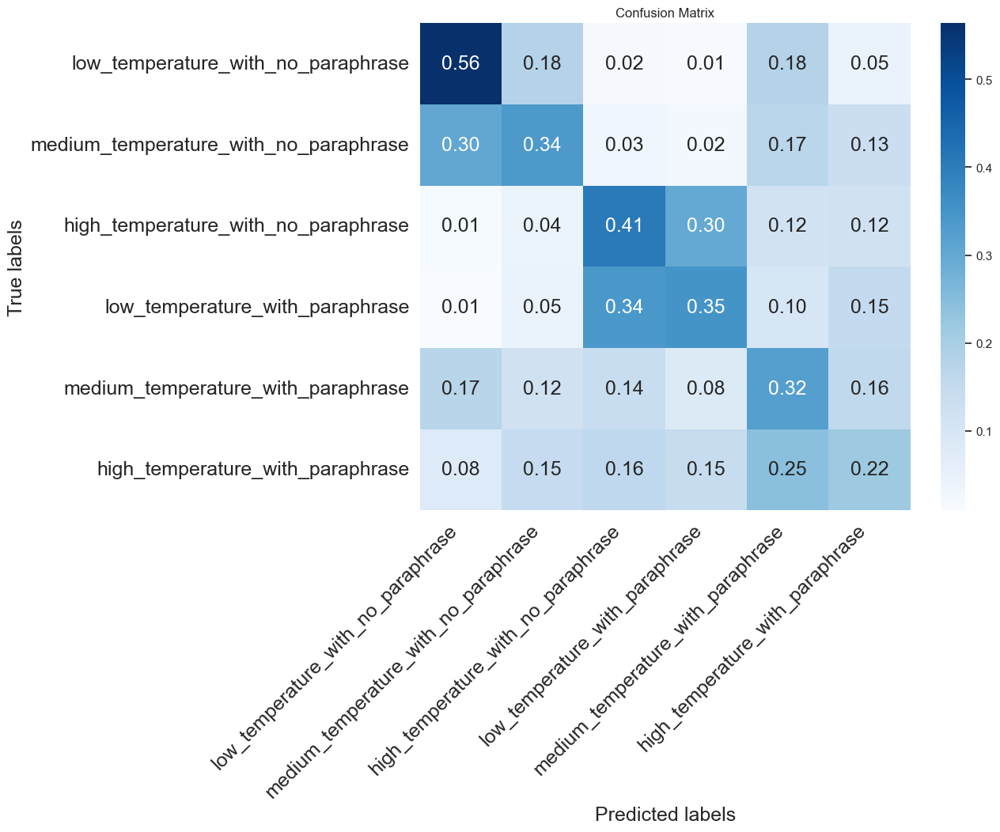

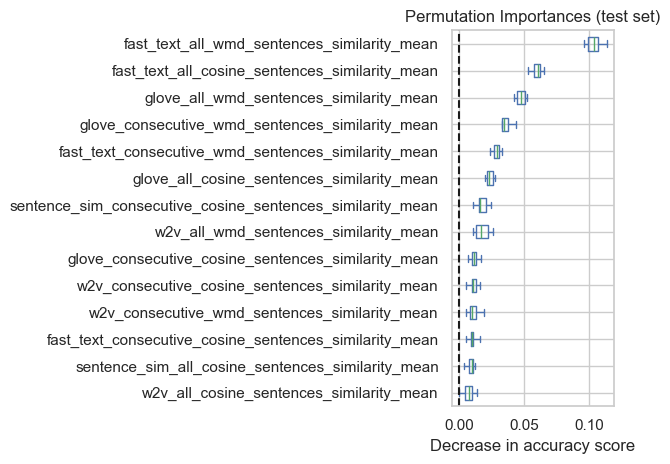

########################################
Training with std_sim_metrics
Accuracy: 0.3552322853120601
F1 Score: 0.3540846596937126


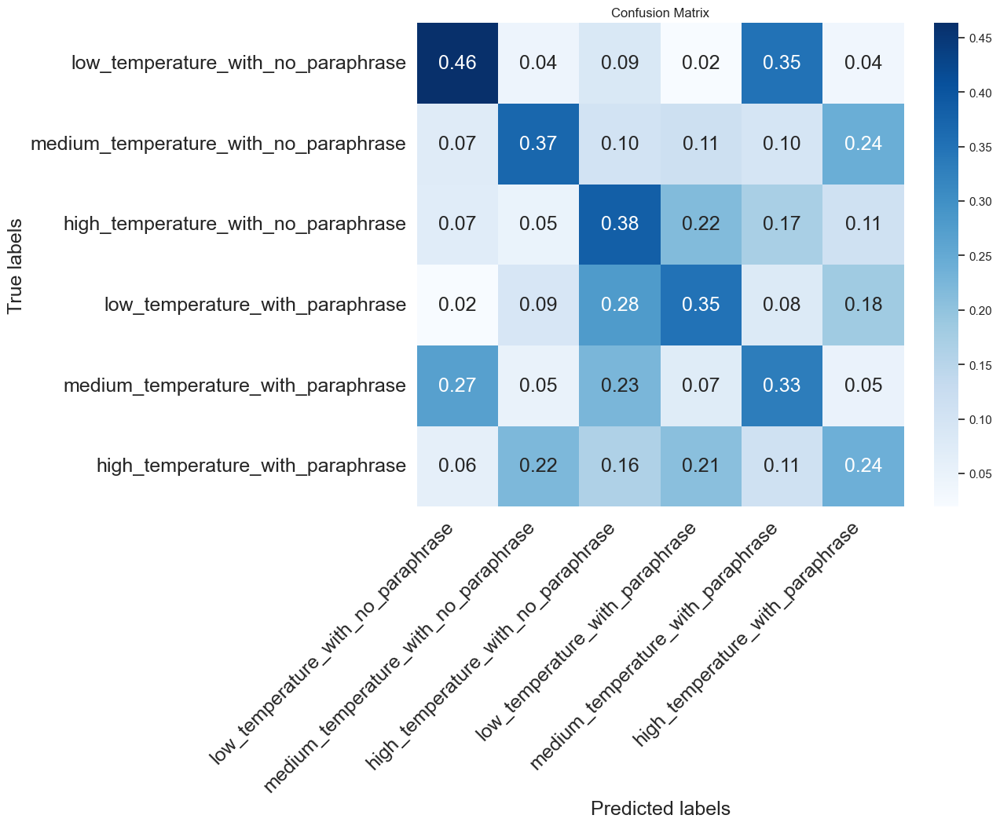

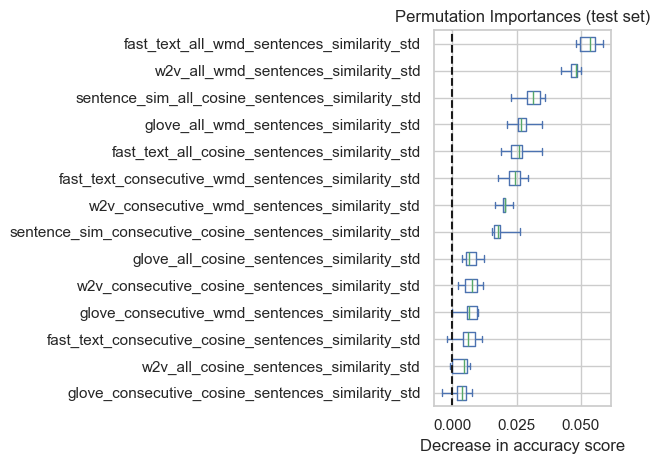

########################################
Training with all_features
Accuracy: 0.5066478961363992
F1 Score: 0.5045068235914624


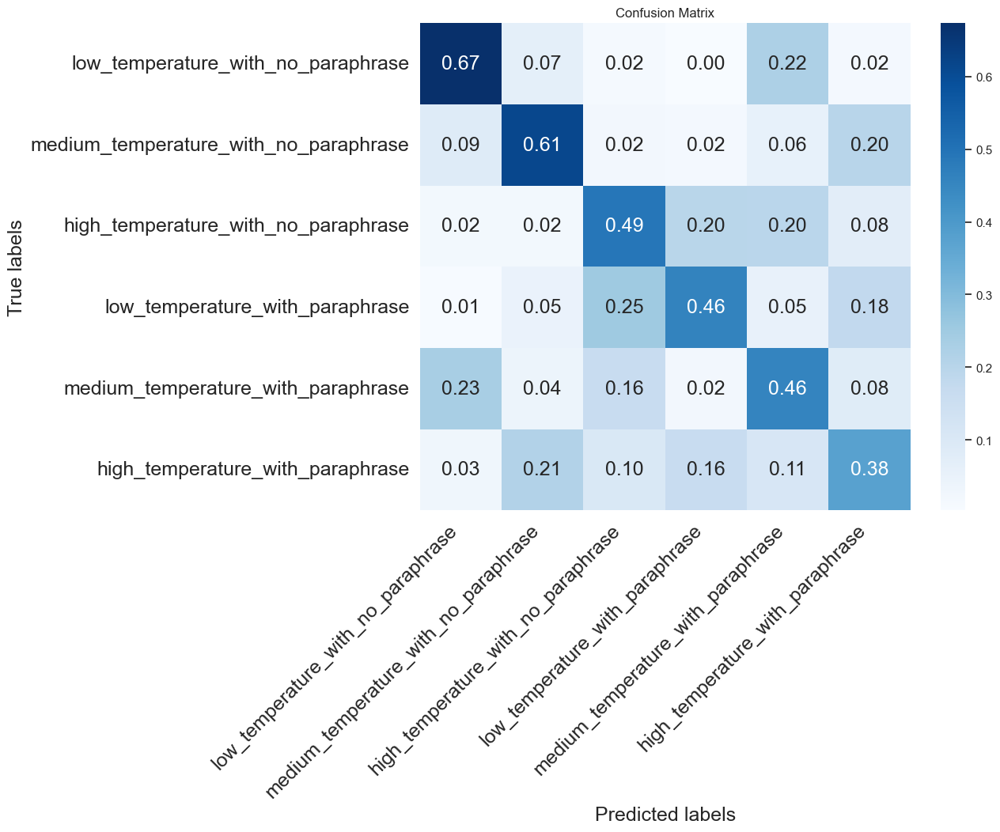

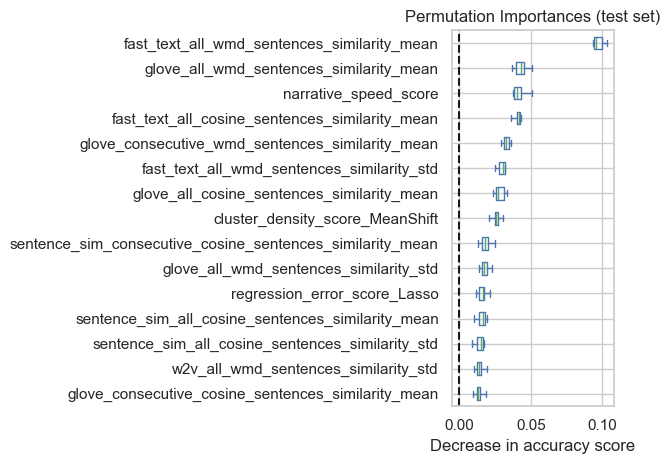

########################################
Training with best_features
Accuracy: 0.4110746128578132
F1 Score: 0.4079436366463237


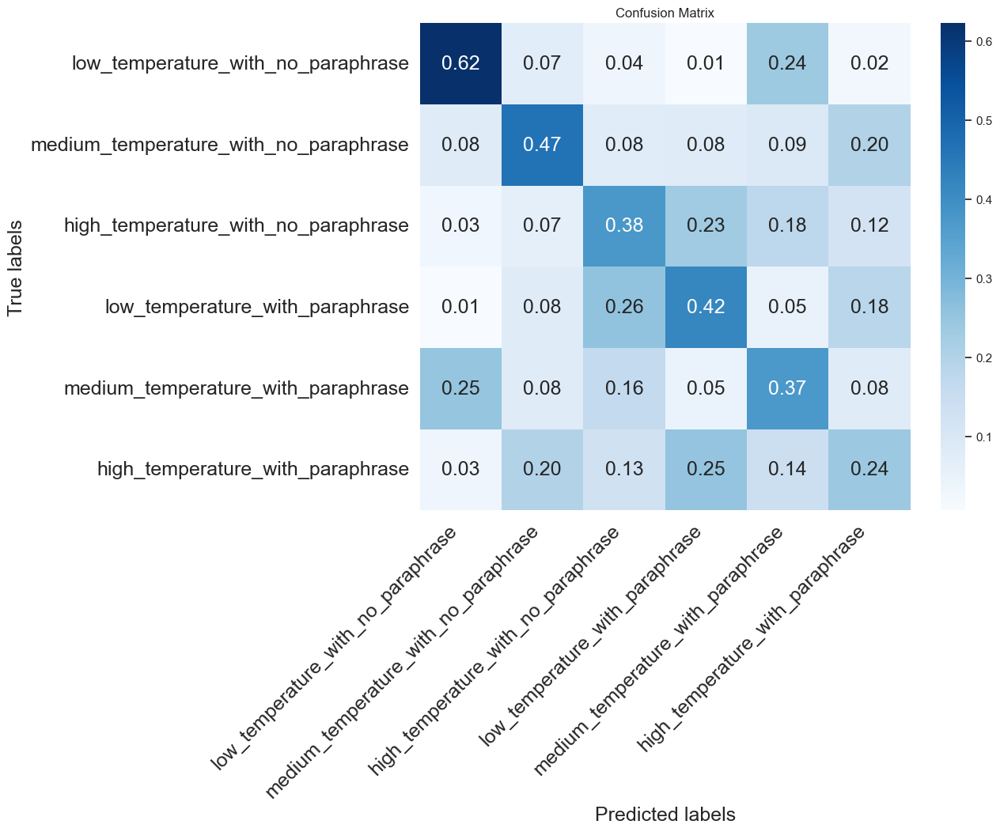

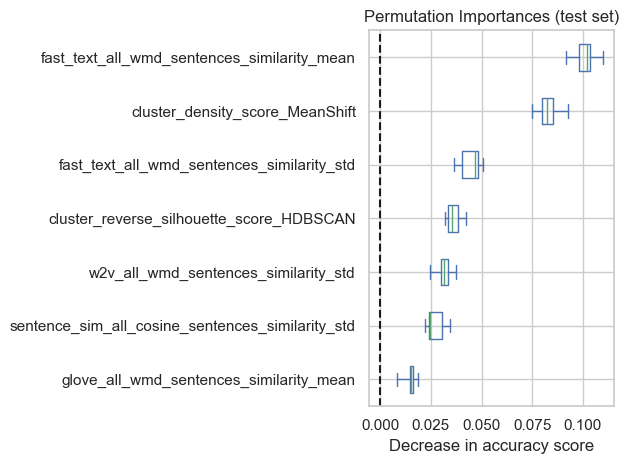

In [37]:
train_and_evaluate_xgb(features_dict,  data)

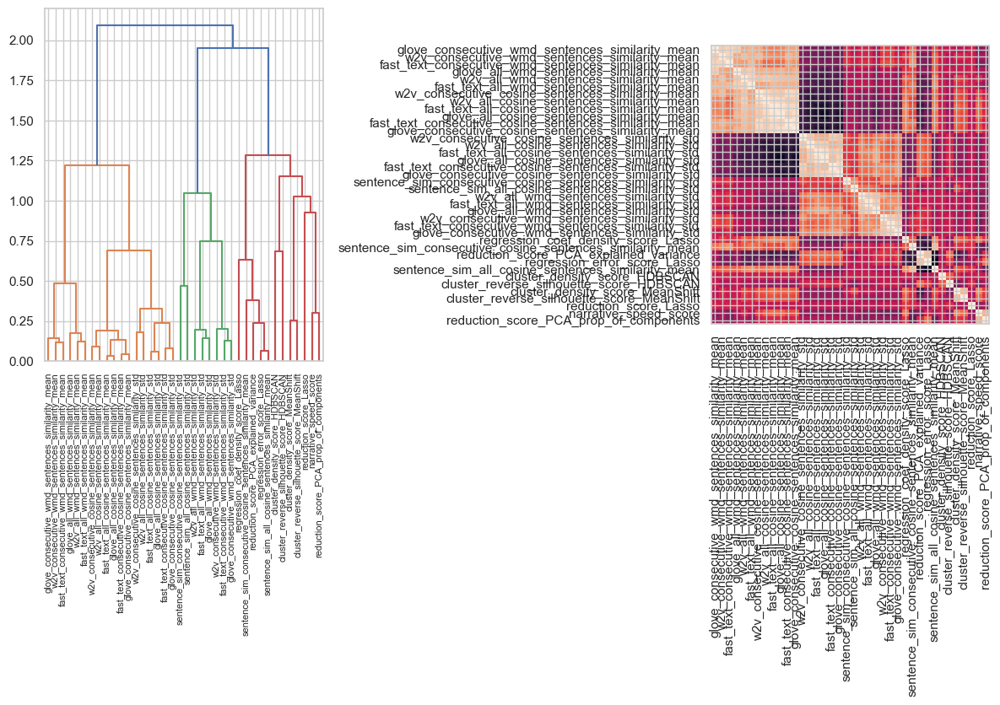

In [46]:
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform
from scipy.stats import spearmanr

X = data[all_features]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8))
corr = spearmanr(X).correlation

# Ensure the correlation matrix is symmetric
corr = (corr + corr.T) / 2
np.fill_diagonal(corr, 1)

# We convert the correlation matrix to a distance matrix before performing
# hierarchical clustering using Ward's linkage.
distance_matrix = 1 - np.abs(corr)
dist_linkage = hierarchy.ward(squareform(distance_matrix))
dendro = hierarchy.dendrogram(
    dist_linkage, labels=X.columns.to_list(), ax=ax1, leaf_rotation=90
)
dendro_idx = np.arange(0, len(dendro["ivl"]))

ax2.imshow(corr[dendro["leaves"], :][:, dendro["leaves"]])
ax2.set_xticks(dendro_idx)
ax2.set_yticks(dendro_idx)
ax2.set_xticklabels(dendro["ivl"], rotation="vertical")
ax2.set_yticklabels(dendro["ivl"])
_ = fig.tight_layout()

In [49]:
from collections import defaultdict

cluster_ids = hierarchy.fcluster(dist_linkage, 0.5, criterion="distance")
cluster_id_to_feature_ids = defaultdict(list)
for idx, cluster_id in enumerate(cluster_ids):
    cluster_id_to_feature_ids[cluster_id].append(idx)
selected_features = [v[0] for v in cluster_id_to_feature_ids.values()]
selected_features_names = X.columns[selected_features]

"""X_train_sel = X_train[selected_features_names]
X_test_sel = X_test[selected_features_names]

clf_sel = RandomForestClassifier(n_estimators=100, random_state=42)
clf_sel.fit(X_train_sel, y_train)
print(
    "Baseline accuracy on test data with features removed:"
    f" {clf_sel.score(X_test_sel, y_test):.2}"
"""

print(selected_features_names)


Index(['narrative_speed_score', 'reduction_score_PCA_explained_variance',
       'cluster_density_score_HDBSCAN',
       'cluster_reverse_silhouette_score_HDBSCAN',
       'cluster_density_score_MeanShift',
       'regression_coef_density_score_Lasso', 'reduction_score_Lasso',
       'w2v_consecutive_cosine_sentences_similarity_mean',
       'w2v_all_wmd_sentences_similarity_mean',
       'w2v_consecutive_cosine_sentences_similarity_std',
       'w2v_all_wmd_sentences_similarity_std',
       'w2v_consecutive_wmd_sentences_similarity_std',
       'sentence_sim_consecutive_cosine_sentences_similarity_std'],
      dtype='object')


########################################
Accuracy: 0.3669638667292351
F1 Score: 0.3639475918453597


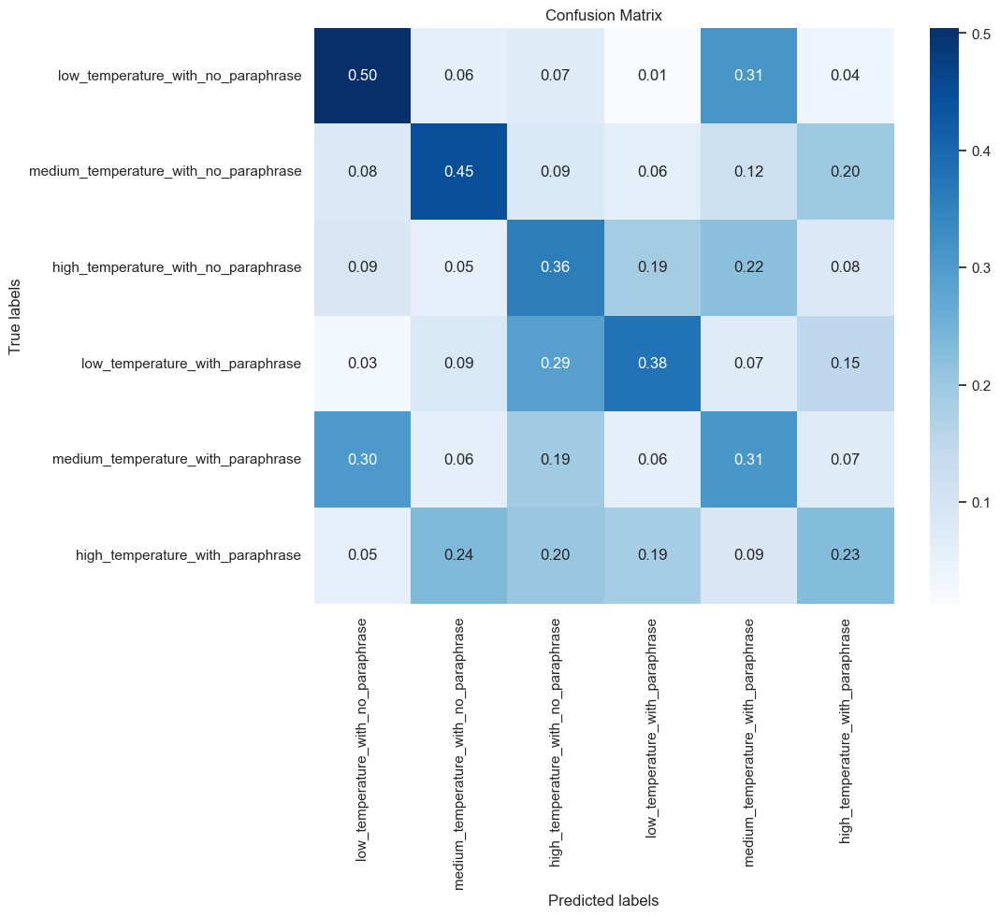

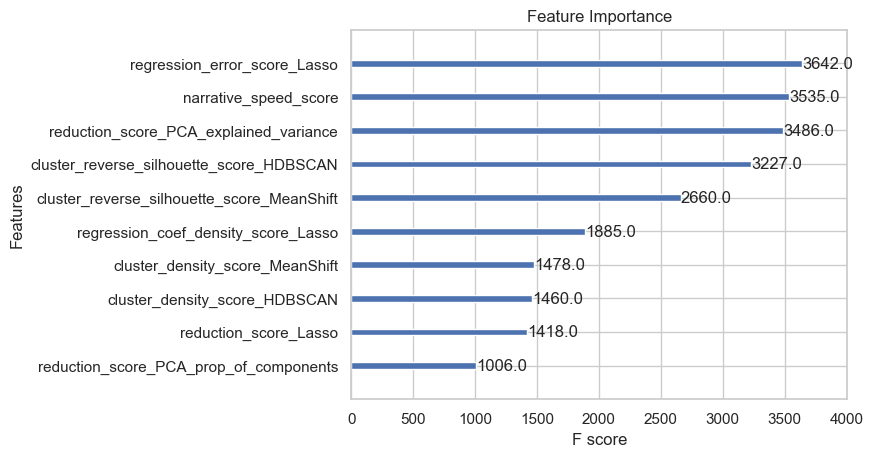

########################################
Accuracy: 0.47833567964961676
F1 Score: 0.4767025671600078


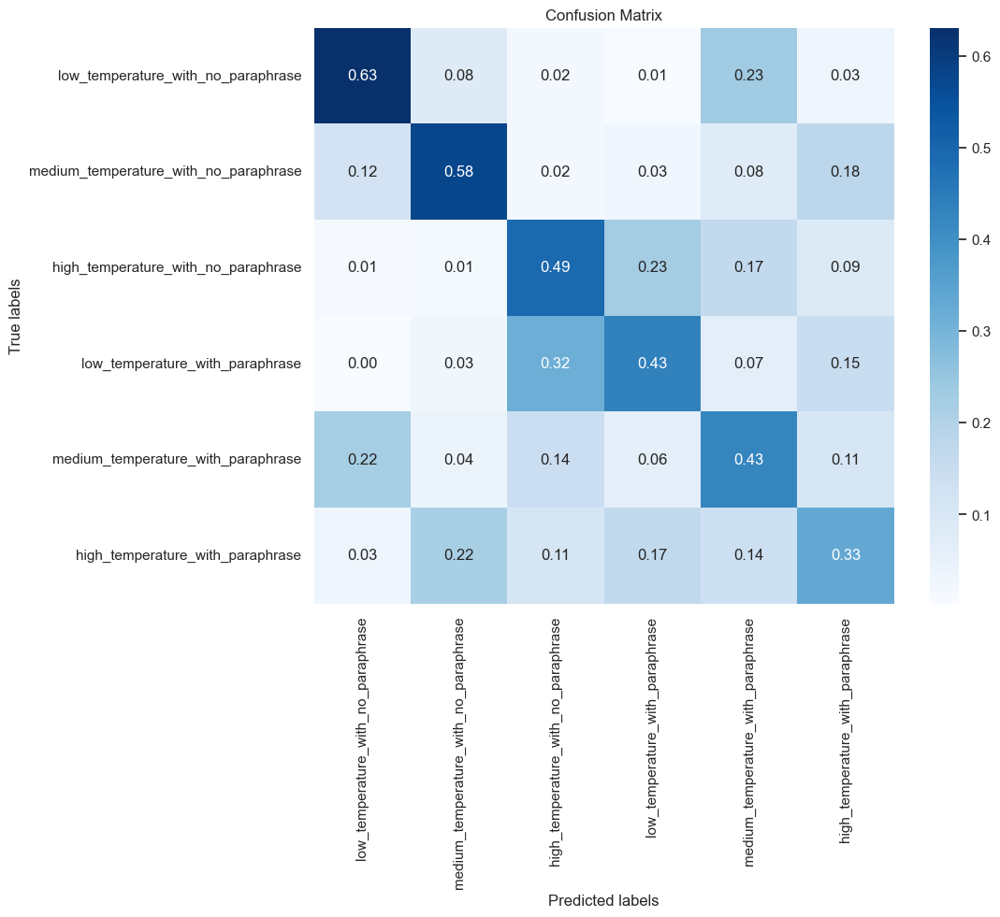

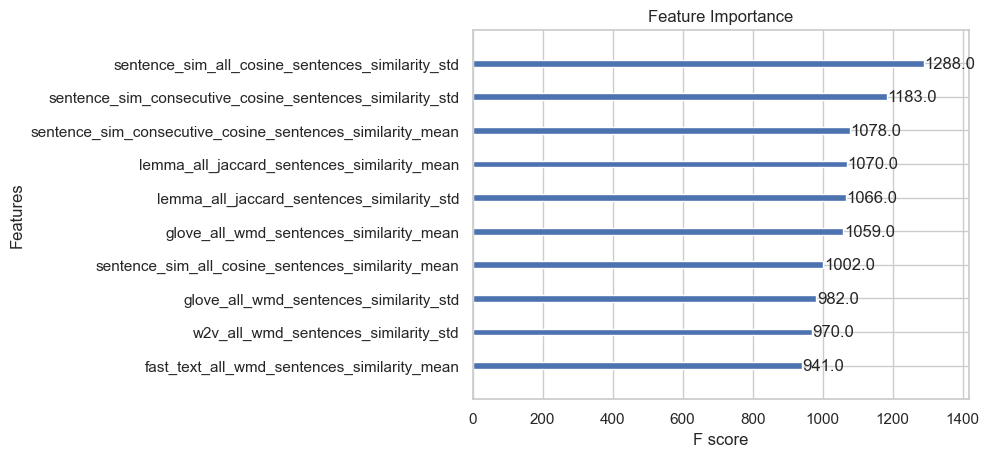

########################################
Accuracy: 0.3635226028468638
F1 Score: 0.36081031256199264


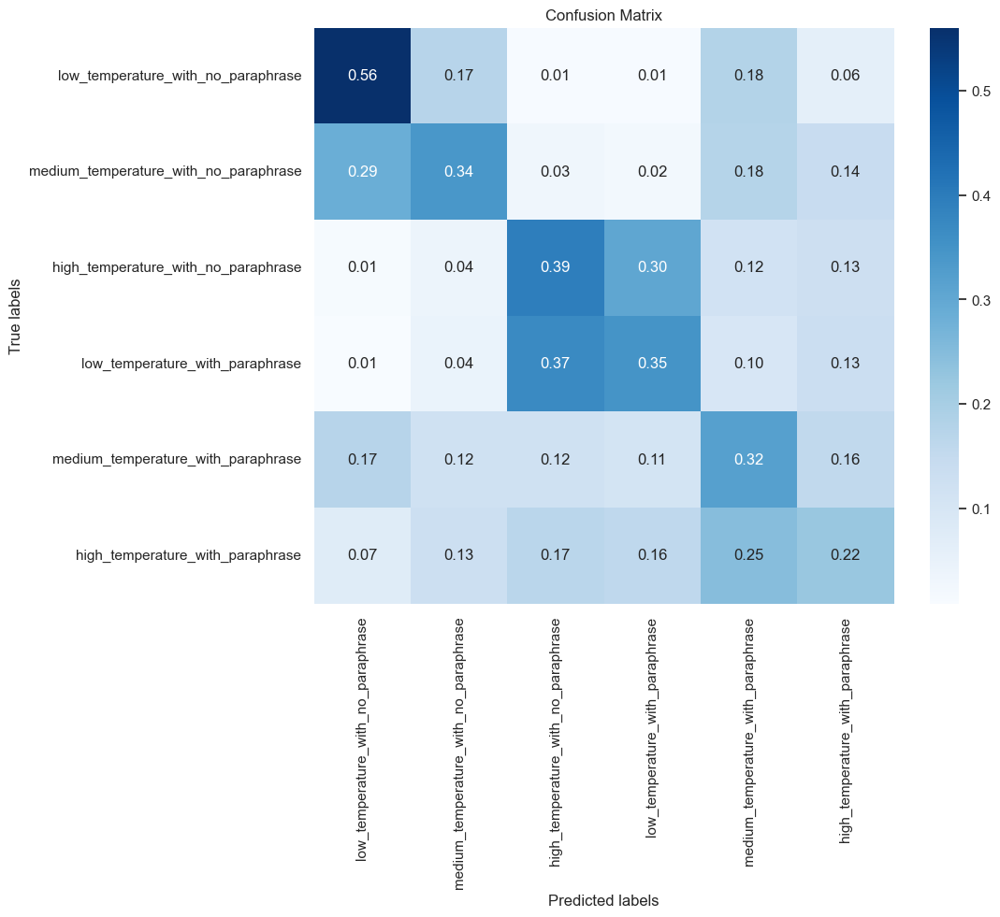

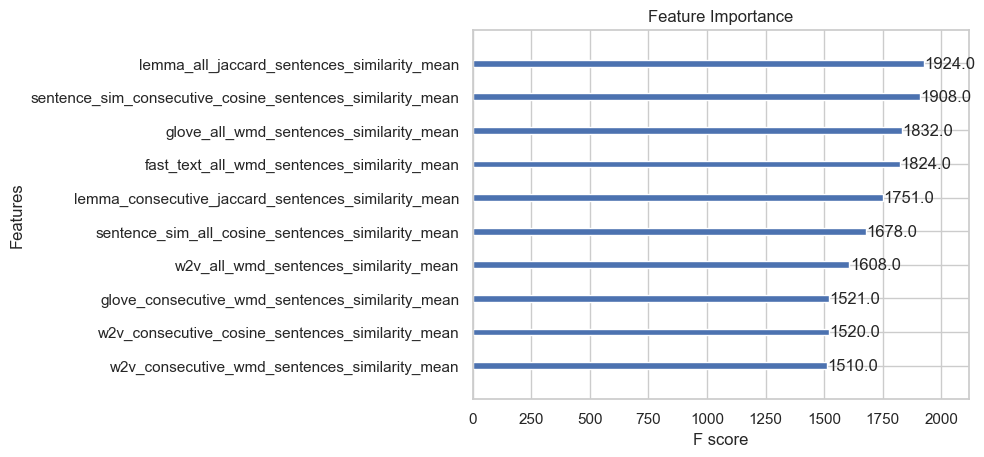

########################################
Accuracy: 0.37040513061160646
F1 Score: 0.36951324154565857


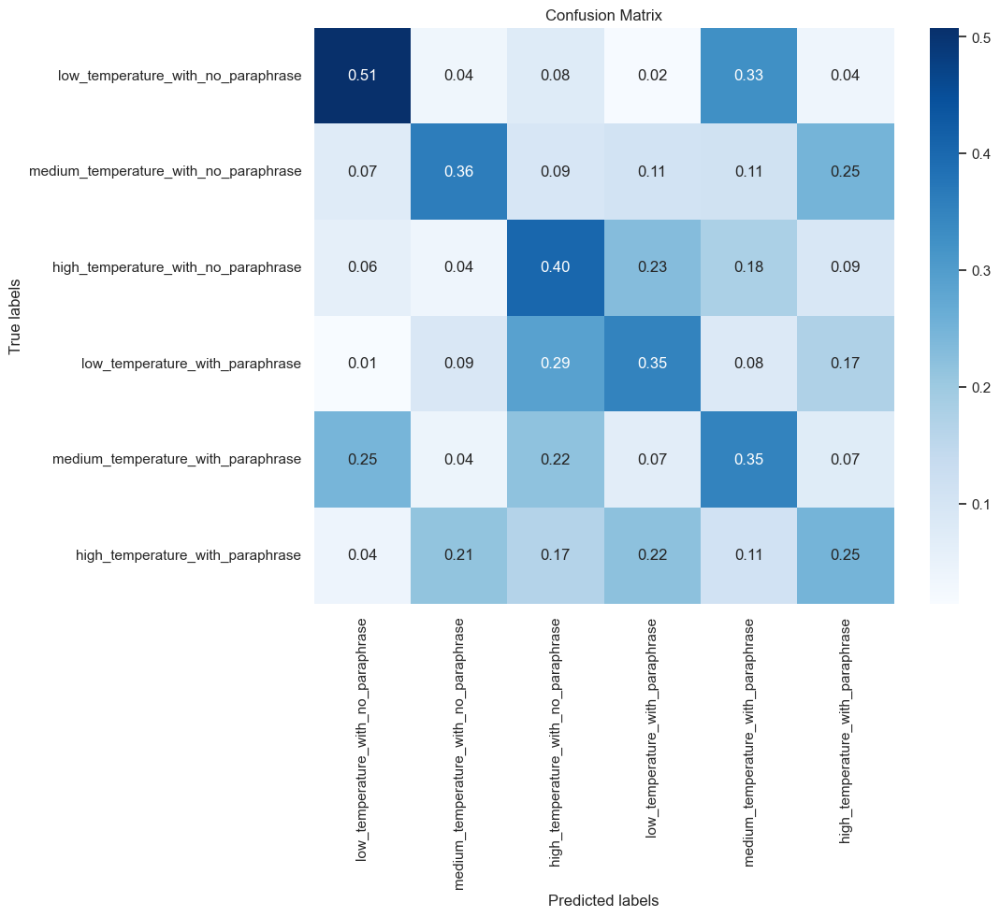

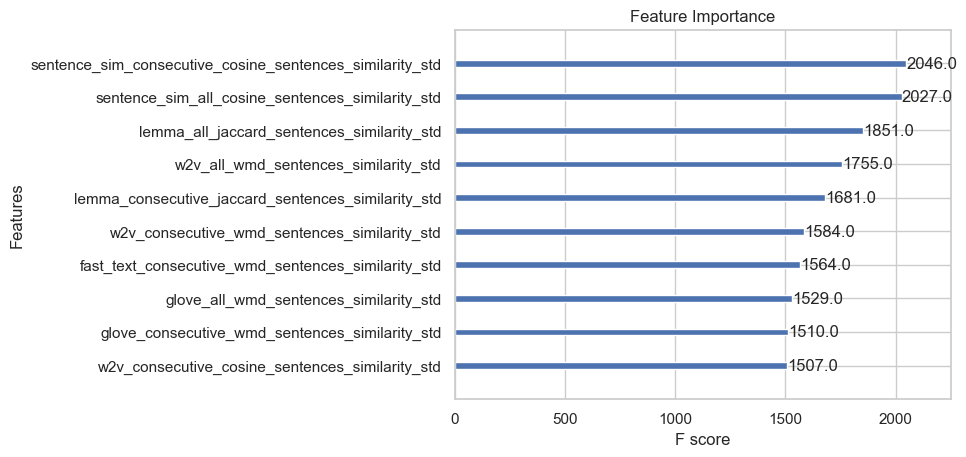

########################################
Accuracy: 0.5058657907085875
F1 Score: 0.5043741344540498


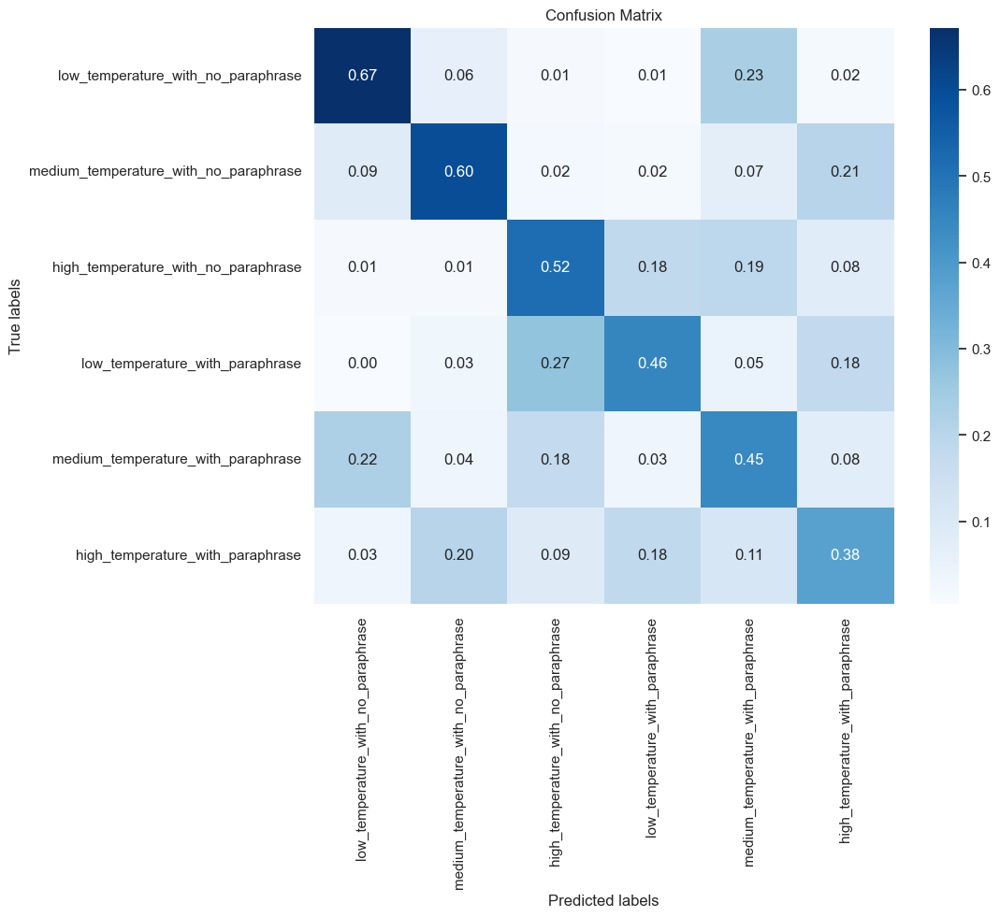

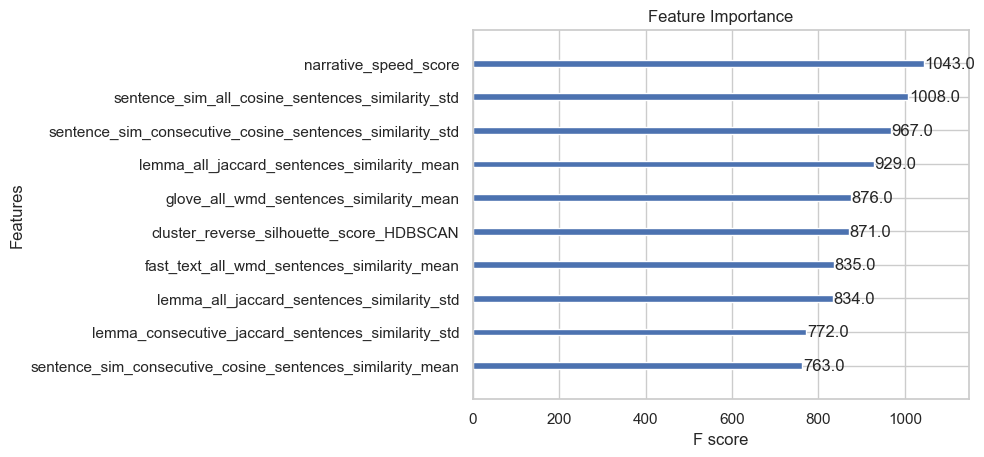

In [75]:
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion Matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    sns.set(style="whitegrid", color_codes=True)
    plt.figure(figsize=(10, 8))

    if normalize:
        # Normalize the confusion matrix.
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        fmt = ".2f"  # Format the annotations to 2 decimal places
    else:
        fmt = "d"  # Use integer formatting for annotations

    sns.heatmap(cm, annot=True, fmt=fmt, cmap=cmap, cbar=True, xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(title)
    plt.show()

def plot_importances(result):
    sorted_importances_idx = result.importances_mean.argsort()
    importances = pd.DataFrame(
        result.importances[sorted_importances_idx].T,
        columns=X.columns[sorted_importances_idx],
    )
    ax = importances.plot.box(vert=False, whis=10)
    ax.set_title("Permutation Importances (test set)")
    ax.axvline(x=0, color="k", linestyle="--")
    ax.set_xlabel("Decrease in accuracy score")
    ax.figure.tight_layout()

for features_name in features_dict.keys():
    features = features_dict[features_name] + ['random']
    parameters = best_parameters_dict[features_name]
    print("##"*20)
    clf = RandomForestClassifier(**parameters)
    print(f"Training with {features_name}")
    X = data[features]
    y = data["cat_label"]

    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    train_index, test_index = next(gss.split(data, groups=data['prompt_cat']))
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print("Accuracy:", clf.score(X_test, y_test))
    print("F1 Score:", f1_score(y_test, y_pred, average='weighted'))

    cm = confusion_matrix(y_test, y_pred)
    plot_confusion_matrix(cm, classes = data["combined_label"].unique(), normalize=True)

    result = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=42, n_jobs=2)
    plot_importances(result)

Accuracy: 0.46180371352785143
Classification Report for Output 1:
              precision    recall  f1-score   support

           0       0.66      0.76      0.70      1261
           1       0.51      0.44      0.48      1381
           2       0.66      0.65      0.65      1128

    accuracy                           0.61      3770
   macro avg       0.61      0.62      0.61      3770
weighted avg       0.60      0.61      0.61      3770


--------------------------------------------------------------------------------

Classification Report for Output 2:
              precision    recall  f1-score   support

           0       0.75      0.82      0.78      2010
           1       0.76      0.68      0.72      1760

    accuracy                           0.75      3770
   macro avg       0.76      0.75      0.75      3770
weighted avg       0.75      0.75      0.75      3770


--------------------------------------------------------------------------------



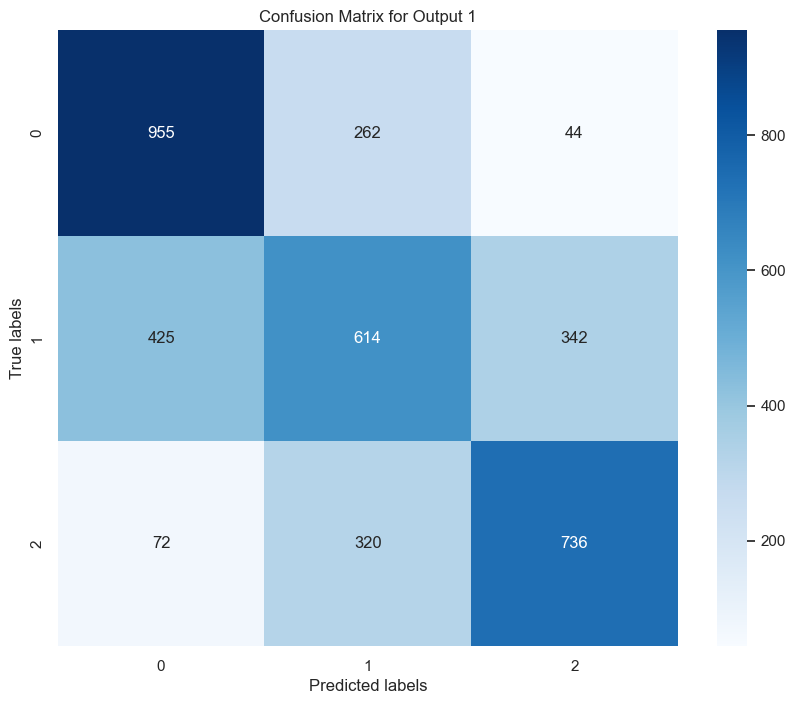

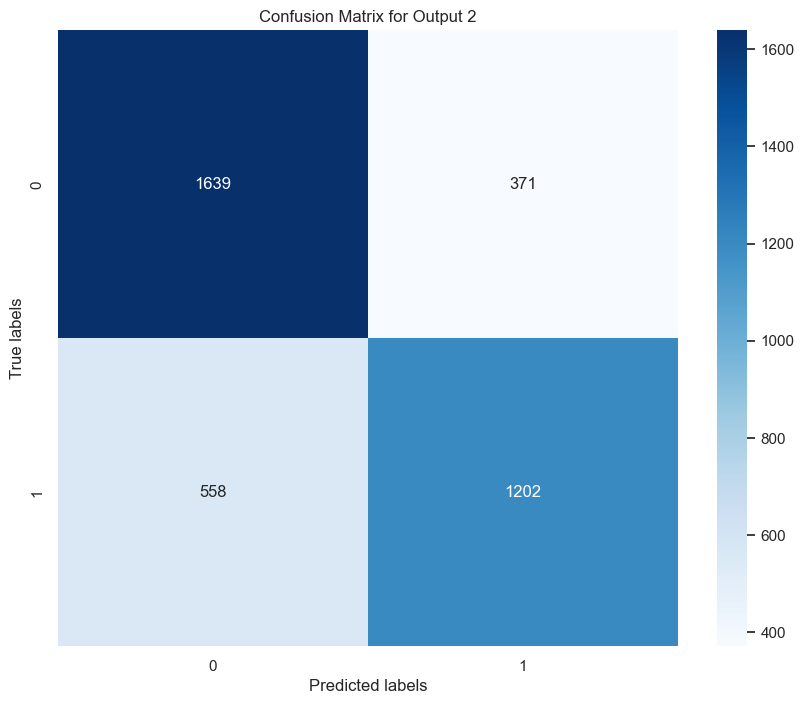

In [25]:
from sklearn.metrics import confusion_matrix, classification_report
base_clf = LogisticRegression()
clf = base_clf
X = data[all_features]
y = data["one_hot_label"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print("Accuracy:", clf.score(X_test, y_test))
n_outputs = 2 # Number of outputs
target_names = [ [0,1,2], [0, 1]]  # Example target names for each output

for i in range(n_outputs):
    print(f"Classification Report for Output {i+1}:")
    print(classification_report(y_test.values[:, i], y_pred[:, i]))
    print("\n" + "-"*80 + "\n")

def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=plt.cm.Blues):
    sns.set(style="whitegrid", color_codes=True)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="", cmap=cmap, cbar=True, xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(title)
    plt.show()

# Example of how you might structure the function to handle multioutput
def plot_multiclass_multioutput_confusion_matrices(y_true, y_pred, labels):
    """
    y_true: array-like of shape (n_samples, n_outputs)
    y_pred: array-like of shape (n_samples, n_outputs)
    labels: list of lists containing class labels for each output
    """
    n_outputs = y_true.shape[1]
    for i in range(n_outputs):
        cm = confusion_matrix(y_true[:, i], y_pred[:, i], labels=labels[i])
        plot_confusion_matrix(cm, classes=labels[i], title=f'Confusion Matrix for Output {i+1}')

plot_multiclass_multioutput_confusion_matrices(y_test.values, y_pred, labels=[[0, 1, 2], [0, 1]])

In [6]:
def build_pipeline(model_name):
    if model_name == "LR":
        base_clf = LogisticRegression()
    elif model_name == "random_forest":
        base_clf = RandomForestClassifier()
    elif model_name == "xgb":
        base_clf = XGBClassifier()
    elif model_name == "svm" or model_name == "kernel_svm":
        kernel_type = 'linear' if model_name == "kernel_svm" else 'rbf'
        base_clf = SVC(kernel=kernel_type, probability=True)

    # Wrapping with MultiOutputClassifier
    clf = MultiOutputClassifier(base_clf)

    # Define k-cross validation
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)

    # Define function to extract feature importance using SHAP, if applicable
    def extract_shap(X, model):
        try:
            explainer = shap.Explainer(model)
            shap_values = explainer(X)
            shap.summary_plot(shap_values, X)
        except Exception as e:
            print(e)
            shap_values = None
        return shap_values

    # Define the pipeline
    def pipeline(X, y, extract_shap_val=False):
        # Train the model using k-cross validation
        auc_scores = cross_val_score(clf, X, y, cv=kfold, scoring="accuracy")  # Changed to accuracy
        print(f"Accuracy scores: {auc_scores}")
        print(f"Mean Accuracy: {np.mean(auc_scores)}")

        # Fit the model on the whole dataset
        clf.fit(X, y)

        # Extract and show feature importance, if applicable
        shap_values = extract_shap(X, clf.estimators_[0]) if extract_shap_val else None
        return clf, np.mean(auc_scores), shap_values

    return pipeline

def compare_models(models, X, y, extract_shap_val=False):
    results = {}
    for model_name in models:
        pipeline = build_pipeline(model_name)
        clf, perf, shap_values = pipeline(X, y, extract_shap_val=extract_shap_val)
        results[model_name] = perf
    results_df = pd.DataFrame(results, index=["Mean Accuracy"])
    return results_df

models = ["LR", "random_forest"]
X = data[mean_sim_metrics]
y = data[target]
compare_models(models, X, y)

Accuracy scores: [nan nan nan nan nan]
Mean Accuracy: nan
Accuracy scores: [nan nan nan nan nan]
Mean Accuracy: nan


KeyboardInterrupt: 